In [79]:
## MISSION(SLACK) : EMD with default settings(not HPC settings) then sum the components which are faster than 15HZ , and at last do the spectral analysis for these components!!!!
##NOTE THAT <<THE LAST CELL WILL DO ANYTHING THAT WE WANT("doing emd(stantard EMD)" with default settings , then summing all the mean freqs >15hz) and after that doing spectral analysis(PSD)>>

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import copy
import yasa
from mne.filter import resample
import pynapple as nap
import seaborn as sns
import pandas as pd
from sklearn.preprocessing import normalize
import requests
from io import BytesIO
import sails
import re
from scipy.stats import entropy

import scipy
from scipy import signal
from scipy.interpolate import griddata
from scipy.signal import correlate
from scipy.stats import pearsonr
from scipy.fft import fft
from scipy.spatial.distance import euclidean
from scipy.signal import spectrogram
from scipy.io import loadmat
import scipy.fft
import scipy.stats
import scipy.io as sio
from scipy.signal import hilbert

import emd as emd
import emd.sift as sift
import emd.spectra as spectra

from neurodsp.sim import sim_combined
from neurodsp.plts import plot_time_series, plot_timefrequency
from neurodsp.utils import create_times
from neurodsp.timefrequency.wavelets import compute_wavelet_transform
from neurodsp.filt import filter_signal

# Load required libraries
import numpy as np
from scipy.io import loadmat
from scipy.signal import hilbert
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
import seaborn as sns
from neurodsp.filt import filter_signal, filter_signal_fir, design_fir_filter
import emd
import pandas as pd
from sklearn.preprocessing import Normalizer
from tqdm import tqdm
import plotly.express as px
import copy
import umap.umap_ as umap
import skdim
from scipy.spatial import cKDTree
import pickle
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as mcolors
import matplotlib.ticker as ticker
from matplotlib.cm import ScalarMappable

## UTILS
from utils import *
from detect_pt import *

from scipy.io import loadmat
import numpy as np
from neurodsp.filt import filter_signal
import copy
import emd
from scipy.spatial import cKDTree
from tqdm import tqdm

sns.set(style='white', context='notebook')

In [4]:
path_to_pfc = "C:/Users/pc/Data_pipeline_project/mani-data-example/mani-data-example/2018-11-05_14-15-28_Post_Trial5/PFC_100_CH45_0.continuous.mat"
path_to_states = "C:/Users/pc/Data_pipeline_project/mani-data-example/mani-data-example/2018-11-05_14-15-28_Post_Trial5/2018-11-05_14-15-28_post_trial5-states.mat"

In [5]:
config = emd.sift.SiftConfig.from_yaml_file(
    r"C:\Users\pc\Data_pipeline_project\mani-data-example\mani-data-example\emd_masksift_CA1_config_2500.yml"
)

In [6]:
lfpPFC, hypno, fs = get_data(path_to_pfc, path_to_states)

Key 'HPC' not found. Available keys: ['PFC']
Using key 'PFC' instead
There was 0 in the dataset


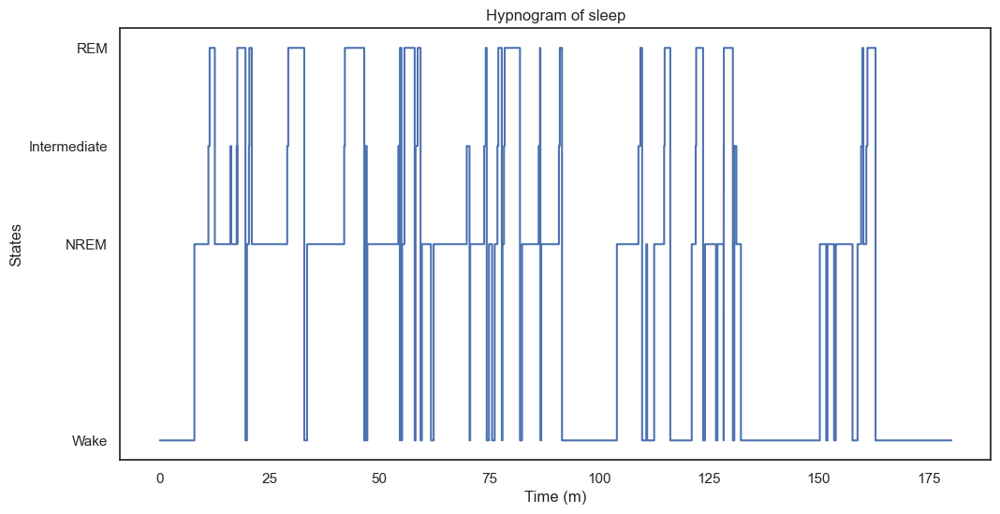

In [7]:
plot_hypnogram(hypno)

In [8]:
np.unique(hypno)

array([1, 3, 4, 5], dtype=uint8)

In [11]:
def extract_pt_intervals(lfpPFC, hypno, fs=2500):
    targetFs = 500
    n_down = fs / targetFs
    start, end = get_start_end(hypno=hypno, sleep_state_id=5)
    rem_interval = nap.IntervalSet(start=start, end=end)
    fs = int(n_down * targetFs)
    t = np.arange(0, len(lfpPFC) / fs, 1 / fs)
    lfp = nap.TsdFrame(t=t, d=lfpPFC, columns=['PFC'])

    # Detect phasic intervals
    lfpPFC_down = preprocess(lfpPFC, n_down)
    phREM = detect_phasic(lfpPFC_down, hypno, targetFs)

    # Create phasic REM IntervalSet
    start, end = [], []
    for rem_idx in phREM:
        for s, e in phREM[rem_idx]:
            start.append(s / targetFs)
            end.append(e / targetFs)
    phasic_interval = nap.IntervalSet(start, end)

    # Calculate tonic intervals
    tonic_interval = rem_interval.set_diff(phasic_interval)
    print(f'Number of detected Tonic intervals: {len(tonic_interval)}')
    # Apply a 100 ms duration threshold to tonic intervals
    min_duration = 0.1  # 100 ms in seconds
    durations = tonic_interval['end'] - tonic_interval['start']
    valid_intervals = durations >= min_duration
    tonic_interval = nap.IntervalSet(tonic_interval['start'][valid_intervals], tonic_interval['end'][valid_intervals])
    print(f'Number of detected Tonic intervals after threshold: {len(tonic_interval)}')
    return phasic_interval, tonic_interval, lfp

In [13]:
phasic_interval, tonic_interval, lfp = extract_pt_intervals(lfpPFC, hypno)

Number of detected Tonic intervals: 29
Number of detected Tonic intervals after threshold: 29


In [14]:
len(phasic_interval)

10

In [15]:
def get_cycle_data(imf_gamma, fs=2500):
    cycle_data = {"fs": None, 'gamma_imf': None,
                  "IP": None, "IF": None, "IA": None, "cycles": None}

    # Get cycles using IP
    IP, IF, IA = emd.spectra.frequency_transform(imf_gamma, fs, 'hilbert')
    C = emd.cycles.Cycles(IP)
    cycles = get_cycles_with_metrics(C, imf_gamma, IA, IF)

    cycle_data['fs'] = fs
    cycle_data['gamma_imf'] = imf_gamma
    cycle_data['IP'] = IP
    cycle_data['IF'] = IF
    cycle_data['IA'] = IA
    cycle_data['cycles'] = cycles
    return cycle_data

In [16]:
def extract_imfs_by_pt_intervals(lfp, fs, interval, config, return_imfs_freqs=False):
    all_imfs = []
    all_imf_freqs = []
    rem_lfp = []
    all_masked_freqs = []
    for ii in range(len(interval)):
        start_idx = int(interval.loc[ii, 'start'] * fs)
        end_idx = int(interval.loc[ii, 'end'] * fs)
        sig_part = lfp[start_idx:end_idx]
        sig = np.array(sig_part)

        rem_lfp.append(sig)

        try:
            imf, mask_freq = sift.mask_sift(sig, **config)
        except Exception as e:
            print(f"EMD Sift failed: {e}. Skipping this interval.")
            continue
        all_imfs.append(imf)
        all_masked_freqs.append(mask_freq)

        imf_frequencies = imf_freq(imf, fs)
        all_imf_freqs.append(imf_frequencies)

    if return_imfs_freqs:
        return all_imfs, all_imf_freqs, rem_lfp
    else:
        return all_imfs


In [17]:
tonic_imfs, tonic_imfs_freqs, tonic_rem_lpf = extract_imfs_by_pt_intervals(lfp, fs, tonic_interval, config, return_imfs_freqs=True)
phasic_imfs, phasic_imfs_freqs, rem_lpf = extract_imfs_by_pt_intervals(lfp, fs, phasic_interval, config, return_imfs_freqs=True)

In [18]:
def find_gamma_imf_component(imf, imf_frequencies, gamma_range=[30, 100]):
    """
    Find the best IMF component representing gamma activity
    """
    best_component = None
    best_score = -1
    
    for comp_idx in range(imf.shape[1]):
        # Calculate mean frequency of this IMF component
        mean_freq = np.mean(imf_frequencies[comp_idx])
        
        # Check if it's in gamma range
        if gamma_range[0] <= mean_freq <= gamma_range[1]:
            # Calculate amplitude stability score
            amplitude = np.mean(np.abs(imf[:, comp_idx]))
            freq_std = np.std(imf_frequencies[comp_idx])
            
            # Higher amplitude and lower frequency variability = better score
            score = amplitude / (freq_std + 1)
            
            if score > best_score:
                best_score = score
                best_component = comp_idx
    
    return best_component

In [19]:
def extract_cycle_info(imfs, imf_frequencies):
    all_FPPs = []
    all_cycles_se = []
    all_cycles_ctrl = []
    
    # Define gamma range - PFC gamma is typically 30-100 Hz :cite[5]:cite[6]
    gamma_range = [30, 100]
    frequencies = np.arange(15, 141, 1)
    angles = np.linspace(-180, 180, 19)
    fs = 2500

    for idx, (imf, freqs) in enumerate(zip(imfs, imf_frequencies)):
        # 1. Identify the gamma IMF component more robustly
        gamma_component = None
        best_score = -1
        for comp in range(imf.shape[1]):
            mean_freq = np.mean(freqs[comp])
            # Check if within gamma range
            if gamma_range[0] <= mean_freq <= gamma_range[1]:
                # Calculate a score based on amplitude and stability
                amplitude = np.mean(np.abs(imf[:, comp]))
                freq_std = np.std(freqs[comp])
                # Higher amplitude and lower frequency variability are better
                score = amplitude / (freq_std + 1e-6)  # Avoid division by zero
                if score > best_score:
                    best_score = score
                    gamma_component = comp
        
        if gamma_component is None:
            print(f"Interval {idx+1}: No suitable gamma component found. Skipping.")
            continue
        
        gamma_signal = imf[:, gamma_component]
        mean_freq = np.mean(freqs[gamma_component])
        print(f"Interval {idx+1}: Using IMF-{gamma_component+1} for gamma ({mean_freq:.1f} Hz)")
        
        # 2. Get cycle data using EMD's built-in cycle detection
        try:
            cycle_data = get_cycle_data(gamma_signal, fs=fs)
        except Exception as e:
            print(f"Interval {idx+1}: Error in get_cycle_data: {e}. Skipping.")
            continue
        
        # 3. Apply conditions tailored for gamma cycles
        # Gamma cycles are shorter than theta cycles - adjust duration constraints
        amp_thresh = np.percentile(cycle_data['IA'], 25)  # Lower threshold might be needed
        # Duration constraints: gamma cycles are faster than theta
        hi_freq_duration = fs / gamma_range[0]  # Upper duration limit for slowest gamma (30 Hz)
        lo_freq_duration = fs / gamma_range[1]  # Lower duration limit for fastest gamma (100 Hz)
        
        conditions = [
            'is_good==1',
            f'duration_samples<{hi_freq_duration}',  # Shorter than period of 30Hz
            f'duration_samples>{lo_freq_duration}',   # Longer than period of 100Hz
            f'max_amp>{amp_thresh}'
        ]
        
        all_cycles = get_cycles_with_conditions(cycle_data['cycles'], conditions)
        
        # Check if all_cycles is None or empty
        if all_cycles is None:
            print(f"Interval {idx+1}: No cycles found. Trying without duration constraints...")
            # Fallback: try without duration constraints
            conditions_fallback = [
                'is_good==1',
                f'max_amp>{amp_thresh}'
            ]
            all_cycles = get_cycles_with_conditions(cycle_data['cycles'], conditions_fallback)
            if all_cycles is None:
                print(f"Interval {idx+1}: Still no cycles found. Skipping.")
                continue
        
        # Get the subset of cycles that meet the conditions
        try:
            subset_cycles_df = all_cycles.get_metric_dataframe(subset=True)
        except AttributeError as e:
            print(f"Interval {idx+1}: Error getting metric dataframe: {e}. Skipping.")
            continue
        
        if subset_cycles_df is None or len(subset_cycles_df) == 0:
            print(f"Interval {idx+1}: No valid gamma cycles found after filtering. Skipping.")
            continue
        
        subset_indices = subset_cycles_df['index'].values
        
        # 4. Get control points - handle potential singleton dimensions
        try:
            ctrl = emd.cycles.get_control_points(gamma_signal, cycle_data['cycles'], mode='augmented')
            cycle_ctrls = get_cycle_ctrl(ctrl, subset_indices)
        except Exception as e:
            print(f"Interval {idx+1}: Error getting control points: {e}. Skipping.")
            continue
        
        all_cycles_ctrl.append(cycle_ctrls)
        
        # 5. Get cycle indices
        try:
            all_cycles_inds = get_cycle_inds(all_cycles, subset_indices)
            cycles_inds = arrange_cycle_inds(all_cycles_inds)
        except Exception as e:
            print(f"Interval {idx+1}: Error getting cycle indices: {e}. Skipping.")
            continue
        
        all_cycles_se.append(all_cycles_inds)
        
        # 6. Extract supra-gamma activity and compute FPP
        try:
            # Use the same tg_split function but for gamma range
            sub_gamma, gamma_bands, supra_gamma = tg_split(freqs, gamma_range)
            supra_gamma_sig = np.sum(imf.T[supra_gamma], axis=0)
            
            # Compute wavelet transform - use fewer ncycles for gamma
            raw_data = sails.wavelet.morlet(supra_gamma_sig, freqs=frequencies, 
                                          sample_rate=fs, ncycles=3,  # Fewer cycles for gamma
                                          ret_mode='power', normalise=None)
            supraPlot = scipy.stats.zscore(raw_data, axis=1)
            
            # Compute FPP
            FPP = bin_tf_to_fpp(cycles_inds, supraPlot, bin_count=19)
            all_FPPs.append(FPP)
            
        except Exception as e:
            print(f"Interval {idx+1}: Error in FPP computation: {e}")
            continue

    return all_cycles_ctrl, all_cycles_se, all_FPPs

In [26]:
#------------------------------

In [27]:
# Cell 1: Modified EMD function with default settings
def extract_imfs_default(lfp, fs, interval, return_imfs_freqs=False):
    all_imfs = []
    all_imf_freqs = []
    rem_lfp = []
    
    for ii in range(len(interval)):
        start_idx = int(interval.loc[ii, 'start'] * fs)
        end_idx = int(interval.loc[ii, 'end'] * fs)
        sig_part = lfp[start_idx:end_idx]
        sig = np.array(sig_part)

        rem_lfp.append(sig)

        try:
            # Use default EMD settings instead of config
            imf = emd.sift.sift(sig)  # Default EMD
        except Exception as e:
            print(f"EMD failed: {e}. Skipping this interval.")
            continue
            
        all_imfs.append(imf)
        
        # Calculate IMF frequencies
        imf_frequencies = imf_freq(imf, fs)
        all_imf_freqs.append(imf_frequencies)

    if return_imfs_freqs:
        return all_imfs, all_imf_freqs, rem_lfp
    else:
        return all_imfs

In [28]:
# Cell 2: Extract IMFs using default EMD settings
tonic_imfs_default, tonic_imfs_freqs_default, tonic_rem_lpf_default = extract_imfs_default(
    lfp, fs, tonic_interval, return_imfs_freqs=True)
phasic_imfs_default, phasic_imfs_freqs_default, phasic_rem_lpf_default = extract_imfs_default(
    lfp, fs, phasic_interval, return_imfs_freqs=True)

print(f"Phasic intervals processed: {len(phasic_imfs_default)}")
print(f"Tonic intervals processed: {len(tonic_imfs_default)}")

Phasic intervals processed: 10
Tonic intervals processed: 29


In [29]:
# Cell 3: Function to sum components faster than 15Hz
def sum_fast_components(imf, imf_frequencies, threshold_freq=15):
    """
    Sum IMF components that have mean frequency faster than threshold_freq
    """
    fast_components_sum = np.zeros_like(imf[:, 0])
    
    for comp_idx in range(imf.shape[1]):
        mean_freq = np.mean(imf_frequencies[comp_idx])
        if mean_freq > threshold_freq:
            fast_components_sum += imf[:, comp_idx]
    
    return fast_components_sum

In [30]:
# Cell 4: Function for spectral analysis
def perform_spectral_analysis(signal, fs, condition_name):
    """
    Perform comprehensive spectral analysis on the signal
    """
    print(f"\n{'='*60}")
    print(f"SPECTRAL ANALYSIS: {condition_name}")
    print(f"{'='*60}")
    
    # 1. Power Spectral Density
    freqs, psd = scipy.signal.welch(signal, fs, nperseg=fs*2)
    
    # 2. Spectrogram
    f, t, Sxx = scipy.signal.spectrogram(signal, fs, nperseg=fs//2)
    
    # 3. Statistical properties
    mean_power = np.mean(psd)
    max_freq = freqs[np.argmax(psd)]
    total_power = np.sum(psd)
    
    # Gamma band analysis (30-100 Hz)
    gamma_mask = (freqs >= 30) & (freqs <= 100)
    gamma_power = np.sum(psd[gamma_mask])
    gamma_ratio = gamma_power / total_power
    
    print(f"Peak frequency: {max_freq:.2f} Hz")
    print(f"Total power: {total_power:.4f}")
    print(f"Gamma power (30-100 Hz): {gamma_power:.4f}")
    print(f"Gamma/total power ratio: {gamma_ratio:.4f}")
    
    # Plotting
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle(f'Spectral Analysis - {condition_name}', fontsize=16)
    
    # PSD plot
    axes[0,0].plot(freqs, psd)
    axes[0,0].set_xlabel('Frequency (Hz)')
    axes[0,0].set_ylabel('Power Spectral Density')
    axes[0,0].set_title('Power Spectrum')
    axes[0,0].set_xlim(0, 100)  # Focus on 0-100 Hz
    axes[0,0].axvspan(30, 100, alpha=0.3, color='red', label='Gamma band')
    axes[0,0].legend()
    
    # Spectrogram
    im = axes[0,1].pcolormesh(t, f, 10*np.log10(Sxx+1e-10), shading='auto')
    axes[0,1].set_xlabel('Time (s)')
    axes[0,1].set_ylabel('Frequency (Hz)')
    axes[0,1].set_title('Spectrogram')
    axes[0,1].set_ylim(0, 100)
    plt.colorbar(im, ax=axes[0,1], label='Power (dB)')
    
    # Signal time series
    time_axis = np.arange(len(signal)) / fs
    axes[1,0].plot(time_axis, signal)
    axes[1,0].set_xlabel('Time (s)')
    axes[1,0].set_ylabel('Amplitude')
    axes[1,0].set_title('Time Series')
    
    # Gamma band PSD
    axes[1,1].plot(freqs[gamma_mask], psd[gamma_mask])
    axes[1,1].set_xlabel('Frequency (Hz)')
    axes[1,1].set_ylabel('Power')
    axes[1,1].set_title('Gamma Band (30-100 Hz) Power Spectrum')
    
    plt.tight_layout()
    plt.show()
    
    return {
        'frequencies': freqs,
        'psd': psd,
        'spectrogram': (f, t, Sxx),
        'peak_frequency': max_freq,
        'total_power': total_power,
        'gamma_power': gamma_power,
        'gamma_ratio': gamma_ratio
    }

In [31]:
# Cell 5: Function to analyze all intervals
def analyze_all_intervals(imfs_list, imf_freqs_list, rem_lfp_list, condition_name):
    """
    Analyze all intervals for a given condition
    """
    all_fast_signals = []
    spectral_results = []
    
    for idx, (imf, imf_freqs, original_lfp) in enumerate(zip(imfs_list, imf_freqs_list, rem_lfp_list)):
        print(f"\n{condition_name} - Interval {idx+1}:")
        print(f"Number of IMF components: {imf.shape[1]}")
        
        # Sum components faster than 15Hz
        fast_signal = sum_fast_components(imf, imf_freqs, threshold_freq=15)
        all_fast_signals.append(fast_signal)
        
        # Display component frequencies
        for comp_idx in range(imf.shape[1]):
            mean_freq = np.mean(imf_freqs[comp_idx])
            print(f"  IMF-{comp_idx+1}: mean frequency = {mean_freq:.2f} Hz")
        
        print(f"Fast components (>15Hz) signal length: {len(fast_signal)} samples")
        
        # Perform spectral analysis if signal is not empty
        if len(fast_signal) > 10:  # Minimum length requirement
            result = perform_spectral_analysis(fast_signal, fs=2500, 
                                            condition_name=f"{condition_name} Interval {idx+1}")
            spectral_results.append(result)
        else:
            print("Signal too short for spectral analysis")
    
    return all_fast_signals, spectral_results

ANALYZING PHASIC REM INTERVALS

Phasic REM - Interval 1:
Number of IMF components: 7
  IMF-1: mean frequency = 558.82 Hz
  IMF-2: mean frequency = 226.53 Hz
  IMF-3: mean frequency = 59.03 Hz
  IMF-4: mean frequency = 18.13 Hz
  IMF-5: mean frequency = 7.68 Hz
  IMF-6: mean frequency = 2.81 Hz
  IMF-7: mean frequency = -0.04 Hz
Fast components (>15Hz) signal length: 2575 samples

SPECTRAL ANALYSIS: Phasic REM Interval 1
Peak frequency: 11.65 Hz
Total power: 3625.5035
Gamma power (30-100 Hz): 355.7334
Gamma/total power ratio: 0.0981


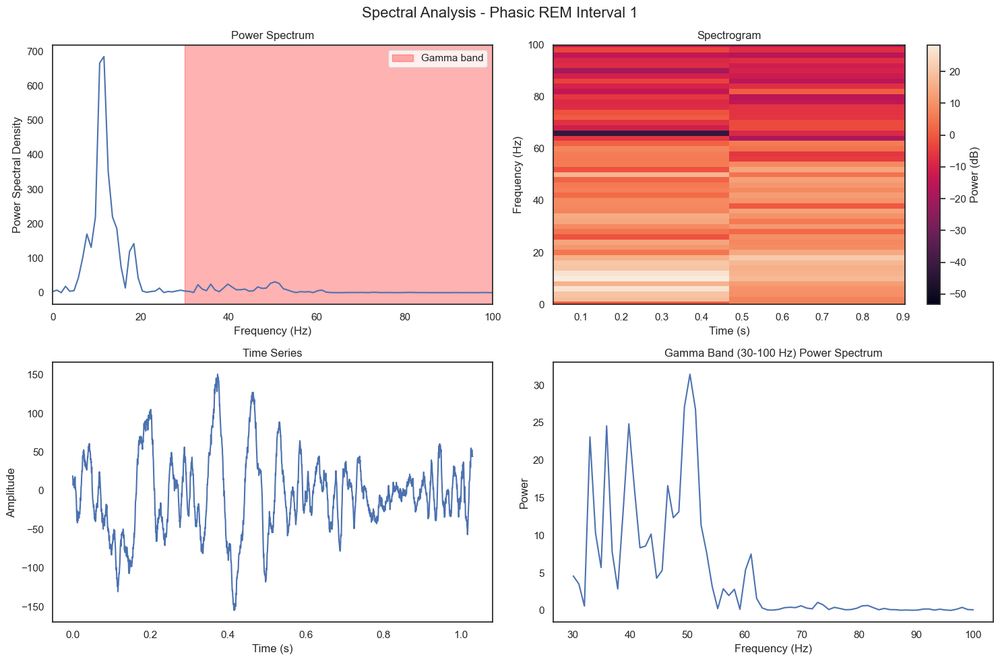


Phasic REM - Interval 2:
Number of IMF components: 8
  IMF-1: mean frequency = 560.71 Hz
  IMF-2: mean frequency = 216.43 Hz
  IMF-3: mean frequency = 60.21 Hz
  IMF-4: mean frequency = 24.21 Hz
  IMF-5: mean frequency = 7.38 Hz
  IMF-6: mean frequency = 3.33 Hz
  IMF-7: mean frequency = 1.26 Hz
  IMF-8: mean frequency = 0.62 Hz
Fast components (>15Hz) signal length: 3690 samples

SPECTRAL ANALYSIS: Phasic REM Interval 2
Peak frequency: 50.14 Hz
Total power: 778.2974
Gamma power (30-100 Hz): 335.8441
Gamma/total power ratio: 0.4315


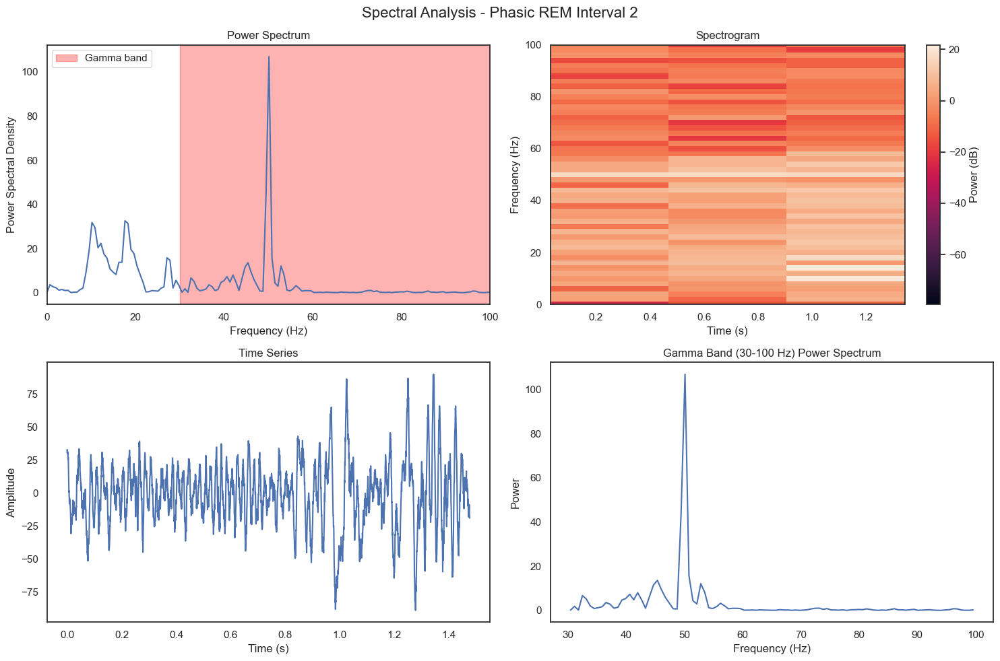


Phasic REM - Interval 3:
Number of IMF components: 7
  IMF-1: mean frequency = 592.46 Hz
  IMF-2: mean frequency = 263.54 Hz
  IMF-3: mean frequency = 73.79 Hz
  IMF-4: mean frequency = 27.98 Hz
  IMF-5: mean frequency = 9.86 Hz
  IMF-6: mean frequency = 3.27 Hz
  IMF-7: mean frequency = 0.78 Hz
Fast components (>15Hz) signal length: 3015 samples

SPECTRAL ANALYSIS: Phasic REM Interval 3
Peak frequency: 49.75 Hz
Total power: 612.4208
Gamma power (30-100 Hz): 259.5278
Gamma/total power ratio: 0.4238


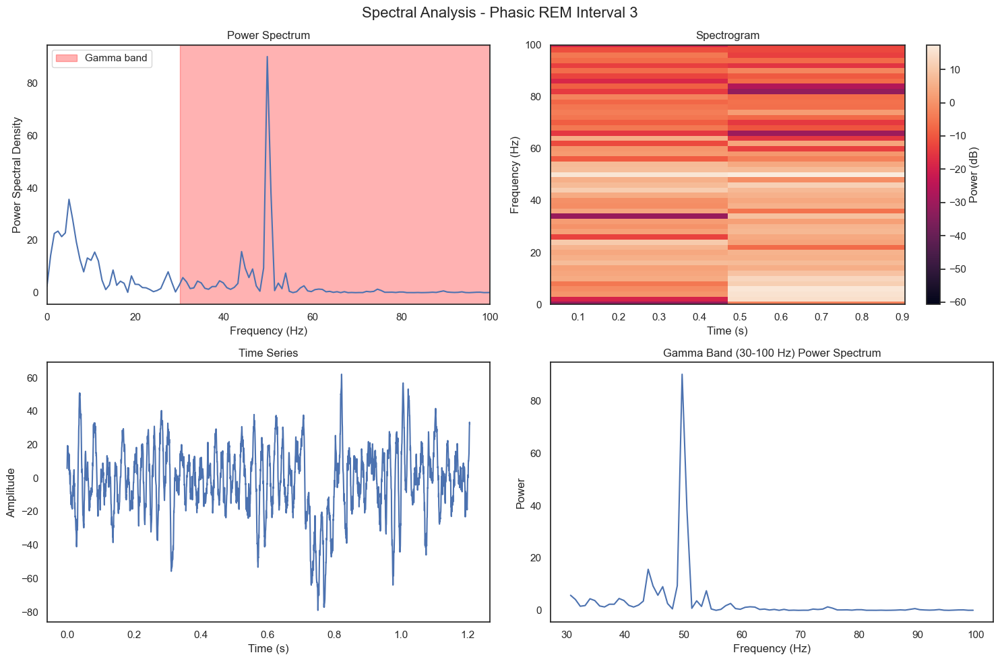


Phasic REM - Interval 4:
Number of IMF components: 7
  IMF-1: mean frequency = 566.70 Hz
  IMF-2: mean frequency = 264.04 Hz
  IMF-3: mean frequency = 63.88 Hz
  IMF-4: mean frequency = 26.17 Hz
  IMF-5: mean frequency = 10.50 Hz
  IMF-6: mean frequency = 4.12 Hz
  IMF-7: mean frequency = 0.99 Hz
Fast components (>15Hz) signal length: 2375 samples

SPECTRAL ANALYSIS: Phasic REM Interval 4
Peak frequency: 11.58 Hz
Total power: 1014.1816
Gamma power (30-100 Hz): 334.5862
Gamma/total power ratio: 0.3299


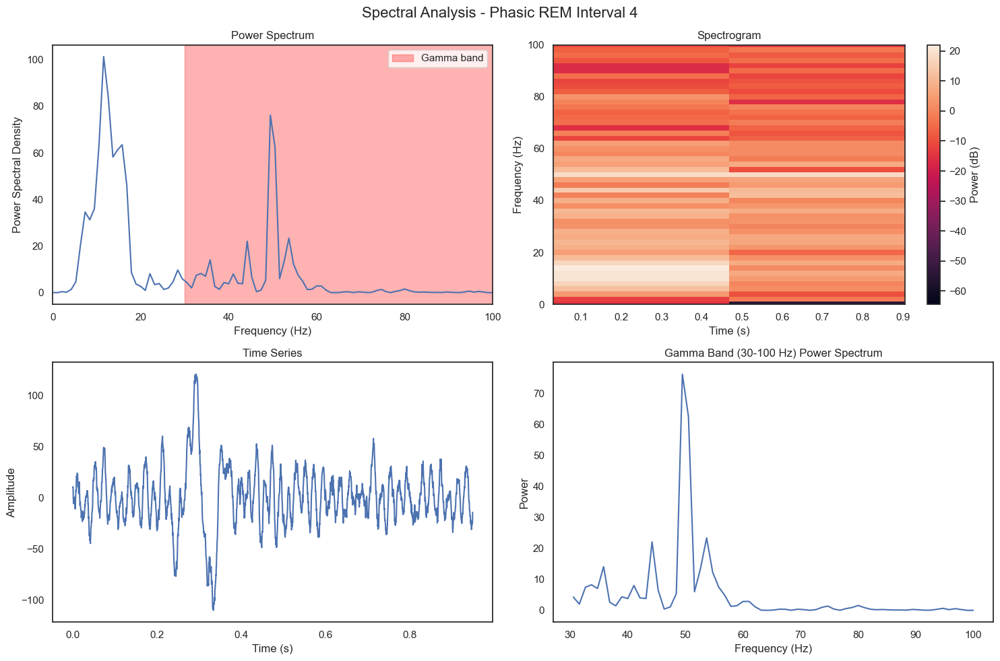


Phasic REM - Interval 5:
Number of IMF components: 7
  IMF-1: mean frequency = 584.28 Hz
  IMF-2: mean frequency = 230.04 Hz
  IMF-3: mean frequency = 56.01 Hz
  IMF-4: mean frequency = 21.14 Hz
  IMF-5: mean frequency = 8.26 Hz
  IMF-6: mean frequency = 3.59 Hz
  IMF-7: mean frequency = 0.85 Hz
Fast components (>15Hz) signal length: 2715 samples

SPECTRAL ANALYSIS: Phasic REM Interval 5
Peak frequency: 49.72 Hz
Total power: 606.9717
Gamma power (30-100 Hz): 314.5285
Gamma/total power ratio: 0.5182


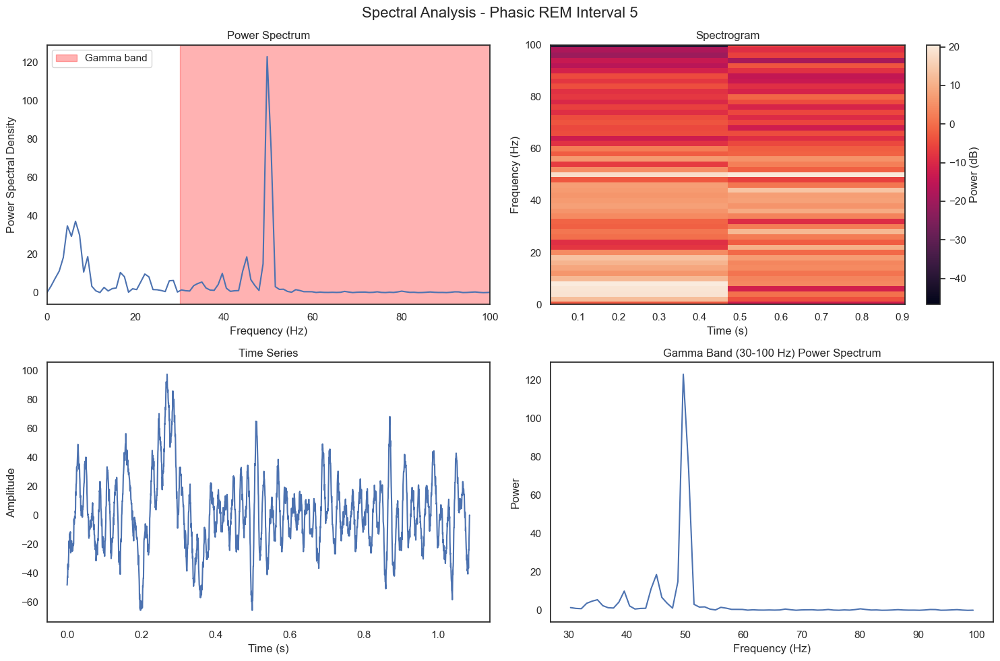


Phasic REM - Interval 6:
Number of IMF components: 7
  IMF-1: mean frequency = 591.52 Hz
  IMF-2: mean frequency = 241.13 Hz
  IMF-3: mean frequency = 51.45 Hz
  IMF-4: mean frequency = 19.03 Hz
  IMF-5: mean frequency = 7.30 Hz
  IMF-6: mean frequency = 2.41 Hz
  IMF-7: mean frequency = -0.01 Hz
Fast components (>15Hz) signal length: 3005 samples

SPECTRAL ANALYSIS: Phasic REM Interval 6
Peak frequency: 49.92 Hz
Total power: 1149.8241
Gamma power (30-100 Hz): 373.7786
Gamma/total power ratio: 0.3251


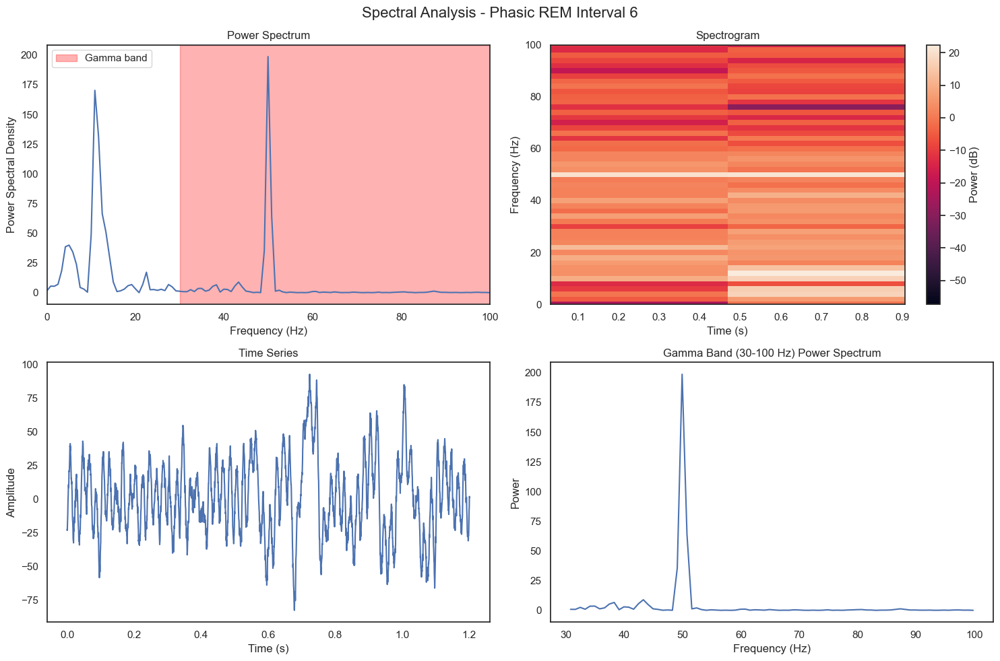


Phasic REM - Interval 7:
Number of IMF components: 7
  IMF-1: mean frequency = 588.95 Hz
  IMF-2: mean frequency = 265.89 Hz
  IMF-3: mean frequency = 58.29 Hz
  IMF-4: mean frequency = 22.99 Hz
  IMF-5: mean frequency = 10.02 Hz
  IMF-6: mean frequency = 3.94 Hz
  IMF-7: mean frequency = -0.07 Hz
Fast components (>15Hz) signal length: 2470 samples

SPECTRAL ANALYSIS: Phasic REM Interval 7
Peak frequency: 49.60 Hz
Total power: 505.5296
Gamma power (30-100 Hz): 367.0606
Gamma/total power ratio: 0.7261


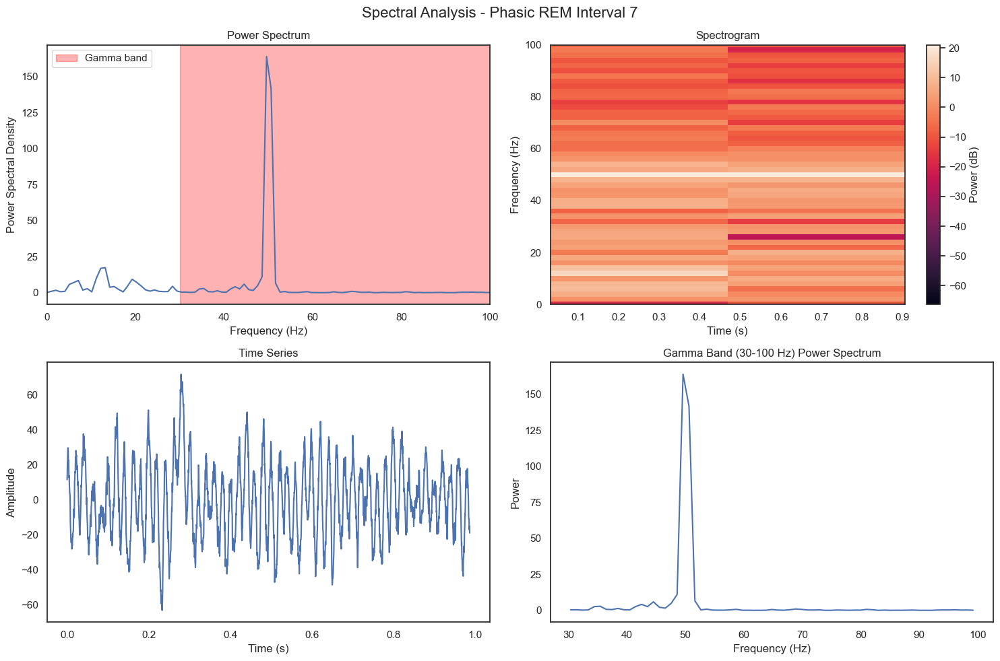


Phasic REM - Interval 8:
Number of IMF components: 7
  IMF-1: mean frequency = 587.77 Hz
  IMF-2: mean frequency = 265.84 Hz
  IMF-3: mean frequency = 60.54 Hz
  IMF-4: mean frequency = 24.23 Hz
  IMF-5: mean frequency = 7.61 Hz
  IMF-6: mean frequency = 2.18 Hz
  IMF-7: mean frequency = -0.00 Hz
Fast components (>15Hz) signal length: 2270 samples

SPECTRAL ANALYSIS: Phasic REM Interval 8
Peak frequency: 49.56 Hz
Total power: 528.9932
Gamma power (30-100 Hz): 194.4869
Gamma/total power ratio: 0.3677


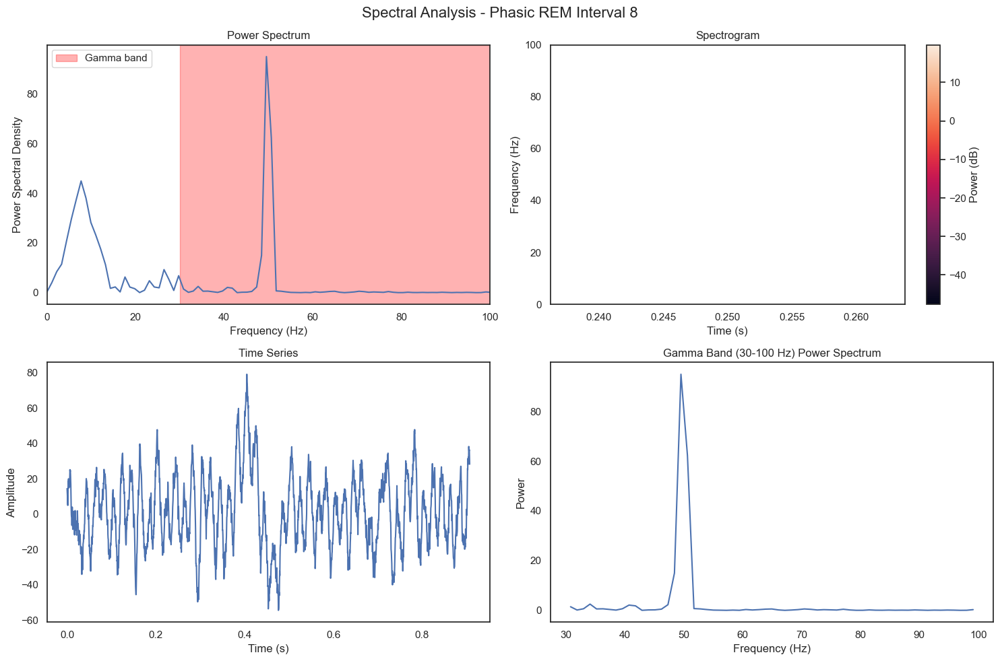


Phasic REM - Interval 9:
Number of IMF components: 7
  IMF-1: mean frequency = 594.39 Hz
  IMF-2: mean frequency = 241.23 Hz
  IMF-3: mean frequency = 59.13 Hz
  IMF-4: mean frequency = 21.58 Hz
  IMF-5: mean frequency = 5.66 Hz
  IMF-6: mean frequency = 2.73 Hz
  IMF-7: mean frequency = -0.05 Hz
Fast components (>15Hz) signal length: 2650 samples

SPECTRAL ANALYSIS: Phasic REM Interval 9
Peak frequency: 50.00 Hz
Total power: 874.2467
Gamma power (30-100 Hz): 232.8693
Gamma/total power ratio: 0.2664


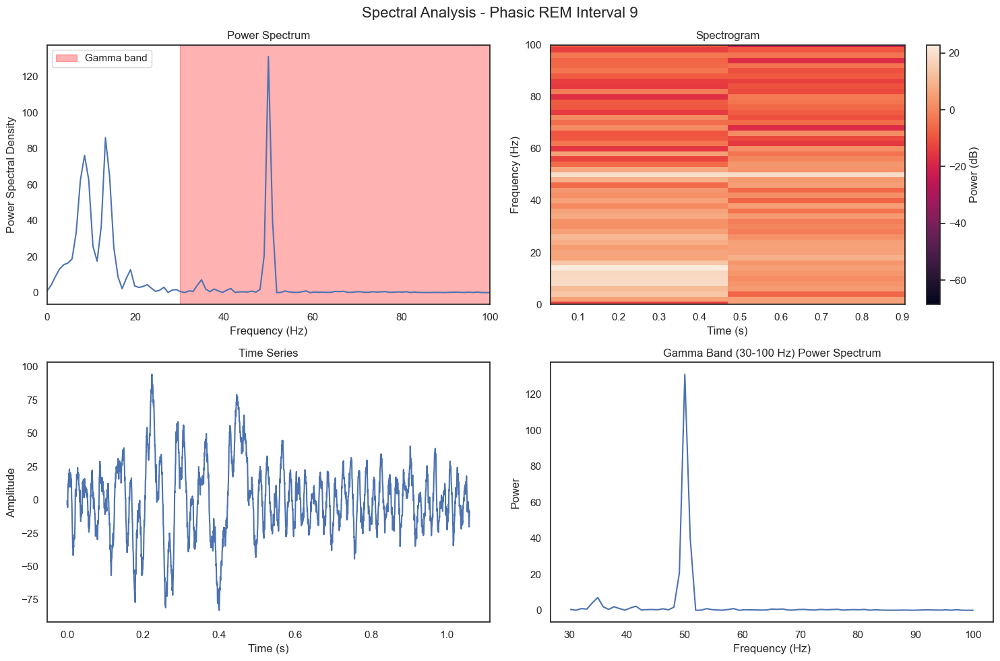


Phasic REM - Interval 10:
Number of IMF components: 8
  IMF-1: mean frequency = 597.91 Hz
  IMF-2: mean frequency = 275.11 Hz
  IMF-3: mean frequency = 66.16 Hz
  IMF-4: mean frequency = 24.23 Hz
  IMF-5: mean frequency = 8.64 Hz
  IMF-6: mean frequency = 3.12 Hz
  IMF-7: mean frequency = 1.18 Hz
  IMF-8: mean frequency = -0.04 Hz
Fast components (>15Hz) signal length: 4005 samples

SPECTRAL ANALYSIS: Phasic REM Interval 10
Peak frequency: 49.94 Hz
Total power: 1454.7367
Gamma power (30-100 Hz): 400.4005
Gamma/total power ratio: 0.2752


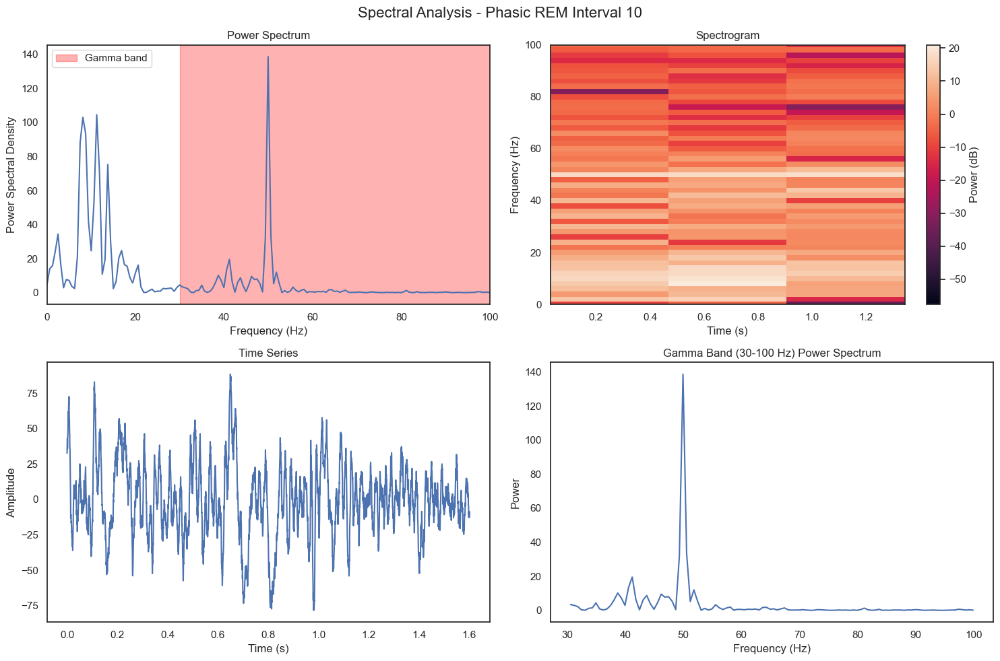

In [32]:
# Cell 6: Analyze phasic REM intervals
print("ANALYZING PHASIC REM INTERVALS")
phasic_fast_signals, phasic_spectral_results = analyze_all_intervals(
    phasic_imfs_default, phasic_imfs_freqs_default, phasic_rem_lpf_default, "Phasic REM")


ANALYZING TONIC REM INTERVALS

Tonic REM - Interval 1:
Number of IMF components: 12
  IMF-1: mean frequency = 587.36 Hz
  IMF-2: mean frequency = 258.03 Hz
  IMF-3: mean frequency = 72.24 Hz
  IMF-4: mean frequency = 30.28 Hz
  IMF-5: mean frequency = 11.38 Hz
  IMF-6: mean frequency = 4.78 Hz
  IMF-7: mean frequency = 1.81 Hz
  IMF-8: mean frequency = 0.60 Hz
  IMF-9: mean frequency = 0.25 Hz
  IMF-10: mean frequency = 0.12 Hz
  IMF-11: mean frequency = 0.05 Hz
  IMF-12: mean frequency = 0.02 Hz
Fast components (>15Hz) signal length: 150675 samples

SPECTRAL ANALYSIS: Tonic REM Interval 1
Peak frequency: 50.00 Hz
Total power: 370.0113
Gamma power (30-100 Hz): 229.2011
Gamma/total power ratio: 0.6194


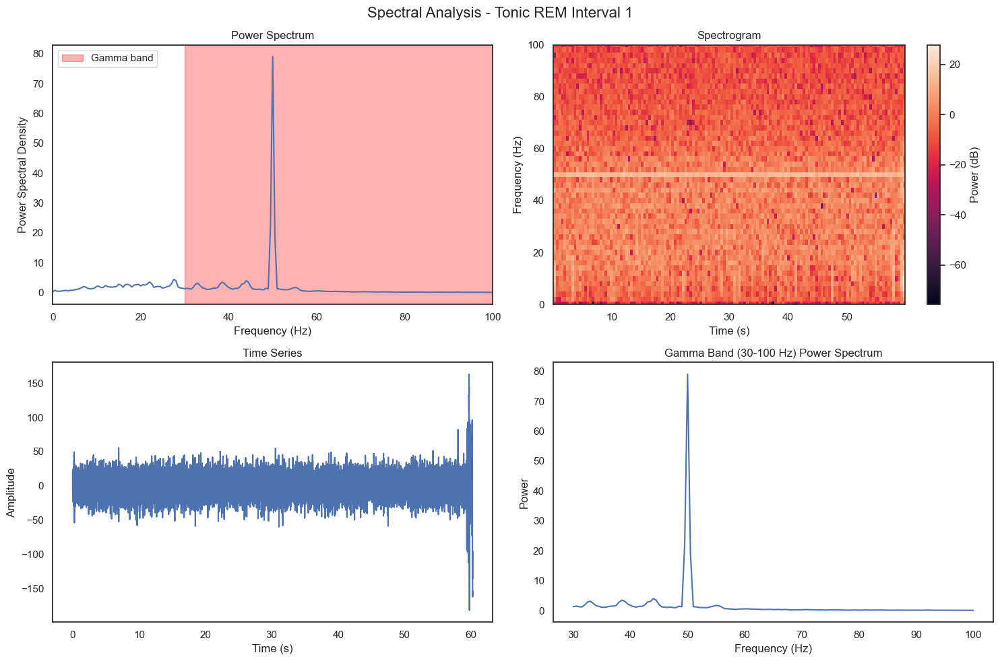


Tonic REM - Interval 2:
Number of IMF components: 9
  IMF-1: mean frequency = 588.36 Hz
  IMF-2: mean frequency = 250.29 Hz
  IMF-3: mean frequency = 63.78 Hz
  IMF-4: mean frequency = 26.54 Hz
  IMF-5: mean frequency = 10.10 Hz
  IMF-6: mean frequency = 3.20 Hz
  IMF-7: mean frequency = 1.03 Hz
  IMF-8: mean frequency = 0.23 Hz
  IMF-9: mean frequency = 0.11 Hz
Fast components (>15Hz) signal length: 21750 samples

SPECTRAL ANALYSIS: Tonic REM Interval 2
Peak frequency: 17.50 Hz
Total power: 19995.4653
Gamma power (30-100 Hz): 8492.9947
Gamma/total power ratio: 0.4247


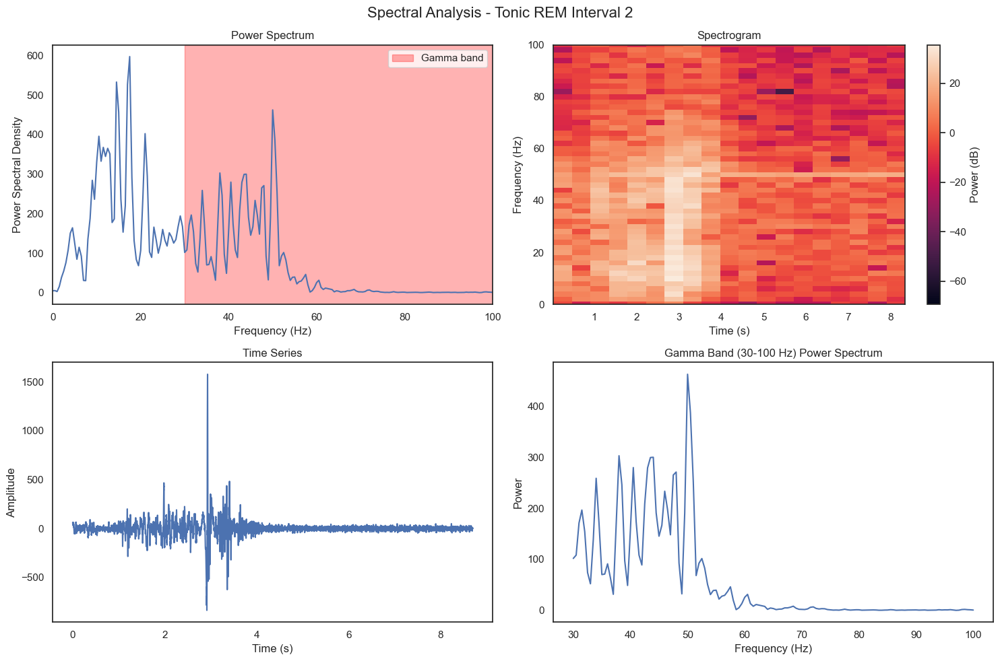


Tonic REM - Interval 3:
Number of IMF components: 12
  IMF-1: mean frequency = 579.61 Hz
  IMF-2: mean frequency = 260.68 Hz
  IMF-3: mean frequency = 63.41 Hz
  IMF-4: mean frequency = 25.57 Hz
  IMF-5: mean frequency = 9.40 Hz
  IMF-6: mean frequency = 3.87 Hz
  IMF-7: mean frequency = 1.41 Hz
  IMF-8: mean frequency = 0.44 Hz
  IMF-9: mean frequency = 0.17 Hz
  IMF-10: mean frequency = 0.11 Hz
  IMF-11: mean frequency = 0.06 Hz
  IMF-12: mean frequency = -0.00 Hz
Fast components (>15Hz) signal length: 113510 samples

SPECTRAL ANALYSIS: Tonic REM Interval 3
Peak frequency: 50.00 Hz
Total power: 703.3575
Gamma power (30-100 Hz): 434.8674
Gamma/total power ratio: 0.6183


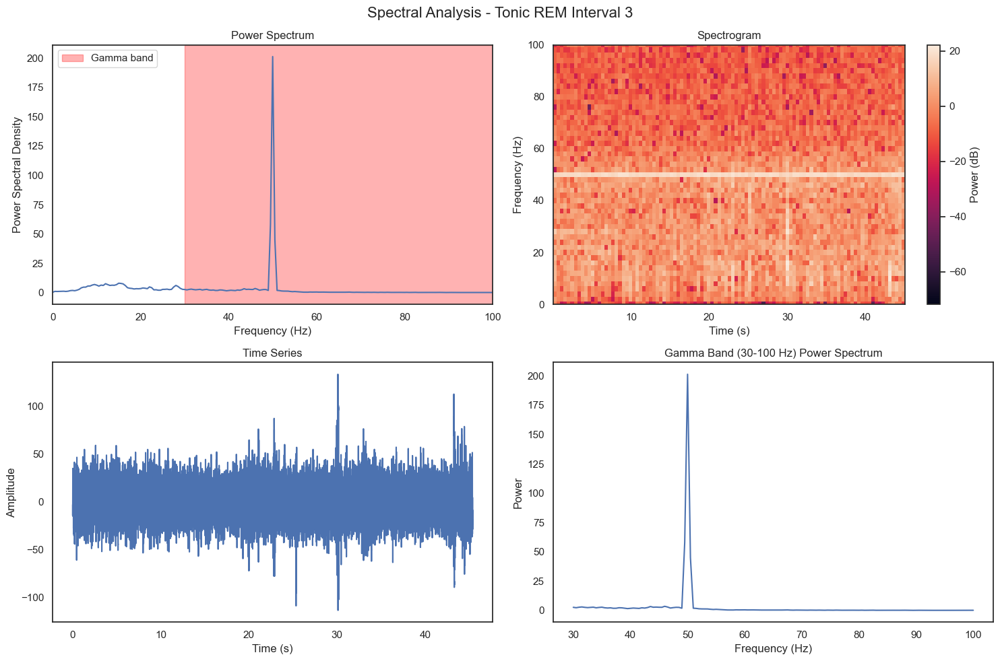


Tonic REM - Interval 4:
Number of IMF components: 11
  IMF-1: mean frequency = 575.93 Hz
  IMF-2: mean frequency = 255.99 Hz
  IMF-3: mean frequency = 62.79 Hz
  IMF-4: mean frequency = 24.17 Hz
  IMF-5: mean frequency = 9.26 Hz
  IMF-6: mean frequency = 3.72 Hz
  IMF-7: mean frequency = 1.20 Hz
  IMF-8: mean frequency = 0.50 Hz
  IMF-9: mean frequency = 0.20 Hz
  IMF-10: mean frequency = 0.09 Hz
  IMF-11: mean frequency = 0.03 Hz
Fast components (>15Hz) signal length: 85315 samples

SPECTRAL ANALYSIS: Tonic REM Interval 4
Peak frequency: 50.00 Hz
Total power: 893.2891
Gamma power (30-100 Hz): 495.4434
Gamma/total power ratio: 0.5546


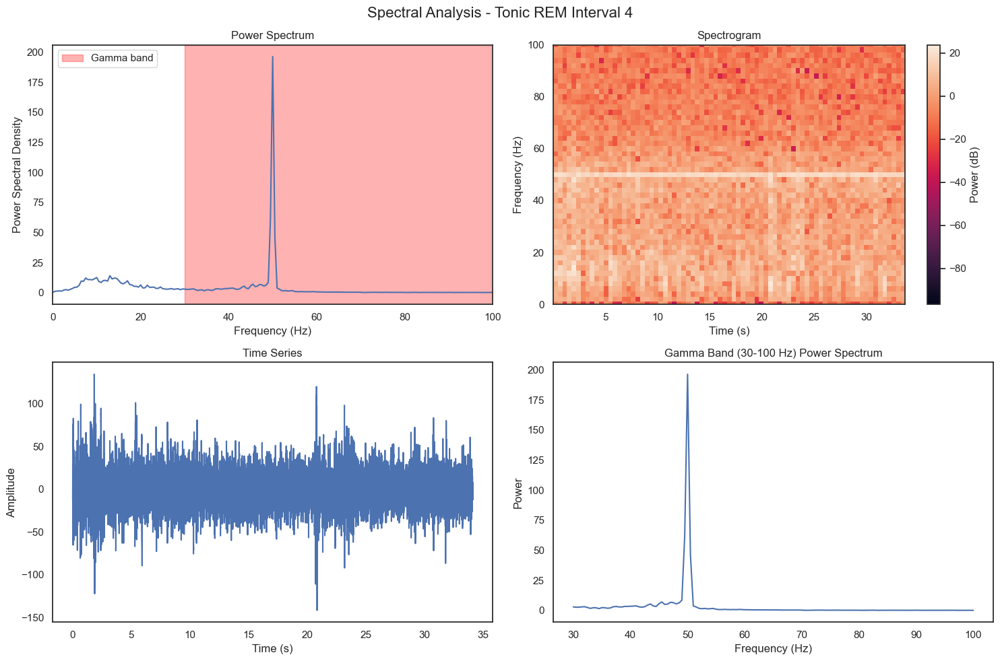


Tonic REM - Interval 5:
Number of IMF components: 7
  IMF-1: mean frequency = 586.97 Hz
  IMF-2: mean frequency = 251.64 Hz
  IMF-3: mean frequency = 61.78 Hz
  IMF-4: mean frequency = 23.59 Hz
  IMF-5: mean frequency = 7.68 Hz
  IMF-6: mean frequency = 2.56 Hz
  IMF-7: mean frequency = 0.30 Hz
Fast components (>15Hz) signal length: 7715 samples

SPECTRAL ANALYSIS: Tonic REM Interval 5
Peak frequency: 50.00 Hz
Total power: 745.9083
Gamma power (30-100 Hz): 481.7049
Gamma/total power ratio: 0.6458


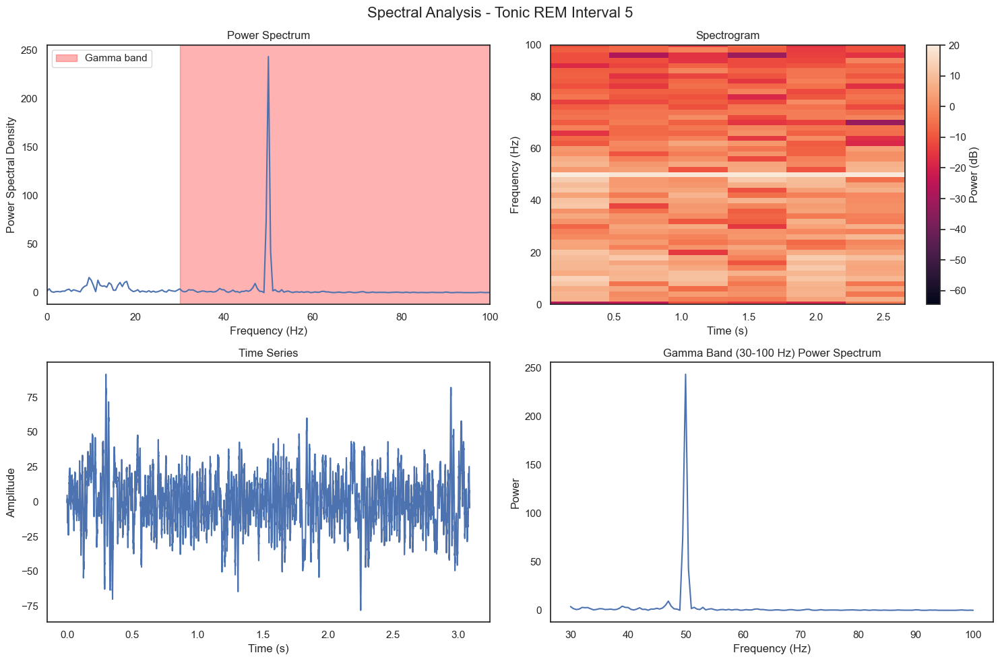


Tonic REM - Interval 6:
Number of IMF components: 11
  IMF-1: mean frequency = 606.34 Hz
  IMF-2: mean frequency = 272.38 Hz
  IMF-3: mean frequency = 67.11 Hz
  IMF-4: mean frequency = 29.13 Hz
  IMF-5: mean frequency = 10.60 Hz
  IMF-6: mean frequency = 4.33 Hz
  IMF-7: mean frequency = 1.55 Hz
  IMF-8: mean frequency = 0.50 Hz
  IMF-9: mean frequency = 0.21 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = -0.00 Hz
Fast components (>15Hz) signal length: 59380 samples

SPECTRAL ANALYSIS: Tonic REM Interval 6
Peak frequency: 50.00 Hz
Total power: 1740.6764
Gamma power (30-100 Hz): 512.1233
Gamma/total power ratio: 0.2942


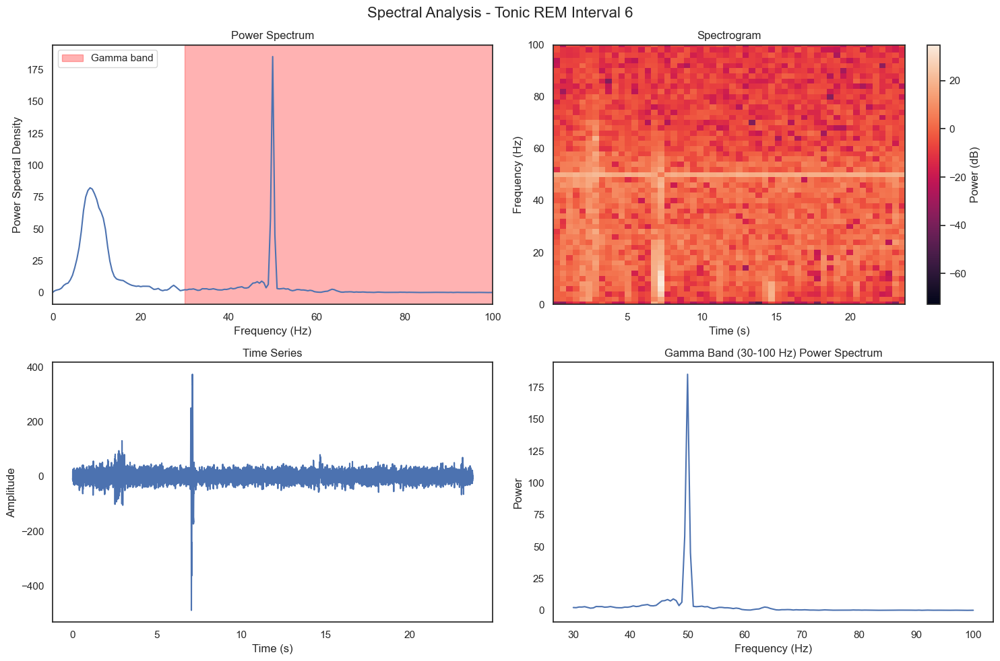


Tonic REM - Interval 7:
Number of IMF components: 10
  IMF-1: mean frequency = 579.32 Hz
  IMF-2: mean frequency = 260.53 Hz
  IMF-3: mean frequency = 61.02 Hz
  IMF-4: mean frequency = 24.56 Hz
  IMF-5: mean frequency = 9.51 Hz
  IMF-6: mean frequency = 3.66 Hz
  IMF-7: mean frequency = 1.42 Hz
  IMF-8: mean frequency = 0.30 Hz
  IMF-9: mean frequency = 0.15 Hz
  IMF-10: mean frequency = 0.03 Hz
Fast components (>15Hz) signal length: 82500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 7
Peak frequency: 50.00 Hz
Total power: 705.3000
Gamma power (30-100 Hz): 438.4217
Gamma/total power ratio: 0.6216


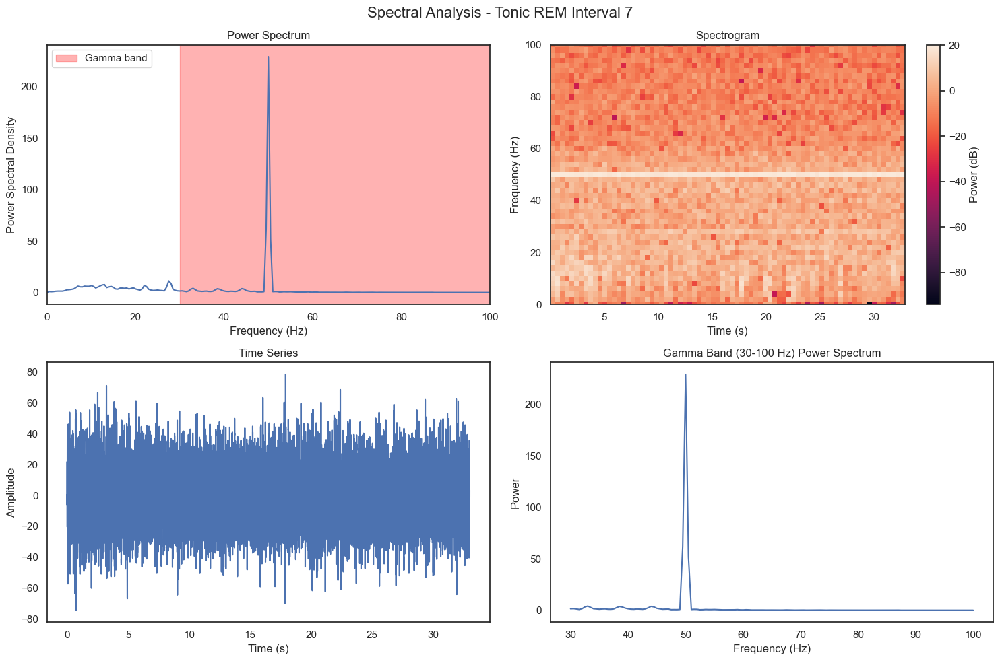


Tonic REM - Interval 8:
Number of IMF components: 13
  IMF-1: mean frequency = 575.52 Hz
  IMF-2: mean frequency = 249.33 Hz
  IMF-3: mean frequency = 59.50 Hz
  IMF-4: mean frequency = 23.60 Hz
  IMF-5: mean frequency = 8.20 Hz
  IMF-6: mean frequency = 3.23 Hz
  IMF-7: mean frequency = 1.30 Hz
  IMF-8: mean frequency = 0.47 Hz
  IMF-9: mean frequency = 0.19 Hz
  IMF-10: mean frequency = 0.09 Hz
  IMF-11: mean frequency = 0.04 Hz
  IMF-12: mean frequency = 0.02 Hz
  IMF-13: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 542500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 8
Peak frequency: 50.00 Hz
Total power: 853.5963
Gamma power (30-100 Hz): 511.6942
Gamma/total power ratio: 0.5995


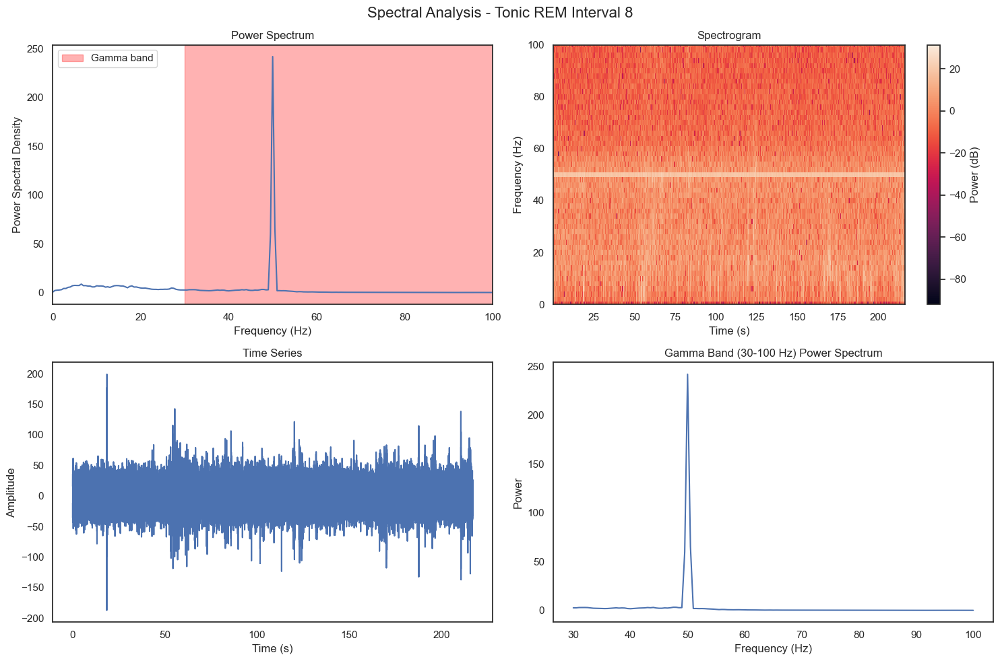


Tonic REM - Interval 9:
Number of IMF components: 10
  IMF-1: mean frequency = 580.40 Hz
  IMF-2: mean frequency = 259.09 Hz
  IMF-3: mean frequency = 62.05 Hz
  IMF-4: mean frequency = 24.48 Hz
  IMF-5: mean frequency = 8.86 Hz
  IMF-6: mean frequency = 3.38 Hz
  IMF-7: mean frequency = 1.23 Hz
  IMF-8: mean frequency = 0.36 Hz
  IMF-9: mean frequency = 0.12 Hz
  IMF-10: mean frequency = -0.00 Hz
Fast components (>15Hz) signal length: 40605 samples

SPECTRAL ANALYSIS: Tonic REM Interval 9
Peak frequency: 50.00 Hz
Total power: 726.1383
Gamma power (30-100 Hz): 456.8944
Gamma/total power ratio: 0.6292


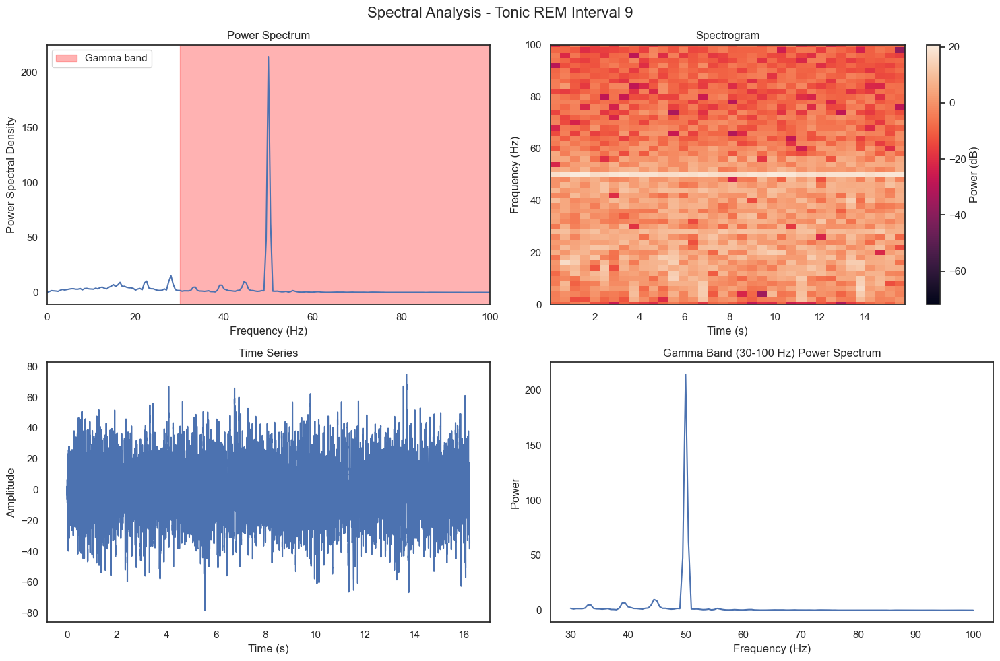


Tonic REM - Interval 10:
Number of IMF components: 12
  IMF-1: mean frequency = 577.01 Hz
  IMF-2: mean frequency = 249.16 Hz
  IMF-3: mean frequency = 60.76 Hz
  IMF-4: mean frequency = 25.53 Hz
  IMF-5: mean frequency = 9.39 Hz
  IMF-6: mean frequency = 3.83 Hz
  IMF-7: mean frequency = 1.48 Hz
  IMF-8: mean frequency = 0.44 Hz
  IMF-9: mean frequency = 0.20 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = 0.03 Hz
  IMF-12: mean frequency = 0.03 Hz
Fast components (>15Hz) signal length: 159135 samples

SPECTRAL ANALYSIS: Tonic REM Interval 10
Peak frequency: 3.00 Hz
Total power: 36423.7082
Gamma power (30-100 Hz): 683.1273
Gamma/total power ratio: 0.0188


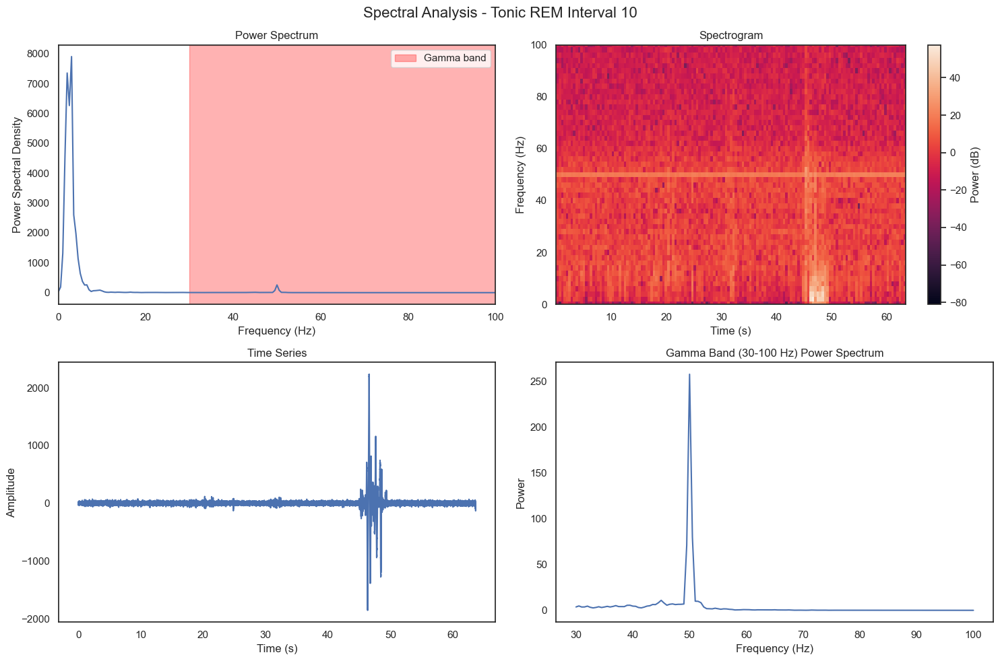


Tonic REM - Interval 11:
Number of IMF components: 11
  IMF-1: mean frequency = 576.31 Hz
  IMF-2: mean frequency = 250.81 Hz
  IMF-3: mean frequency = 55.11 Hz
  IMF-4: mean frequency = 21.30 Hz
  IMF-5: mean frequency = 8.39 Hz
  IMF-6: mean frequency = 3.09 Hz
  IMF-7: mean frequency = 1.25 Hz
  IMF-8: mean frequency = 0.41 Hz
  IMF-9: mean frequency = 0.17 Hz
  IMF-10: mean frequency = 0.07 Hz
  IMF-11: mean frequency = 0.03 Hz
Fast components (>15Hz) signal length: 72035 samples

SPECTRAL ANALYSIS: Tonic REM Interval 11
Peak frequency: 50.00 Hz
Total power: 1023.9055
Gamma power (30-100 Hz): 652.2329
Gamma/total power ratio: 0.6370


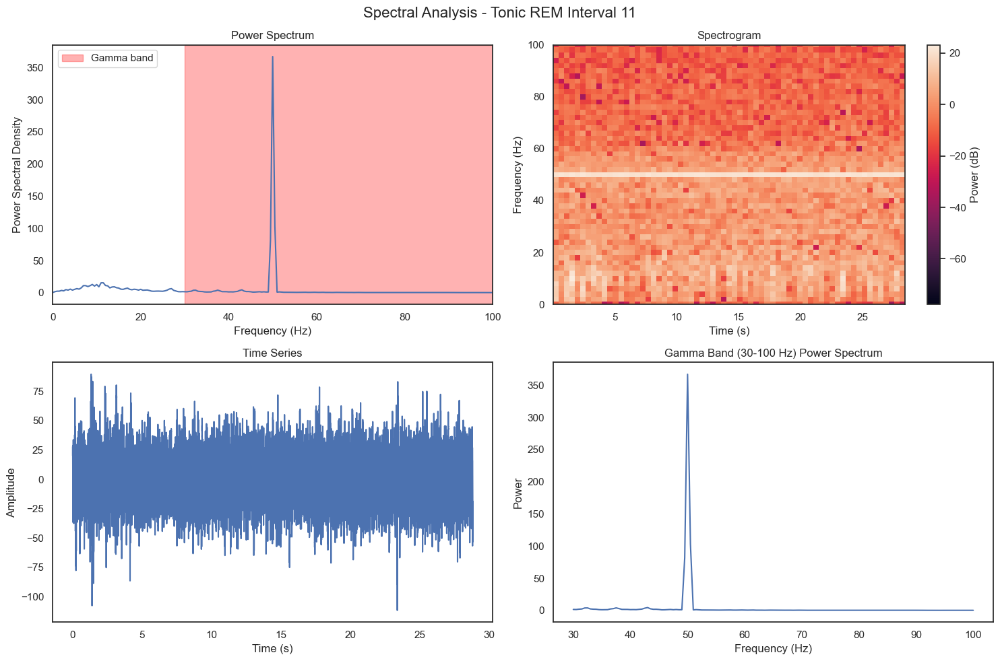


Tonic REM - Interval 12:
Number of IMF components: 12
  IMF-1: mean frequency = 576.40 Hz
  IMF-2: mean frequency = 251.13 Hz
  IMF-3: mean frequency = 55.51 Hz
  IMF-4: mean frequency = 22.56 Hz
  IMF-5: mean frequency = 8.42 Hz
  IMF-6: mean frequency = 3.28 Hz
  IMF-7: mean frequency = 1.31 Hz
  IMF-8: mean frequency = 0.47 Hz
  IMF-9: mean frequency = 0.21 Hz
  IMF-10: mean frequency = 0.10 Hz
  IMF-11: mean frequency = 0.05 Hz
  IMF-12: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 380035 samples

SPECTRAL ANALYSIS: Tonic REM Interval 12
Peak frequency: 50.00 Hz
Total power: 996.5039
Gamma power (30-100 Hz): 693.5034
Gamma/total power ratio: 0.6959


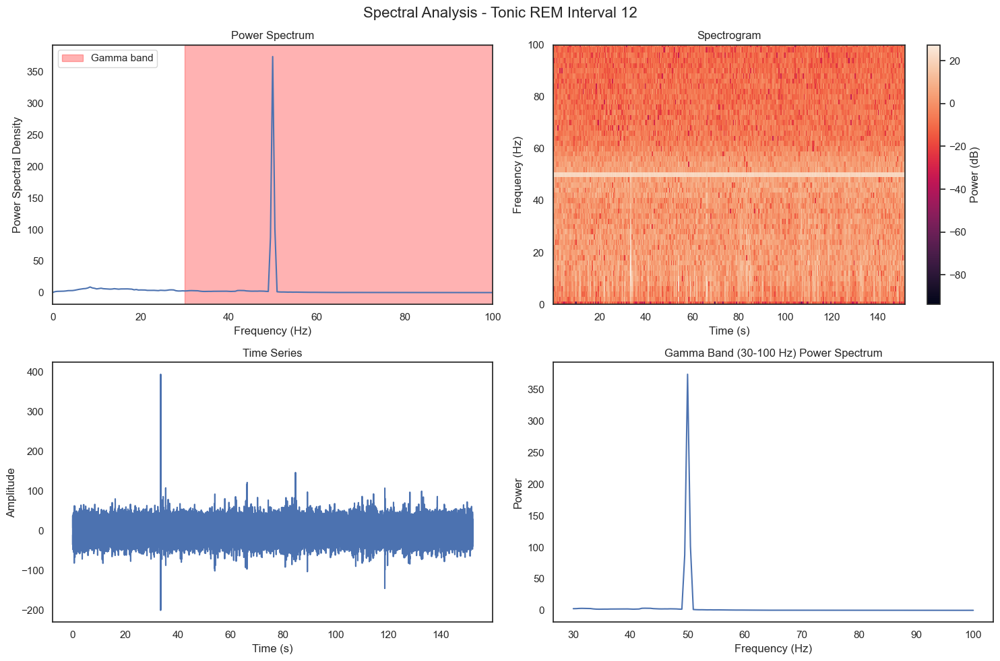


Tonic REM - Interval 13:
Number of IMF components: 10
  IMF-1: mean frequency = 590.09 Hz
  IMF-2: mean frequency = 262.59 Hz
  IMF-3: mean frequency = 62.39 Hz
  IMF-4: mean frequency = 24.69 Hz
  IMF-5: mean frequency = 8.70 Hz
  IMF-6: mean frequency = 2.84 Hz
  IMF-7: mean frequency = 1.20 Hz
  IMF-8: mean frequency = 0.55 Hz
  IMF-9: mean frequency = 0.25 Hz
  IMF-10: mean frequency = 0.10 Hz
Fast components (>15Hz) signal length: 50000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 13
Peak frequency: 50.00 Hz
Total power: 647.0927
Gamma power (30-100 Hz): 381.7471
Gamma/total power ratio: 0.5899


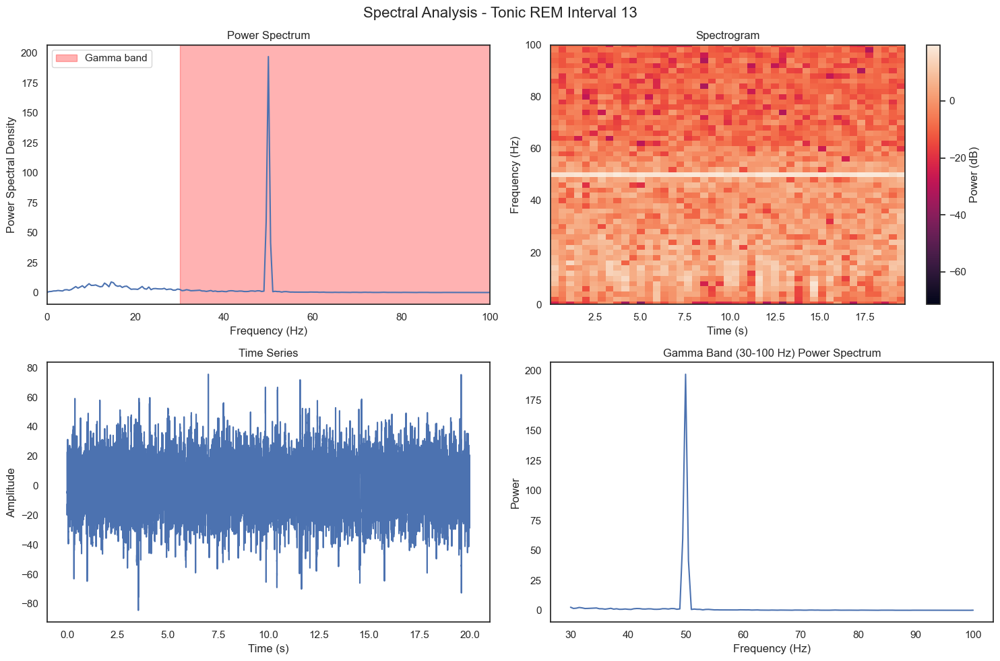


Tonic REM - Interval 14:
Number of IMF components: 10
  IMF-1: mean frequency = 592.62 Hz
  IMF-2: mean frequency = 265.59 Hz
  IMF-3: mean frequency = 61.09 Hz
  IMF-4: mean frequency = 24.77 Hz
  IMF-5: mean frequency = 8.78 Hz
  IMF-6: mean frequency = 2.83 Hz
  IMF-7: mean frequency = 1.16 Hz
  IMF-8: mean frequency = 0.29 Hz
  IMF-9: mean frequency = 0.14 Hz
  IMF-10: mean frequency = 0.07 Hz
Fast components (>15Hz) signal length: 34410 samples

SPECTRAL ANALYSIS: Tonic REM Interval 14
Peak frequency: 50.00 Hz
Total power: 816.9952
Gamma power (30-100 Hz): 438.3476
Gamma/total power ratio: 0.5365


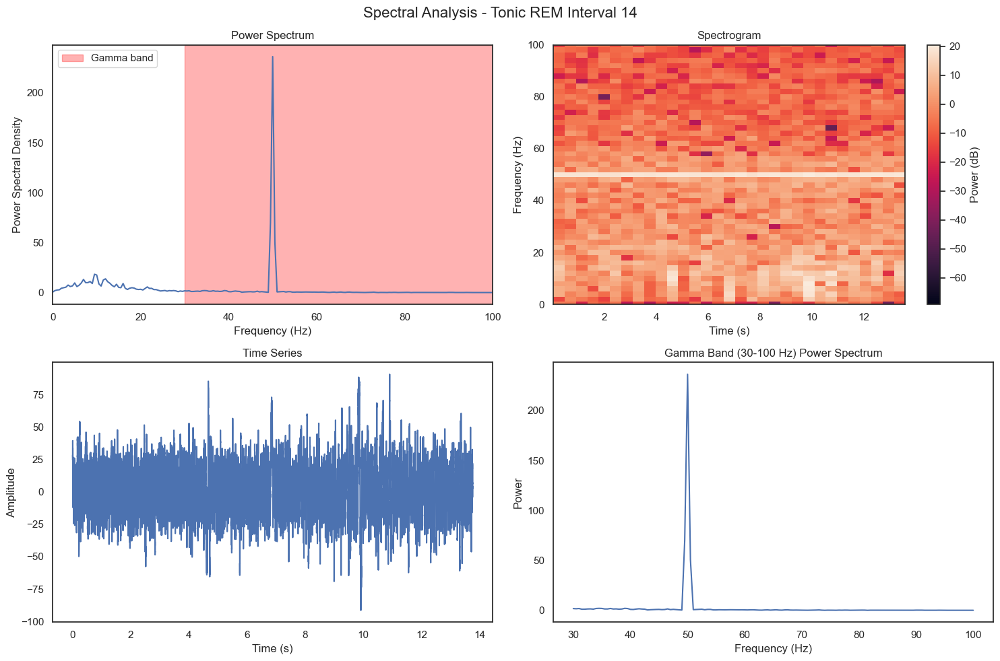


Tonic REM - Interval 15:
Number of IMF components: 10
  IMF-1: mean frequency = 584.92 Hz
  IMF-2: mean frequency = 261.83 Hz
  IMF-3: mean frequency = 64.12 Hz
  IMF-4: mean frequency = 25.88 Hz
  IMF-5: mean frequency = 9.65 Hz
  IMF-6: mean frequency = 3.30 Hz
  IMF-7: mean frequency = 1.51 Hz
  IMF-8: mean frequency = 0.62 Hz
  IMF-9: mean frequency = 0.27 Hz
  IMF-10: mean frequency = 0.17 Hz
Fast components (>15Hz) signal length: 27985 samples

SPECTRAL ANALYSIS: Tonic REM Interval 15
Peak frequency: 50.00 Hz
Total power: 777.8778
Gamma power (30-100 Hz): 434.6019
Gamma/total power ratio: 0.5587


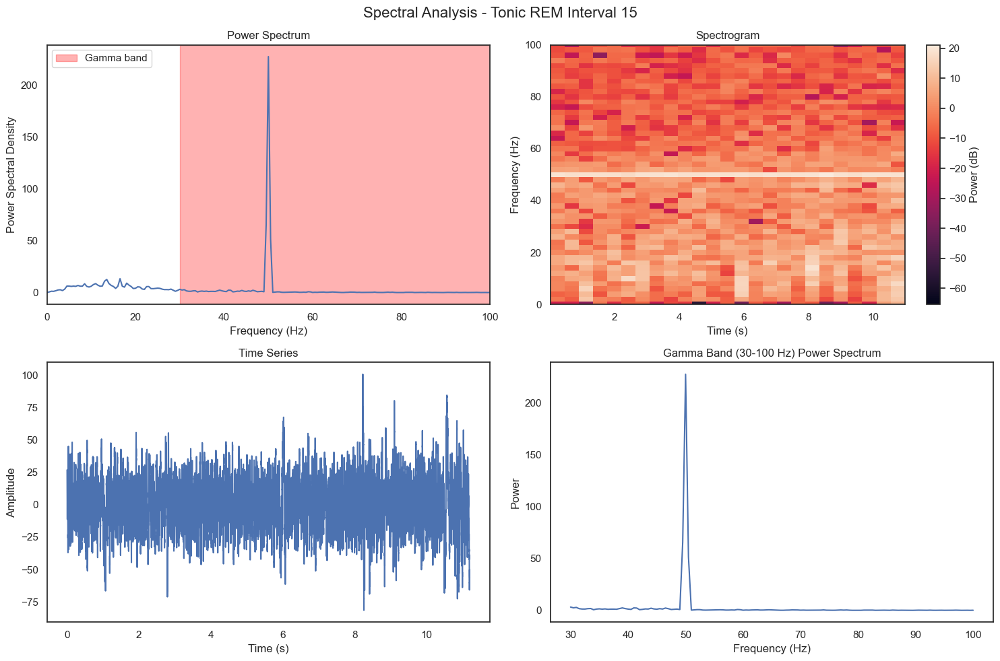


Tonic REM - Interval 16:
Number of IMF components: 13
  IMF-1: mean frequency = 602.88 Hz
  IMF-2: mean frequency = 271.37 Hz
  IMF-3: mean frequency = 67.03 Hz
  IMF-4: mean frequency = 28.23 Hz
  IMF-5: mean frequency = 10.15 Hz
  IMF-6: mean frequency = 3.44 Hz
  IMF-7: mean frequency = 1.44 Hz
  IMF-8: mean frequency = 0.52 Hz
  IMF-9: mean frequency = 0.23 Hz
  IMF-10: mean frequency = 0.11 Hz
  IMF-11: mean frequency = 0.05 Hz
  IMF-12: mean frequency = 0.03 Hz
  IMF-13: mean frequency = -0.00 Hz
Fast components (>15Hz) signal length: 280185 samples

SPECTRAL ANALYSIS: Tonic REM Interval 16
Peak frequency: 50.00 Hz
Total power: 757.7215
Gamma power (30-100 Hz): 441.1841
Gamma/total power ratio: 0.5823


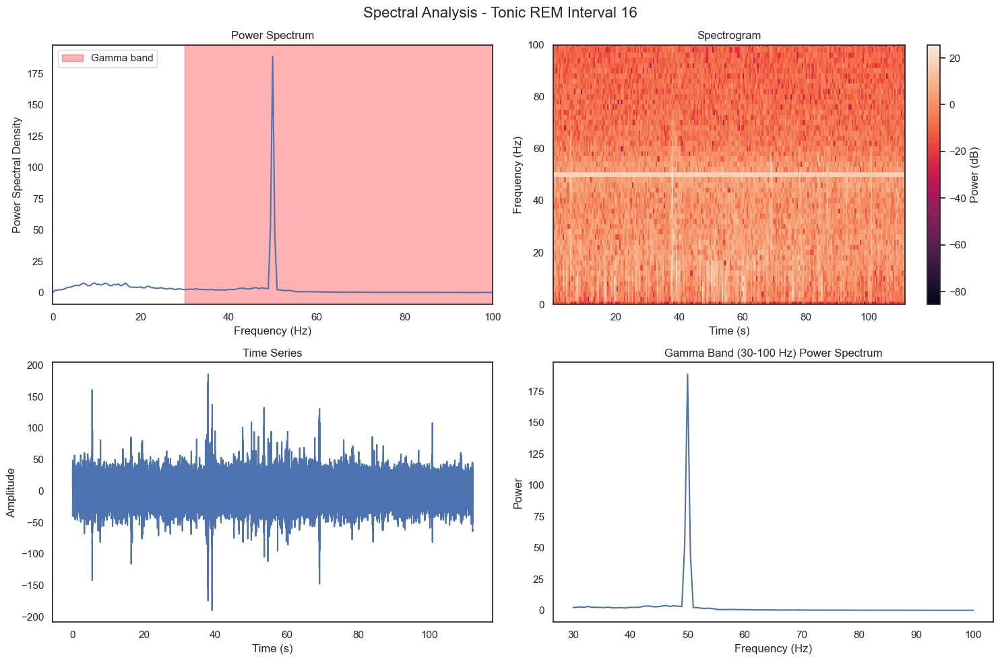


Tonic REM - Interval 17:
Number of IMF components: 11
  IMF-1: mean frequency = 585.45 Hz
  IMF-2: mean frequency = 260.48 Hz
  IMF-3: mean frequency = 66.10 Hz
  IMF-4: mean frequency = 27.59 Hz
  IMF-5: mean frequency = 9.84 Hz
  IMF-6: mean frequency = 4.03 Hz
  IMF-7: mean frequency = 1.64 Hz
  IMF-8: mean frequency = 0.43 Hz
  IMF-9: mean frequency = 0.20 Hz
  IMF-10: mean frequency = 0.10 Hz
  IMF-11: mean frequency = 0.05 Hz
Fast components (>15Hz) signal length: 97500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 17
Peak frequency: 50.00 Hz
Total power: 456.9625
Gamma power (30-100 Hz): 278.9910
Gamma/total power ratio: 0.6105


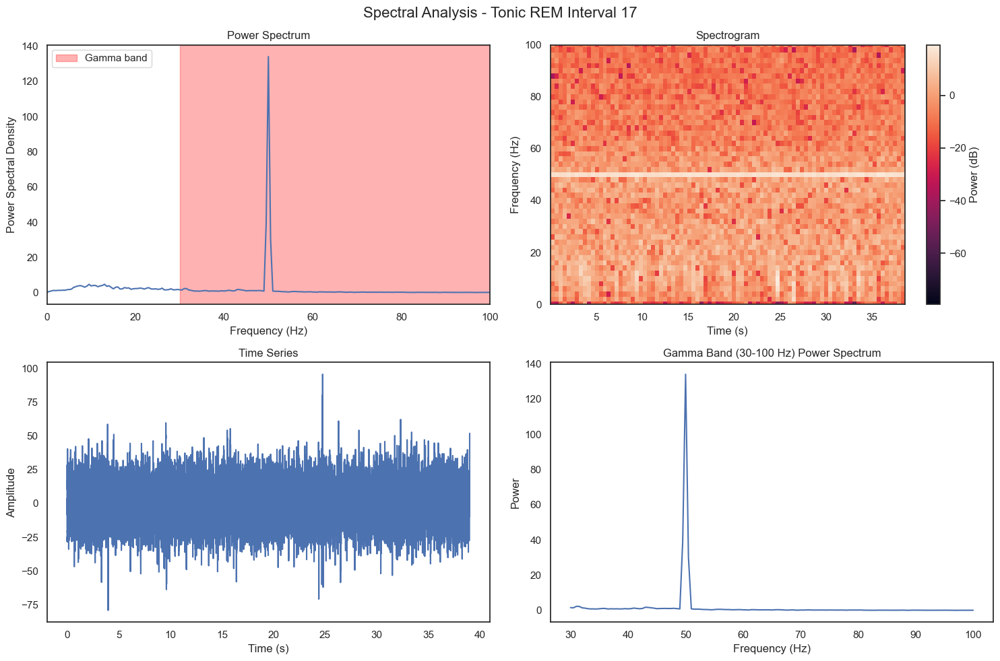


Tonic REM - Interval 18:
Number of IMF components: 9
  IMF-1: mean frequency = 573.51 Hz
  IMF-2: mean frequency = 249.43 Hz
  IMF-3: mean frequency = 54.99 Hz
  IMF-4: mean frequency = 21.90 Hz
  IMF-5: mean frequency = 8.07 Hz
  IMF-6: mean frequency = 3.08 Hz
  IMF-7: mean frequency = 1.30 Hz
  IMF-8: mean frequency = 0.30 Hz
  IMF-9: mean frequency = 0.08 Hz
Fast components (>15Hz) signal length: 32500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 18
Peak frequency: 50.00 Hz
Total power: 924.2204
Gamma power (30-100 Hz): 609.9326
Gamma/total power ratio: 0.6599


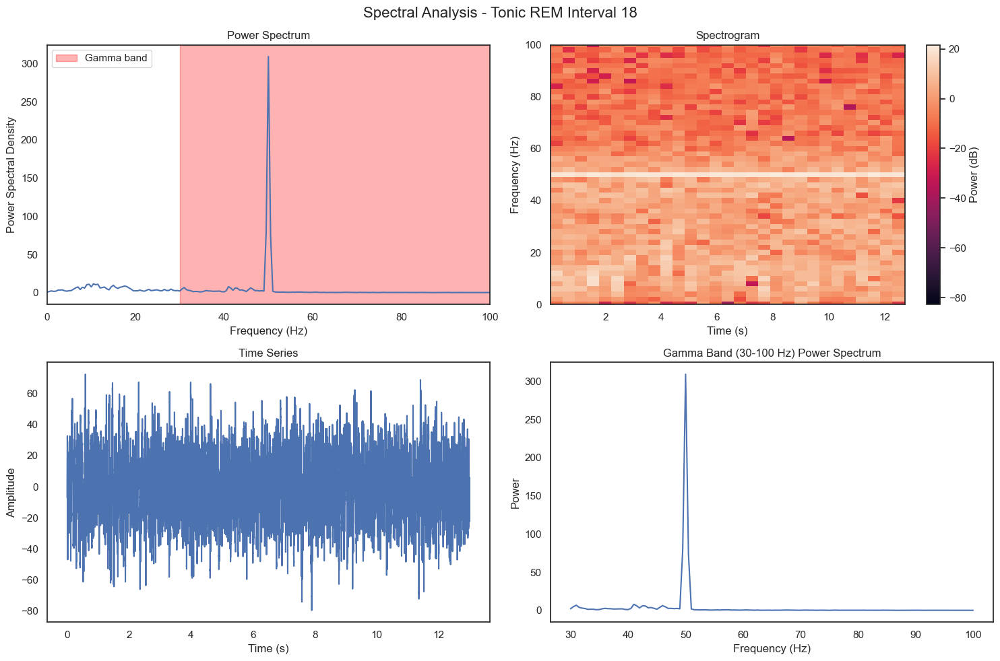


Tonic REM - Interval 19:
Number of IMF components: 11
  IMF-1: mean frequency = 579.25 Hz
  IMF-2: mean frequency = 257.47 Hz
  IMF-3: mean frequency = 63.42 Hz
  IMF-4: mean frequency = 26.18 Hz
  IMF-5: mean frequency = 9.83 Hz
  IMF-6: mean frequency = 4.04 Hz
  IMF-7: mean frequency = 1.51 Hz
  IMF-8: mean frequency = 0.47 Hz
  IMF-9: mean frequency = 0.17 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = 0.02 Hz
Fast components (>15Hz) signal length: 117500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 19
Peak frequency: 50.00 Hz
Total power: 494.1067
Gamma power (30-100 Hz): 335.9336
Gamma/total power ratio: 0.6799


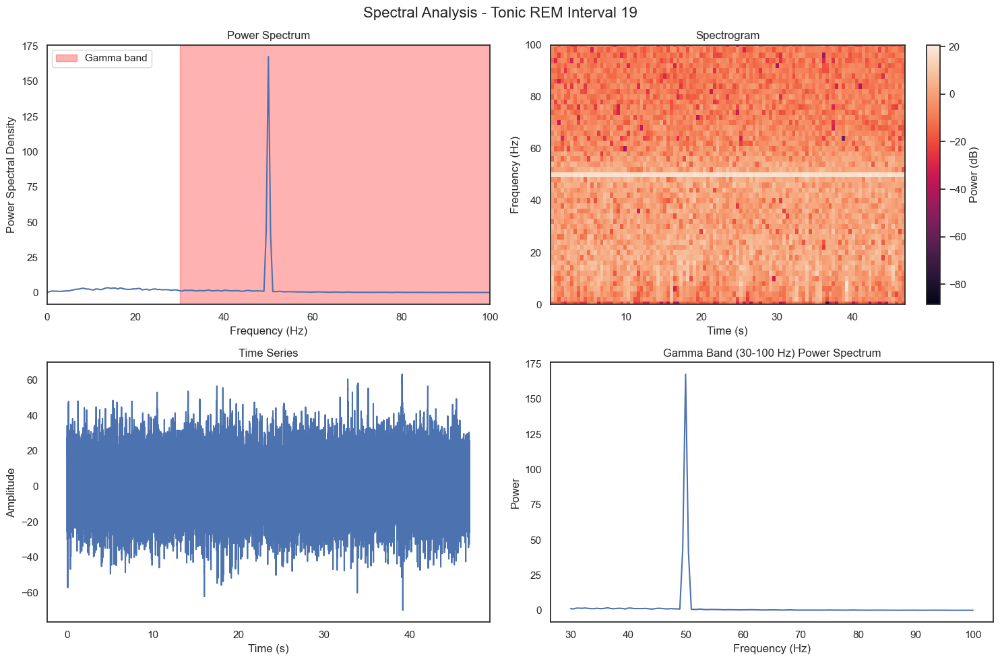


Tonic REM - Interval 20:
Number of IMF components: 12
  IMF-1: mean frequency = 578.21 Hz
  IMF-2: mean frequency = 253.28 Hz
  IMF-3: mean frequency = 63.92 Hz
  IMF-4: mean frequency = 25.68 Hz
  IMF-5: mean frequency = 9.57 Hz
  IMF-6: mean frequency = 3.86 Hz
  IMF-7: mean frequency = 1.58 Hz
  IMF-8: mean frequency = 0.48 Hz
  IMF-9: mean frequency = 0.20 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = 0.05 Hz
  IMF-12: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 194380 samples

SPECTRAL ANALYSIS: Tonic REM Interval 20
Peak frequency: 50.00 Hz
Total power: 578.2559
Gamma power (30-100 Hz): 352.0519
Gamma/total power ratio: 0.6088


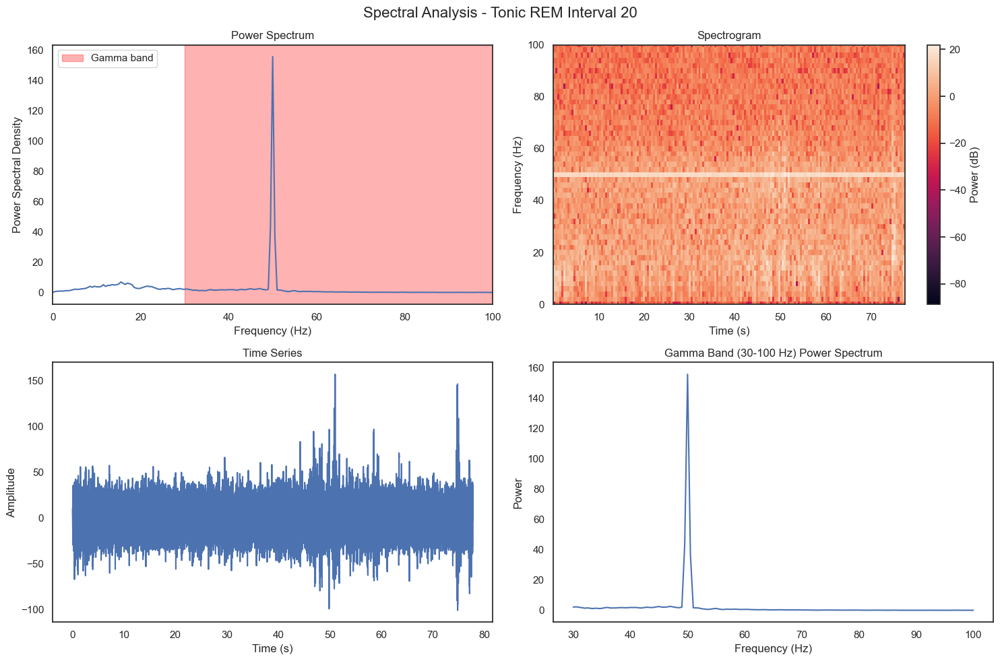


Tonic REM - Interval 21:
Number of IMF components: 13
  IMF-1: mean frequency = 591.51 Hz
  IMF-2: mean frequency = 261.85 Hz
  IMF-3: mean frequency = 65.21 Hz
  IMF-4: mean frequency = 26.74 Hz
  IMF-5: mean frequency = 9.96 Hz
  IMF-6: mean frequency = 4.04 Hz
  IMF-7: mean frequency = 1.62 Hz
  IMF-8: mean frequency = 0.47 Hz
  IMF-9: mean frequency = 0.21 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = 0.04 Hz
  IMF-12: mean frequency = 0.02 Hz
  IMF-13: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 321615 samples

SPECTRAL ANALYSIS: Tonic REM Interval 21
Peak frequency: 50.00 Hz
Total power: 998.9744
Gamma power (30-100 Hz): 597.9583
Gamma/total power ratio: 0.5986


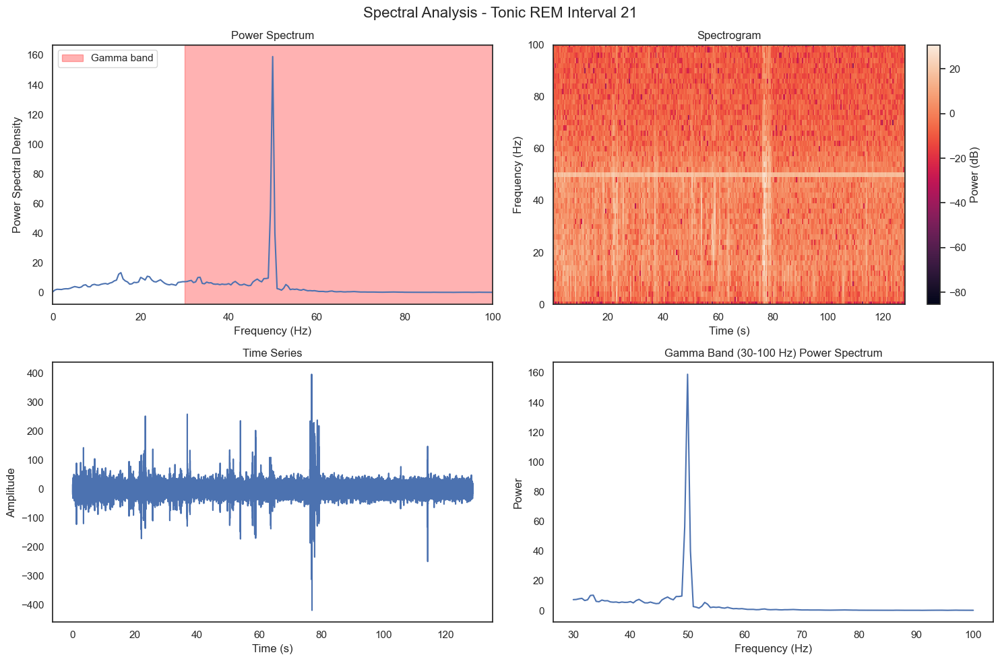


Tonic REM - Interval 22:
Number of IMF components: 9
  IMF-1: mean frequency = 580.30 Hz
  IMF-2: mean frequency = 258.38 Hz
  IMF-3: mean frequency = 63.18 Hz
  IMF-4: mean frequency = 25.36 Hz
  IMF-5: mean frequency = 9.77 Hz
  IMF-6: mean frequency = 4.18 Hz
  IMF-7: mean frequency = 1.19 Hz
  IMF-8: mean frequency = 0.60 Hz
  IMF-9: mean frequency = 0.19 Hz
Fast components (>15Hz) signal length: 12500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 22
Peak frequency: 50.00 Hz
Total power: 530.1097
Gamma power (30-100 Hz): 362.6095
Gamma/total power ratio: 0.6840


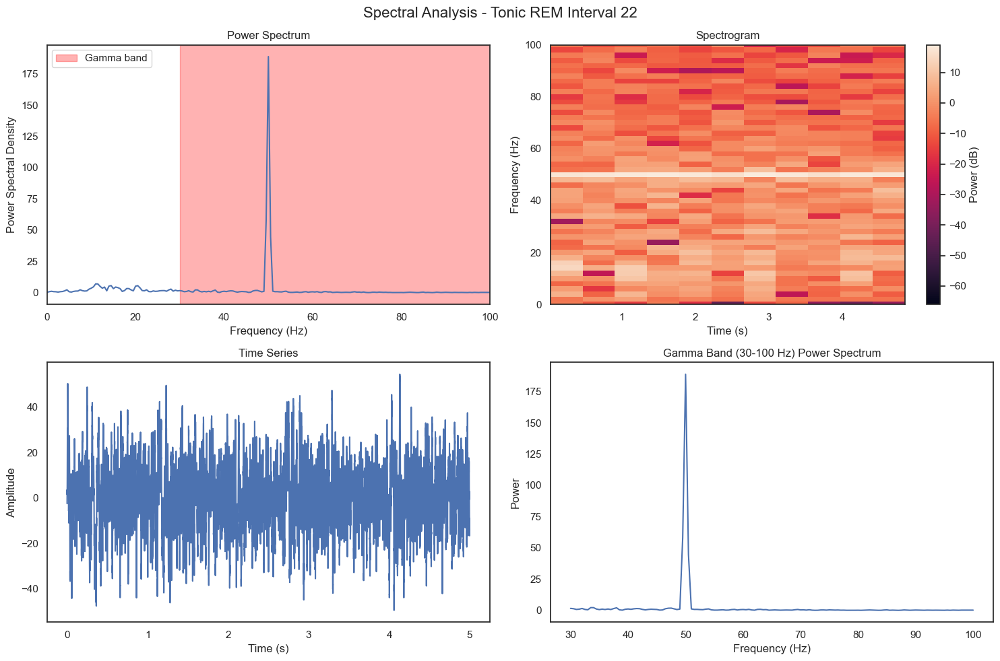


Tonic REM - Interval 23:
Number of IMF components: 10
  IMF-1: mean frequency = 579.20 Hz
  IMF-2: mean frequency = 254.81 Hz
  IMF-3: mean frequency = 63.96 Hz
  IMF-4: mean frequency = 26.14 Hz
  IMF-5: mean frequency = 9.62 Hz
  IMF-6: mean frequency = 3.72 Hz
  IMF-7: mean frequency = 1.24 Hz
  IMF-8: mean frequency = 0.38 Hz
  IMF-9: mean frequency = 0.17 Hz
  IMF-10: mean frequency = 0.07 Hz
Fast components (>15Hz) signal length: 72500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 23
Peak frequency: 50.00 Hz
Total power: 455.0980
Gamma power (30-100 Hz): 292.9864
Gamma/total power ratio: 0.6438


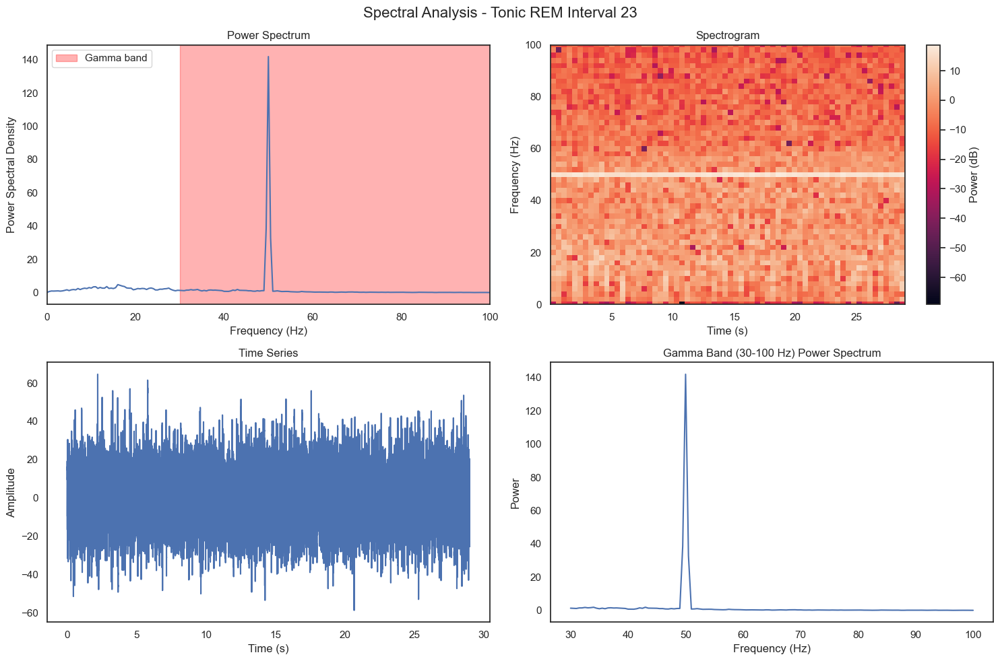


Tonic REM - Interval 24:
Number of IMF components: 11
  IMF-1: mean frequency = 579.45 Hz
  IMF-2: mean frequency = 254.76 Hz
  IMF-3: mean frequency = 58.18 Hz
  IMF-4: mean frequency = 23.13 Hz
  IMF-5: mean frequency = 8.95 Hz
  IMF-6: mean frequency = 3.63 Hz
  IMF-7: mean frequency = 1.45 Hz
  IMF-8: mean frequency = 0.41 Hz
  IMF-9: mean frequency = 0.18 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = 0.04 Hz
Fast components (>15Hz) signal length: 55000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 24
Peak frequency: 50.00 Hz
Total power: 821.1418
Gamma power (30-100 Hz): 503.0369
Gamma/total power ratio: 0.6126


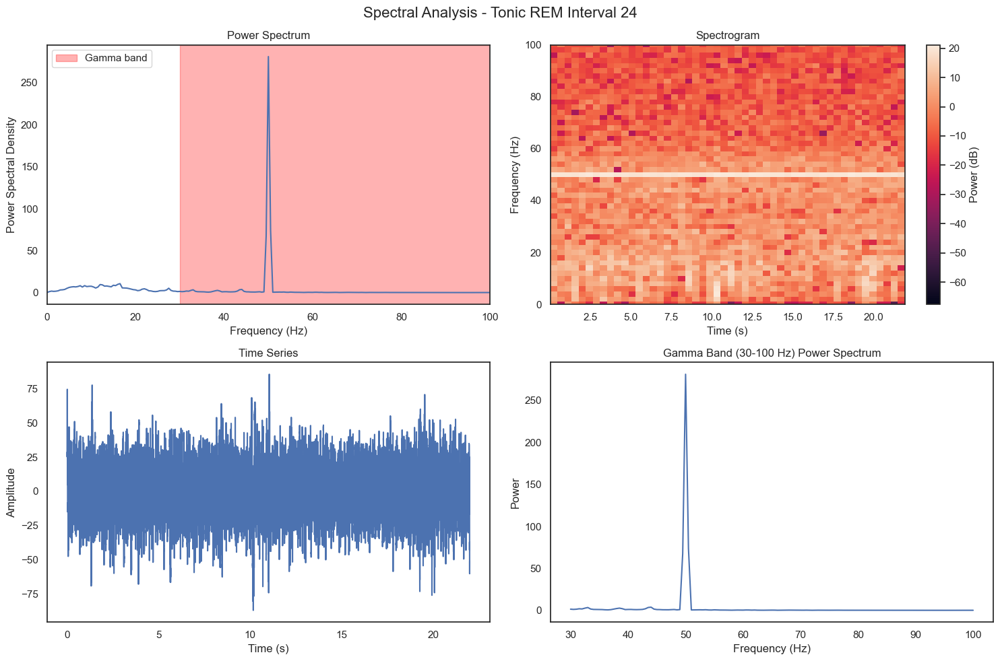


Tonic REM - Interval 25:
Number of IMF components: 13
  IMF-1: mean frequency = 584.94 Hz
  IMF-2: mean frequency = 260.59 Hz
  IMF-3: mean frequency = 76.05 Hz
  IMF-4: mean frequency = 31.62 Hz
  IMF-5: mean frequency = 11.49 Hz
  IMF-6: mean frequency = 4.67 Hz
  IMF-7: mean frequency = 1.87 Hz
  IMF-8: mean frequency = 0.66 Hz
  IMF-9: mean frequency = 0.28 Hz
  IMF-10: mean frequency = 0.13 Hz
  IMF-11: mean frequency = 0.07 Hz
  IMF-12: mean frequency = 0.03 Hz
  IMF-13: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 190000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 25
Peak frequency: 50.00 Hz
Total power: 361.1115
Gamma power (30-100 Hz): 216.0928
Gamma/total power ratio: 0.5984


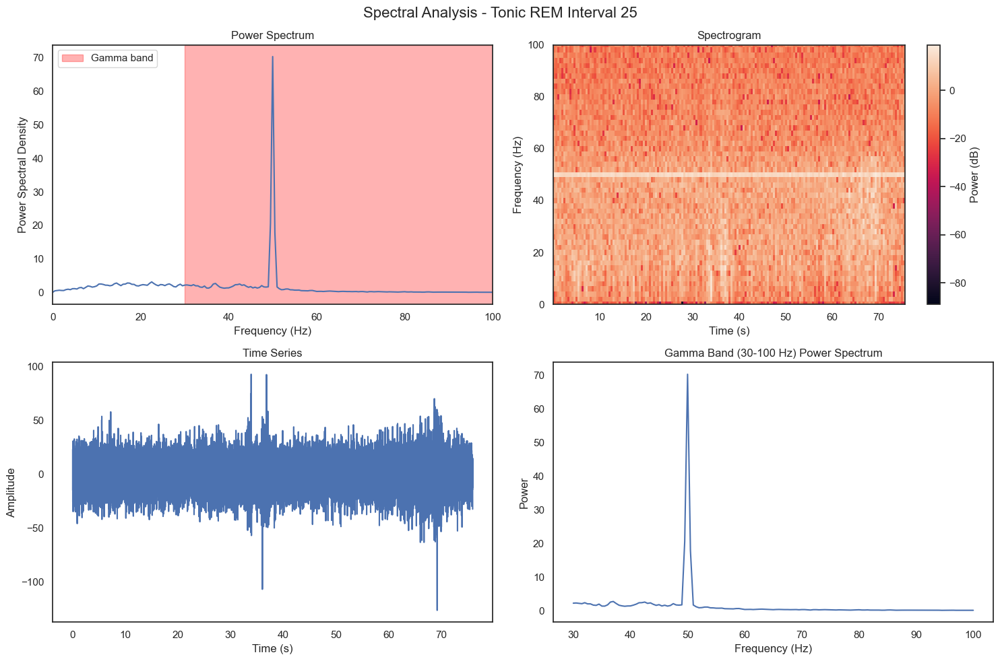


Tonic REM - Interval 26:
Number of IMF components: 12
  IMF-1: mean frequency = 591.90 Hz
  IMF-2: mean frequency = 265.70 Hz
  IMF-3: mean frequency = 57.99 Hz
  IMF-4: mean frequency = 25.07 Hz
  IMF-5: mean frequency = 9.46 Hz
  IMF-6: mean frequency = 3.75 Hz
  IMF-7: mean frequency = 1.44 Hz
  IMF-8: mean frequency = 0.40 Hz
  IMF-9: mean frequency = 0.18 Hz
  IMF-10: mean frequency = 0.08 Hz
  IMF-11: mean frequency = 0.04 Hz
  IMF-12: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 232500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 26
Peak frequency: 50.00 Hz
Total power: 1401.8629
Gamma power (30-100 Hz): 657.5135
Gamma/total power ratio: 0.4690


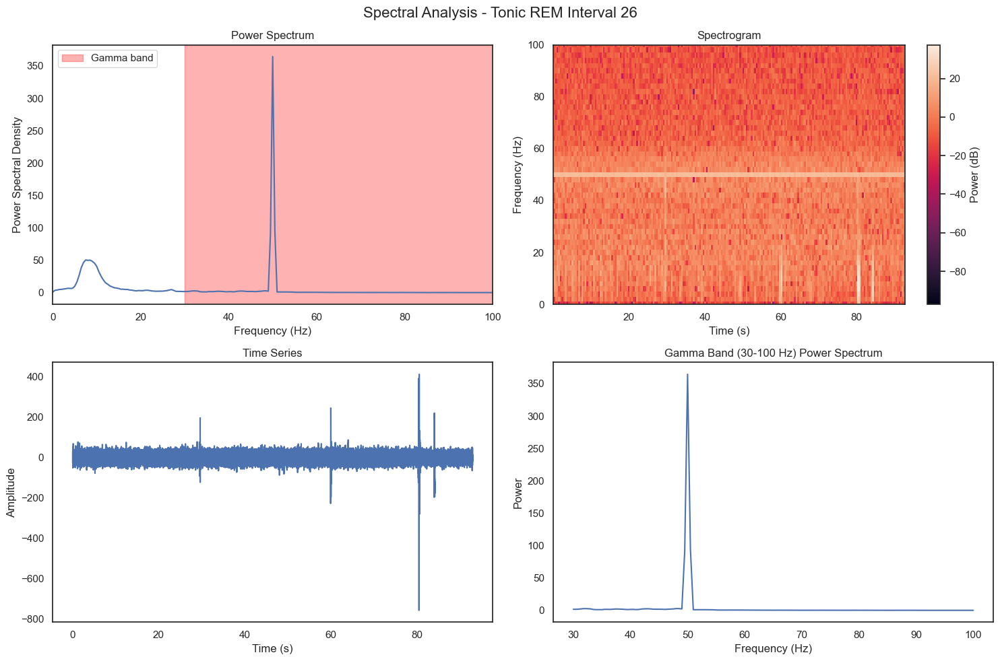


Tonic REM - Interval 27:
Number of IMF components: 13
  IMF-1: mean frequency = 575.13 Hz
  IMF-2: mean frequency = 252.16 Hz
  IMF-3: mean frequency = 60.16 Hz
  IMF-4: mean frequency = 25.20 Hz
  IMF-5: mean frequency = 9.36 Hz
  IMF-6: mean frequency = 3.65 Hz
  IMF-7: mean frequency = 1.44 Hz
  IMF-8: mean frequency = 0.50 Hz
  IMF-9: mean frequency = 0.22 Hz
  IMF-10: mean frequency = 0.11 Hz
  IMF-11: mean frequency = 0.05 Hz
  IMF-12: mean frequency = 0.02 Hz
  IMF-13: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 305000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 27
Peak frequency: 50.00 Hz
Total power: 731.8316
Gamma power (30-100 Hz): 495.6210
Gamma/total power ratio: 0.6772


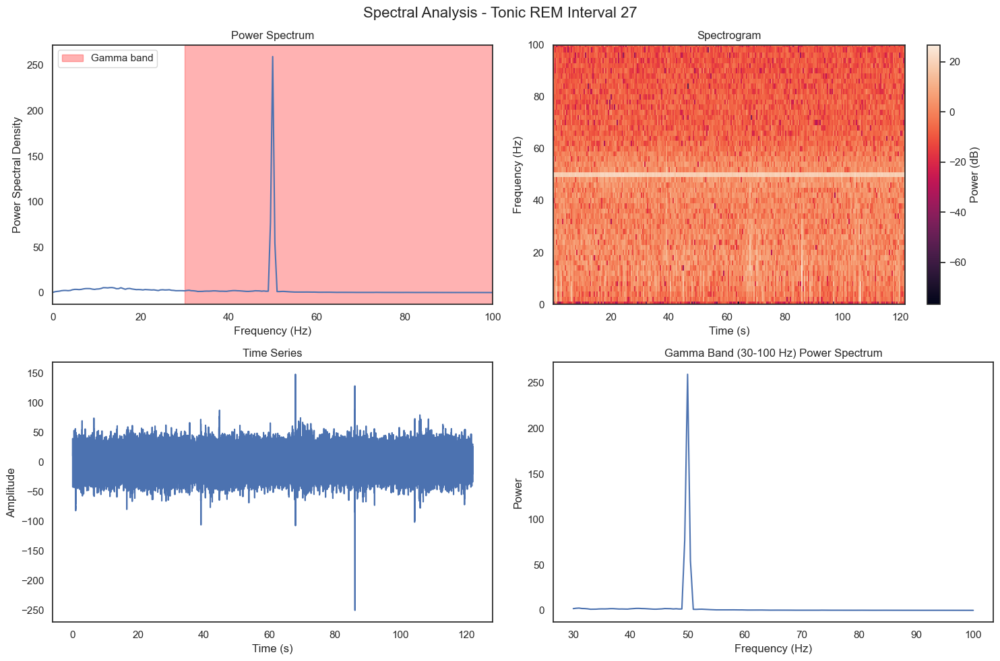


Tonic REM - Interval 28:
Number of IMF components: 10
  IMF-1: mean frequency = 578.80 Hz
  IMF-2: mean frequency = 250.23 Hz
  IMF-3: mean frequency = 59.98 Hz
  IMF-4: mean frequency = 22.49 Hz
  IMF-5: mean frequency = 8.34 Hz
  IMF-6: mean frequency = 3.16 Hz
  IMF-7: mean frequency = 1.17 Hz
  IMF-8: mean frequency = 0.41 Hz
  IMF-9: mean frequency = 0.16 Hz
  IMF-10: mean frequency = 0.08 Hz
Fast components (>15Hz) signal length: 30000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 28
Peak frequency: 50.00 Hz
Total power: 715.9345
Gamma power (30-100 Hz): 363.0039
Gamma/total power ratio: 0.5070


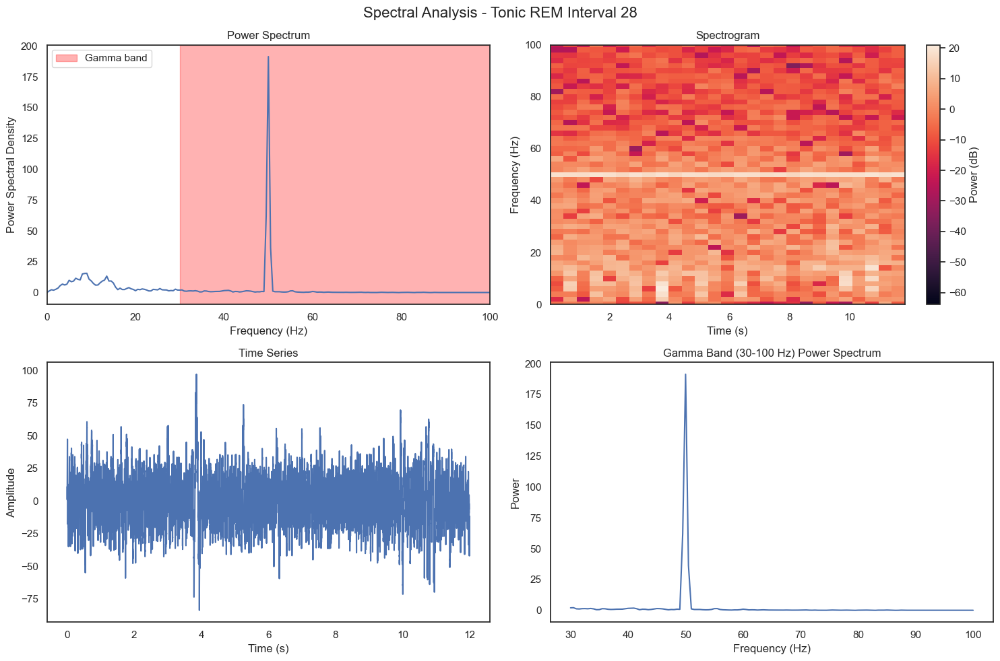


Tonic REM - Interval 29:
Number of IMF components: 13
  IMF-1: mean frequency = 579.07 Hz
  IMF-2: mean frequency = 257.03 Hz
  IMF-3: mean frequency = 64.92 Hz
  IMF-4: mean frequency = 27.88 Hz
  IMF-5: mean frequency = 9.64 Hz
  IMF-6: mean frequency = 3.70 Hz
  IMF-7: mean frequency = 1.43 Hz
  IMF-8: mean frequency = 0.54 Hz
  IMF-9: mean frequency = 0.23 Hz
  IMF-10: mean frequency = 0.11 Hz
  IMF-11: mean frequency = 0.04 Hz
  IMF-12: mean frequency = 0.02 Hz
  IMF-13: mean frequency = 0.01 Hz
Fast components (>15Hz) signal length: 275000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 29
Peak frequency: 50.00 Hz
Total power: 719.9694
Gamma power (30-100 Hz): 393.0269
Gamma/total power ratio: 0.5459


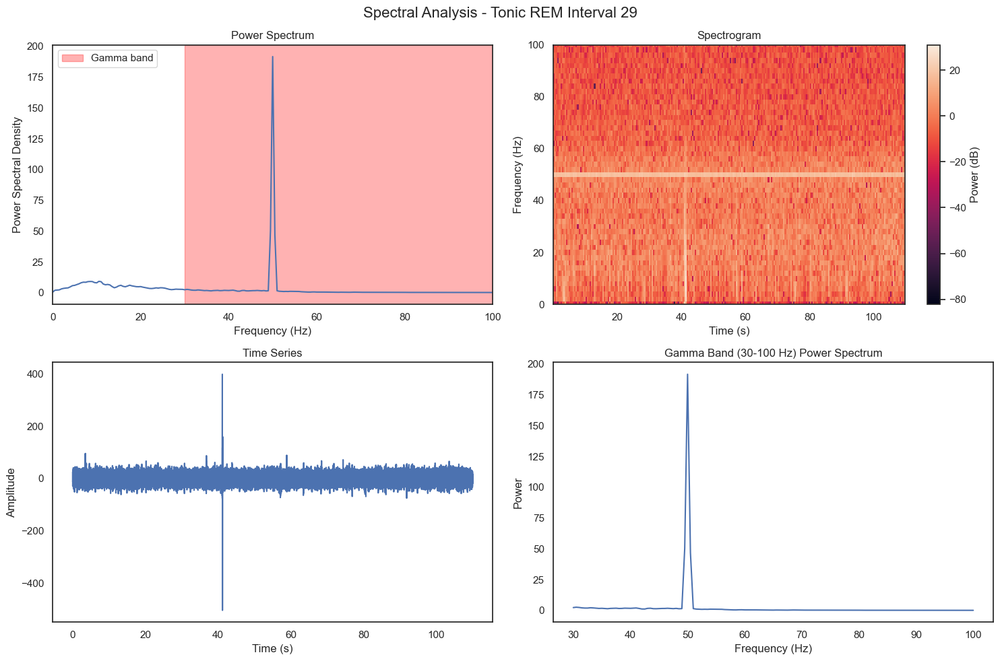

In [33]:
# Cell 7: Analyze tonic REM intervals  
print("\nANALYZING TONIC REM INTERVALS")
tonic_fast_signals, tonic_spectral_results = analyze_all_intervals(
    tonic_imfs_default, tonic_imfs_freqs_default, tonic_rem_lpf_default, "Tonic REM")

In [34]:
# Cell 8: Comparative analysis function
def comparative_analysis(phasic_results, tonic_results):
    """
    Compare spectral properties between phasic and tonic REM
    """
    if not phasic_results or not tonic_results:
        print("Not enough data for comparative analysis")
        return
    
    # Extract key metrics
    phasic_peak_freqs = [r['peak_frequency'] for r in phasic_results]
    tonic_peak_freqs = [r['peak_frequency'] for r in tonic_results]
    
    phasic_gamma_ratios = [r['gamma_ratio'] for r in phasic_results]
    tonic_gamma_ratios = [r['gamma_ratio'] for r in tonic_results]
    
    # Statistical comparison
    from scipy import stats
    
    print("\n" + "="*60)
    print("COMPARATIVE ANALYSIS: Phasic vs Tonic REM")
    print("="*60)
    
    # Peak frequency comparison
    if len(phasic_peak_freqs) > 1 and len(tonic_peak_freqs) > 1:
        t_stat, p_value = stats.ttest_ind(phasic_peak_freqs, tonic_peak_freqs)
        print(f"Peak frequency - Phasic: {np.mean(phasic_peak_freqs):.2f} Hz, "
              f"Tonic: {np.mean(tonic_peak_freqs):.2f} Hz")
        print(f"T-test: t={t_stat:.3f}, p={p_value:.3f}")
    
    # Gamma ratio comparison
    if len(phasic_gamma_ratios) > 1 and len(tonic_gamma_ratios) > 1:
        t_stat, p_value = stats.ttest_ind(phasic_gamma_ratios, tonic_gamma_ratios)
        print(f"Gamma ratio - Phasic: {np.mean(phasic_gamma_ratios):.4f}, "
              f"Tonic: {np.mean(tonic_gamma_ratios):.4f}")
        print(f"T-test: t={t_stat:.3f}, p={p_value:.3f}")
    
    # Plot comparative distributions
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Peak frequency distribution
    axes[0].boxplot([phasic_peak_freqs, tonic_peak_freqs], labels=['Phasic', 'Tonic'])
    axes[0].set_ylabel('Peak Frequency (Hz)')
    axes[0].set_title('Peak Frequency Distribution')
    
    # Gamma ratio distribution
    axes[1].boxplot([phasic_gamma_ratios, tonic_gamma_ratios], labels=['Phasic', 'Tonic'])
    axes[1].set_ylabel('Gamma/Total Power Ratio')
    axes[1].set_title('Gamma Power Ratio Distribution')
    
    plt.tight_layout()
    plt.show()


COMPARATIVE ANALYSIS: Phasic vs Tonic REM
Peak frequency - Phasic: 42.18 Hz, Tonic: 47.26 Hz
T-test: t=-1.147, p=0.259
Gamma ratio - Phasic: 0.3762, Tonic: 0.5697
T-test: t=-3.671, p=0.001


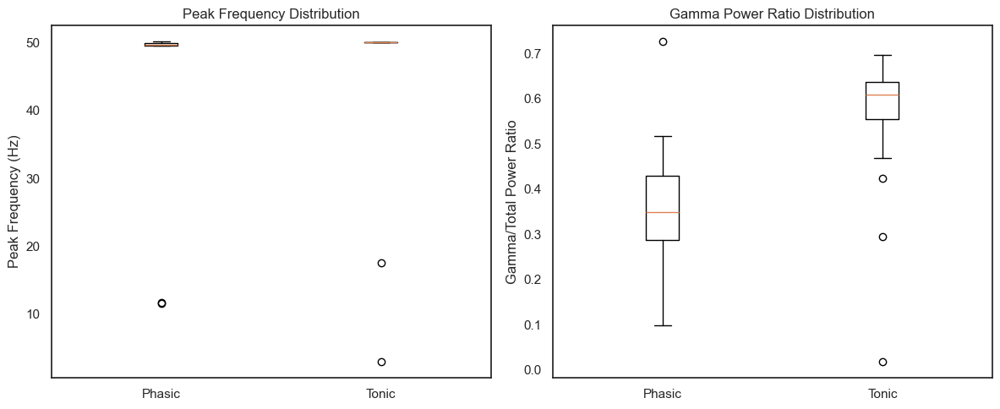

In [35]:
# Cell 9: Perform comparative analysis
comparative_analysis(phasic_spectral_results, tonic_spectral_results)

In [36]:
# Cell 10: Summary statistics
def print_summary_statistics(phasic_signals, tonic_signals, phasic_results, tonic_results):
    """
    Print summary statistics for the analysis
    """
    print("\n" + "="*60)
    print("SUMMARY STATISTICS")
    print("="*60)
    
    print(f"Phasic REM intervals analyzed: {len(phasic_signals)}")
    print(f"Tonic REM intervals analyzed: {len(tonic_signals)}")
    
    if phasic_results:
        avg_phasic_gamma = np.mean([r['gamma_ratio'] for r in phasic_results])
        print(f"Average gamma ratio (Phasic): {avg_phasic_gamma:.4f}")
    
    if tonic_results:
        avg_tonic_gamma = np.mean([r['gamma_ratio'] for r in tonic_results])
        print(f"Average gamma ratio (Tonic): {avg_tonic_gamma:.4f}")

print_summary_statistics(phasic_fast_signals, tonic_fast_signals, 
                        phasic_spectral_results, tonic_spectral_results)


SUMMARY STATISTICS
Phasic REM intervals analyzed: 10
Tonic REM intervals analyzed: 29
Average gamma ratio (Phasic): 0.3762
Average gamma ratio (Tonic): 0.5697


In [37]:
# Check cell: Verify your data is loaded
print(f"LFP shape: {lfpPFC.shape}")
print(f"Sampling rate: {fs} Hz")
print(f"Phasic intervals: {len(phasic_interval)}")
print(f"Tonic intervals: {len(tonic_interval)}")
print(f"Hypnogram unique states: {np.unique(hypno)}")

LFP shape: (27037838,)
Sampling rate: 2500 Hz
Phasic intervals: 10
Tonic intervals: 29
Hypnogram unique states: [1 3 4 5]


In [38]:
#-------- using EMD again for spectral analysis

In [39]:
# Cell 1: Modified EMD function with default settings
def extract_imfs_default(lfp, fs, interval, return_imfs_freqs=False):
    all_imfs = []
    all_imf_freqs = []
    rem_lfp = []
    
    for ii in range(len(interval)):
        start_idx = int(interval.loc[ii, 'start'] * fs)
        end_idx = int(interval.loc[ii, 'end'] * fs)
        sig_part = lfp[start_idx:end_idx]
        sig = np.array(sig_part)

        rem_lfp.append(sig)

        try:
            # Use default EMD settings instead of config
            imf = emd.sift.sift(sig)  # Default EMD
        except Exception as e:
            print(f"EMD failed: {e}. Skipping this interval.")
            continue
            
        all_imfs.append(imf)
        
        # Calculate IMF frequencies using Hilbert transform (proper EMD way)
        IP, IF, IA = emd.spectra.frequency_transform(imf, fs, 'hilbert')
        all_imf_freqs.append(IF)  # Instantaneous frequency

    if return_imfs_freqs:
        return all_imfs, all_imf_freqs, rem_lfp
    else:
        return all_imfs

In [40]:
# Cell 2: Extract IMFs using default EMD settings
tonic_imfs_default, tonic_imfs_freqs_default, tonic_rem_lpf_default = extract_imfs_default(
    lfp, fs, tonic_interval, return_imfs_freqs=True)
phasic_imfs_default, phasic_imfs_freqs_default, phasic_rem_lpf_default = extract_imfs_default(
    lfp, fs, phasic_interval, return_imfs_freqs=True)

print(f"Phasic intervals processed: {len(phasic_imfs_default)}")
print(f"Tonic intervals processed: {len(tonic_imfs_default)}")

Phasic intervals processed: 10
Tonic intervals processed: 29


In [41]:
# Cell 3: Function to sum components faster than 15Hz using instantaneous frequency
def sum_fast_components(imf, instantaneous_freq, threshold_freq=15):
    """
    Sum IMF components that have mean instantaneous frequency faster than threshold_freq
    """
    fast_components_sum = np.zeros_like(imf[:, 0])
    
    for comp_idx in range(imf.shape[1]):
        mean_freq = np.mean(instantaneous_freq[:, comp_idx])
        if mean_freq > threshold_freq:
            fast_components_sum += imf[:, comp_idx]
    
    return fast_components_sum

In [42]:
# Cell 4: Proper EMD spectral analysis using Hilbert-Huang Transform
def perform_emd_spectral_analysis(imf, instantaneous_freq, instantaneous_amp, fs, condition_name):
    """
    Perform proper EMD-based spectral analysis using Hilbert Transform
    """
    print(f"\n{'='*60}")
    print(f"HILBERT-HUANG SPECTRAL ANALYSIS: {condition_name}")
    print(f"{'='*60}")
    
    # 1. Create Hilbert Spectrum
    freq_edges = np.arange(15, 101, 5)  # 15-100 Hz in 5 Hz bins
    hilbert_spectrum, _, _ = emd.spectra.hilberthuang(instantaneous_freq, instantaneous_amp, 
                                                     freq_edges, sample_rate=fs)
    
    # 2. Calculate mean frequency properties for each component
    print("IMF Frequency Analysis:")
    for comp_idx in range(imf.shape[1]):
        comp_freq = instantaneous_freq[:, comp_idx]
        comp_amp = instantaneous_amp[:, comp_idx]
        
        # Remove outliers (frequencies > 200 Hz are likely artifacts)
        valid_mask = comp_freq < 200
        mean_freq = np.mean(comp_freq[valid_mask])
        mean_amp = np.mean(comp_amp[valid_mask])
        
        print(f"  IMF-{comp_idx+1}: {mean_freq:.1f} Hz, amplitude: {mean_amp:.3f}")
    
    # 3. Focus on gamma band (30-100 Hz)
    gamma_mask = (freq_edges[:-1] >= 30) & (freq_edges[:-1] <= 100)
    gamma_power = np.sum(hilbert_spectrum[:, gamma_mask])
    total_power = np.sum(hilbert_spectrum)
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    print(f"\nGamma Band (30-100 Hz) Analysis:")
    print(f"Total power: {total_power:.4f}")
    print(f"Gamma power: {gamma_power:.4f}")
    print(f"Gamma/total power ratio: {gamma_ratio:.4f}")
    
    # 4. Plotting
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle(f'Hilbert-Huang Analysis - {condition_name}', fontsize=16)
    
    # Hilbert Spectrum
    im = axes[0,0].imshow(hilbert_spectrum.T, aspect='auto', origin='lower',
                         extent=[0, hilbert_spectrum.shape[0]/fs, freq_edges[0], freq_edges[-1]],
                         cmap='hot')
    axes[0,0].set_xlabel('Time (s)')
    axes[0,0].set_ylabel('Frequency (Hz)')
    axes[0,0].set_title('Hilbert Spectrum')
    plt.colorbar(im, ax=axes[0,0], label='Amplitude')
    
    # Marginal frequency distribution
    freq_power = np.sum(hilbert_spectrum, axis=0)
    axes[0,1].plot(freq_edges[:-1], freq_power)
    axes[0,1].set_xlabel('Frequency (Hz)')
    axes[0,1].set_ylabel('Power')
    axes[0,1].set_title('Marginal Spectrum')
    axes[0,1].axvspan(30, 100, alpha=0.3, color='red', label='Gamma band')
    axes[0,1].legend()
    
    # Instantaneous frequency of fastest component
    time_axis = np.arange(imf.shape[0]) / fs
    fastest_comp = np.argmax(np.mean(instantaneous_freq, axis=0))
    axes[1,0].plot(time_axis, instantaneous_freq[:, fastest_comp])
    axes[1,0].set_xlabel('Time (s)')
    axes[1,0].set_ylabel('Frequency (Hz)')
    axes[1,0].set_title(f'Instantaneous Frequency (IMF-{fastest_comp+1})')
    axes[1,0].set_ylim(0, 100)
    
    # Gamma band power over time
    gamma_power_time = np.sum(hilbert_spectrum[:, gamma_mask], axis=1)
    axes[1,1].plot(time_axis, gamma_power_time)
    axes[1,1].set_xlabel('Time (s)')
    axes[1,1].set_ylabel('Gamma Power')
    axes[1,1].set_title('Gamma Band Power Over Time')
    
    plt.tight_layout()
    plt.show()
    
    return {
        'hilbert_spectrum': hilbert_spectrum,
        'freq_edges': freq_edges,
        'instantaneous_freq': instantaneous_freq,
        'instantaneous_amp': instantaneous_amp,
        'gamma_ratio': gamma_ratio,
        'total_power': total_power,
        'gamma_power': gamma_power
    }

In [43]:
# Cell 5: Function to analyze all intervals with proper EMD spectral analysis
def analyze_all_intervals_hht(imfs_list, imf_freqs_list, rem_lfp_list, condition_name, fs=2500):
    """
    Analyze all intervals using Hilbert-Huang Transform
    """
    all_fast_signals = []
    spectral_results = []
    
    for idx, (imf, instantaneous_freq, original_lfp) in enumerate(zip(imfs_list, imf_freqs_list, rem_lfp_list)):
        print(f"\n{condition_name} - Interval {idx+1}:")
        print(f"Number of IMF components: {imf.shape[1]}")
        
        # Calculate instantaneous amplitude
        instantaneous_amp = np.abs(hilbert(imf, axis=0))
        
        # Sum components faster than 15Hz
        fast_signal = sum_fast_components(imf, instantaneous_freq, threshold_freq=15)
        all_fast_signals.append(fast_signal)
        
        # Perform proper EMD spectral analysis
        if imf.shape[0] > 10:  # Minimum length requirement
            result = perform_emd_spectral_analysis(imf, instantaneous_freq, instantaneous_amp, fs, 
                                                 f"{condition_name} Interval {idx+1}")
            spectral_results.append(result)
        else:
            print("Signal too short for spectral analysis")
    
    return all_fast_signals, spectral_results

ANALYZING PHASIC REM INTERVALS

Phasic REM - Interval 1:
Number of IMF components: 7
  IMF-1: mean frequency = 48.07 Hz
  IMF-2: mean frequency = 48.07 Hz
  IMF-3: mean frequency = 96.75 Hz
  IMF-4: mean frequency = 128.62 Hz
  IMF-5: mean frequency = 105.41 Hz
  IMF-6: mean frequency = 82.65 Hz
  IMF-7: mean frequency = 64.04 Hz
Fast components (>15Hz) signal length: 2575 samples

SPECTRAL ANALYSIS: Phasic REM Interval 1
Peak frequency: 11.65 Hz
Total power: 3625.5035
Gamma power (30-100 Hz): 355.7334
Gamma/total power ratio: 0.0981


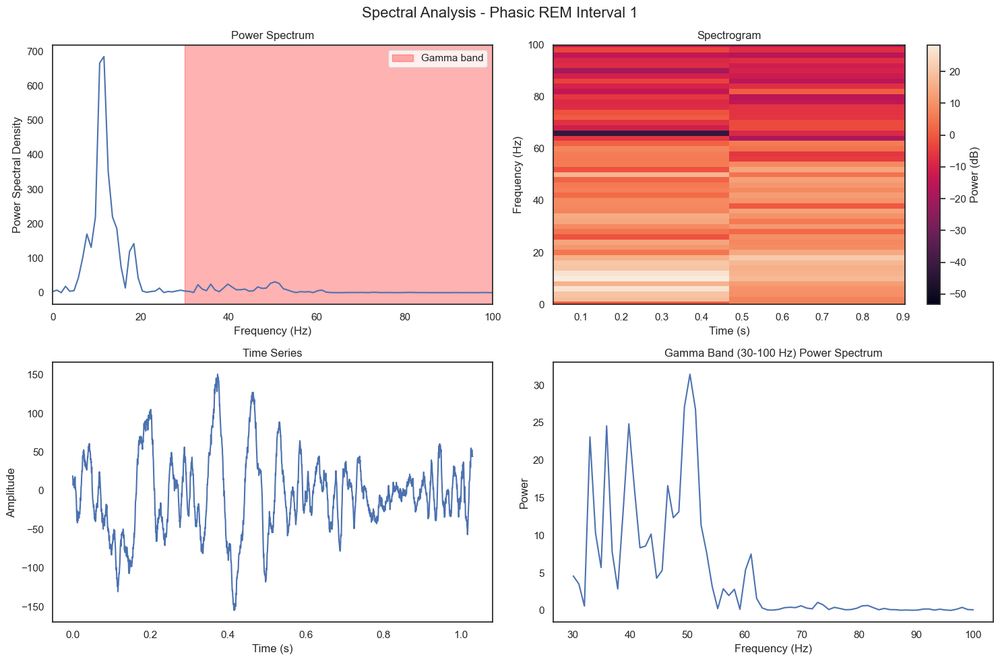


Phasic REM - Interval 2:
Number of IMF components: 8
  IMF-1: mean frequency = 27.58 Hz
  IMF-2: mean frequency = 27.58 Hz
  IMF-3: mean frequency = 8.90 Hz
  IMF-4: mean frequency = 22.48 Hz
  IMF-5: mean frequency = 45.78 Hz
  IMF-6: mean frequency = 46.04 Hz
  IMF-7: mean frequency = 40.03 Hz
  IMF-8: mean frequency = 133.27 Hz
Fast components (>15Hz) signal length: 3690 samples

SPECTRAL ANALYSIS: Phasic REM Interval 2
Peak frequency: 50.14 Hz
Total power: 778.2974
Gamma power (30-100 Hz): 335.8441
Gamma/total power ratio: 0.4315


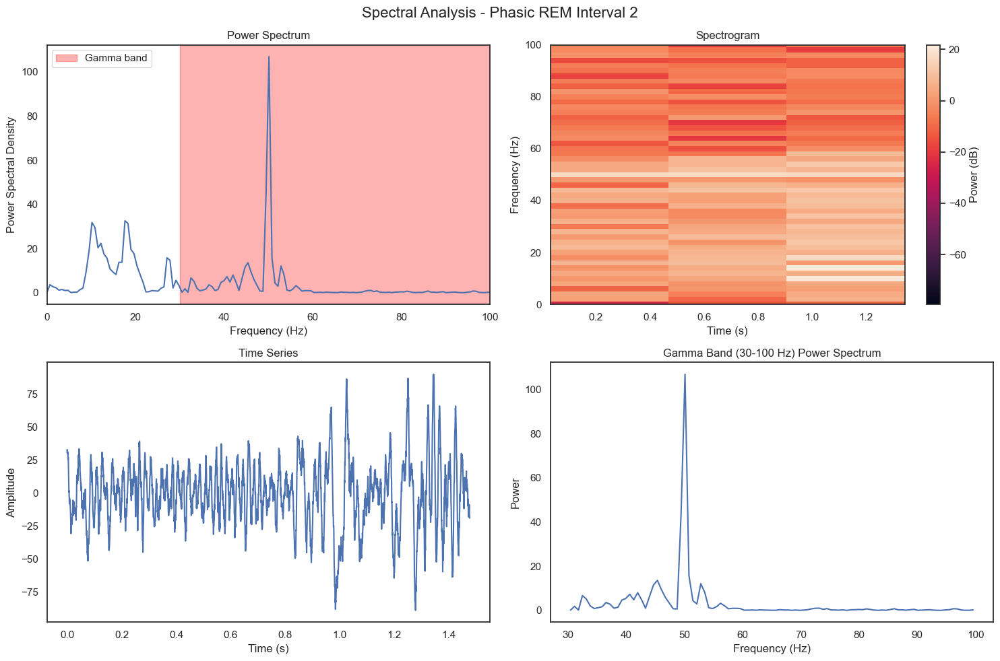


Phasic REM - Interval 3:
Number of IMF components: 7
  IMF-1: mean frequency = 67.71 Hz
  IMF-2: mean frequency = 67.71 Hz
  IMF-3: mean frequency = 107.93 Hz
  IMF-4: mean frequency = 170.19 Hz
  IMF-5: mean frequency = 154.46 Hz
  IMF-6: mean frequency = 116.46 Hz
  IMF-7: mean frequency = 117.69 Hz
Fast components (>15Hz) signal length: 3015 samples

SPECTRAL ANALYSIS: Phasic REM Interval 3
Peak frequency: 49.75 Hz
Total power: 612.4208
Gamma power (30-100 Hz): 259.5278
Gamma/total power ratio: 0.4238


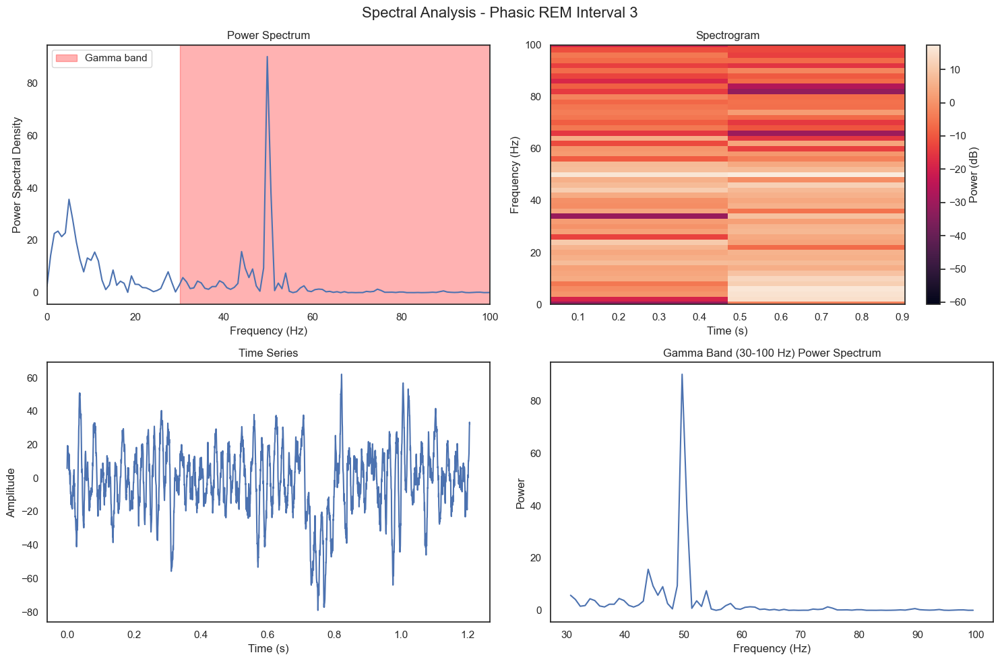


Phasic REM - Interval 4:
Number of IMF components: 7
  IMF-1: mean frequency = 136.58 Hz
  IMF-2: mean frequency = 136.58 Hz
  IMF-3: mean frequency = 155.88 Hz
  IMF-4: mean frequency = 99.30 Hz
  IMF-5: mean frequency = 91.41 Hz
  IMF-6: mean frequency = 114.35 Hz
  IMF-7: mean frequency = 163.82 Hz
Fast components (>15Hz) signal length: 2375 samples

SPECTRAL ANALYSIS: Phasic REM Interval 4
Peak frequency: 11.58 Hz
Total power: 1014.1816
Gamma power (30-100 Hz): 334.5862
Gamma/total power ratio: 0.3299


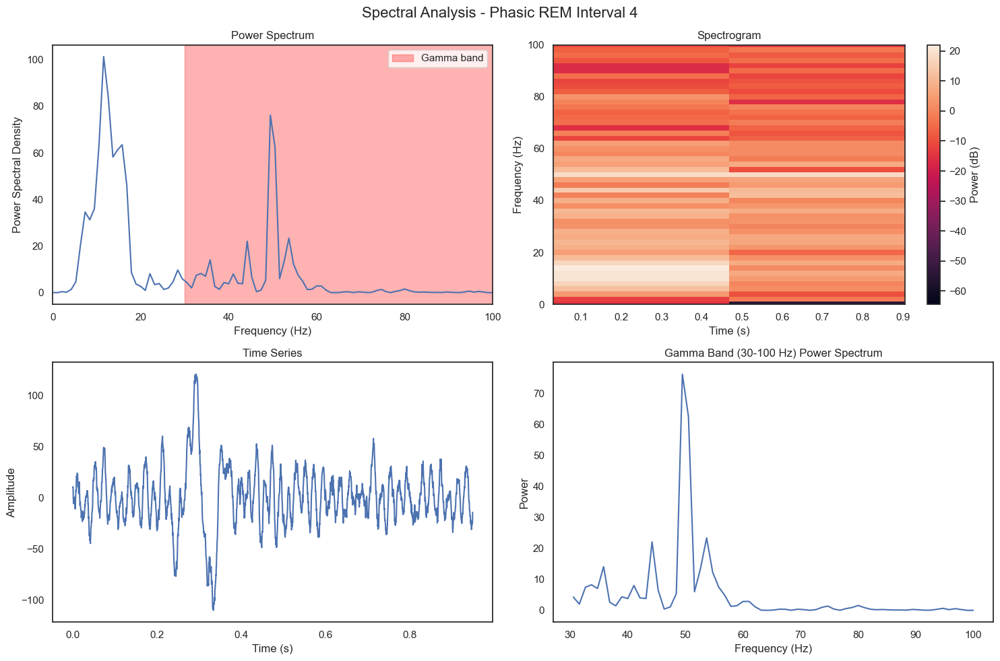


Phasic REM - Interval 5:
Number of IMF components: 7
  IMF-1: mean frequency = 152.39 Hz
  IMF-2: mean frequency = 152.39 Hz
  IMF-3: mean frequency = 102.53 Hz
  IMF-4: mean frequency = 100.95 Hz
  IMF-5: mean frequency = 121.46 Hz
  IMF-6: mean frequency = 97.61 Hz
  IMF-7: mean frequency = 95.17 Hz
Fast components (>15Hz) signal length: 2715 samples

SPECTRAL ANALYSIS: Phasic REM Interval 5
Peak frequency: 49.72 Hz
Total power: 606.9717
Gamma power (30-100 Hz): 314.5285
Gamma/total power ratio: 0.5182


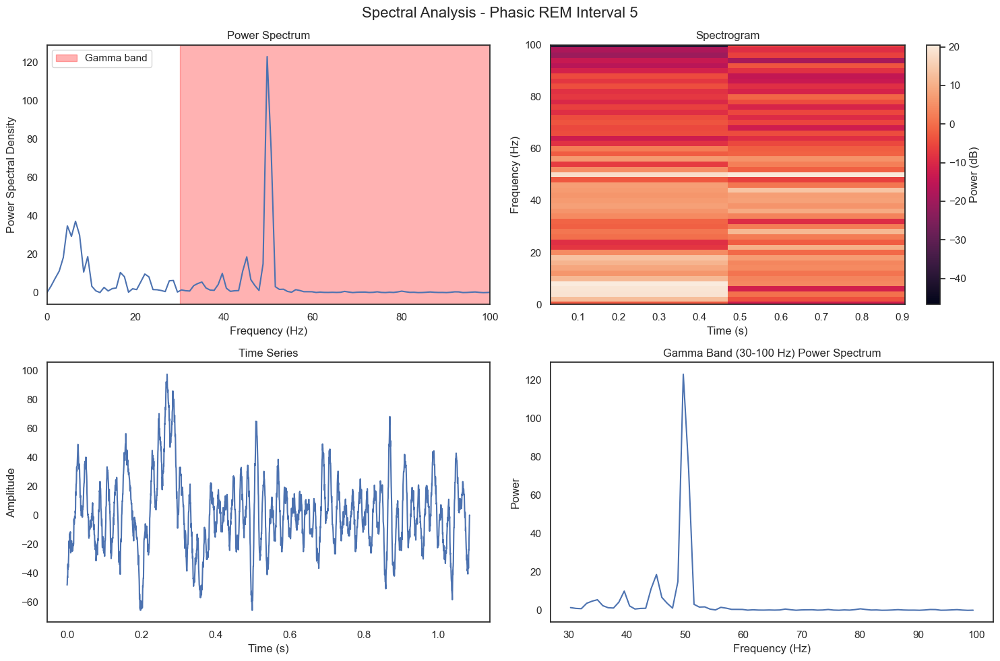


Phasic REM - Interval 6:
Number of IMF components: 7
  IMF-1: mean frequency = 157.99 Hz
  IMF-2: mean frequency = 157.99 Hz
  IMF-3: mean frequency = 146.12 Hz
  IMF-4: mean frequency = 133.61 Hz
  IMF-5: mean frequency = 144.04 Hz
  IMF-6: mean frequency = 183.27 Hz
  IMF-7: mean frequency = 179.23 Hz
Fast components (>15Hz) signal length: 3005 samples

SPECTRAL ANALYSIS: Phasic REM Interval 6
Peak frequency: 49.92 Hz
Total power: 1149.8241
Gamma power (30-100 Hz): 373.7786
Gamma/total power ratio: 0.3251


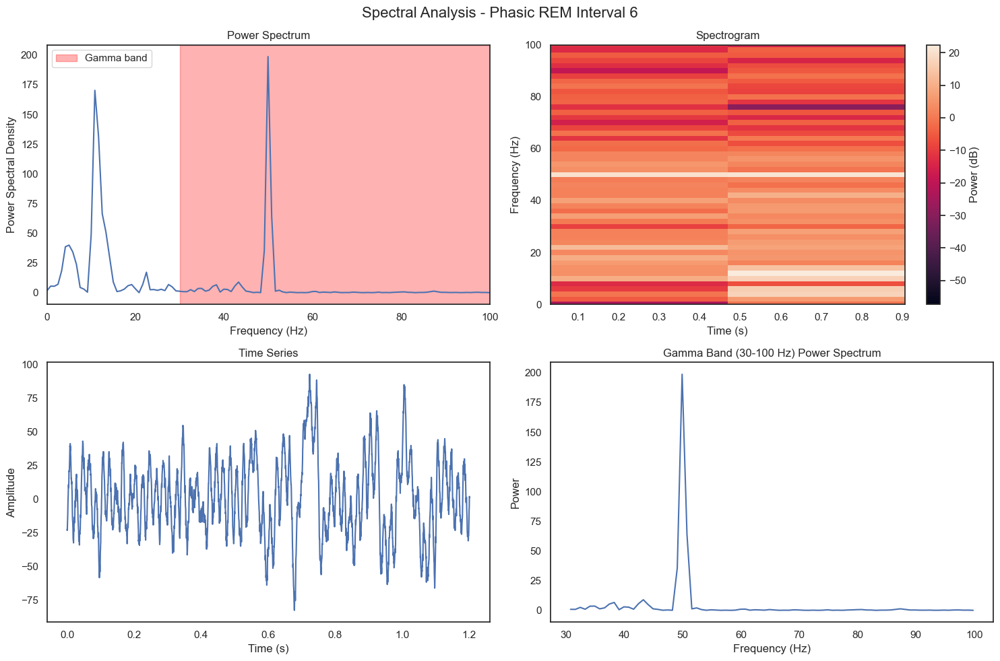


Phasic REM - Interval 7:
Number of IMF components: 7
  IMF-1: mean frequency = 92.41 Hz
  IMF-2: mean frequency = 92.41 Hz
  IMF-3: mean frequency = 63.57 Hz
  IMF-4: mean frequency = 71.43 Hz
  IMF-5: mean frequency = 84.40 Hz
  IMF-6: mean frequency = 78.60 Hz
  IMF-7: mean frequency = 88.65 Hz
Fast components (>15Hz) signal length: 2470 samples

SPECTRAL ANALYSIS: Phasic REM Interval 7
Peak frequency: 49.60 Hz
Total power: 505.5296
Gamma power (30-100 Hz): 367.0606
Gamma/total power ratio: 0.7261


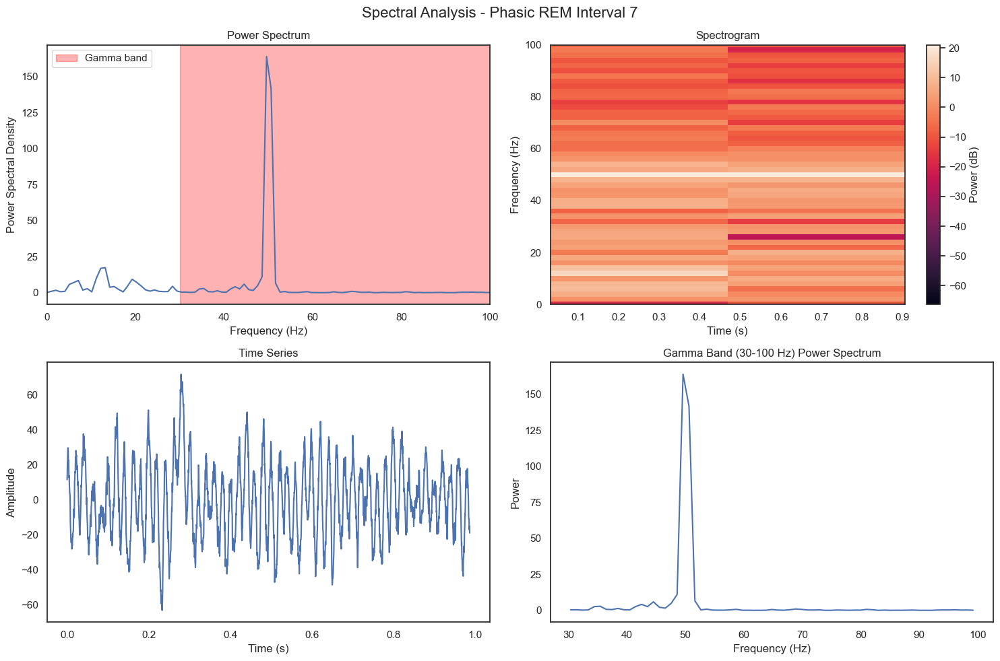


Phasic REM - Interval 8:
Number of IMF components: 7
  IMF-1: mean frequency = 119.98 Hz
  IMF-2: mean frequency = 119.98 Hz
  IMF-3: mean frequency = 47.06 Hz
  IMF-4: mean frequency = 40.31 Hz
  IMF-5: mean frequency = 80.04 Hz
  IMF-6: mean frequency = 114.01 Hz
  IMF-7: mean frequency = 119.47 Hz
Fast components (>15Hz) signal length: 2270 samples

SPECTRAL ANALYSIS: Phasic REM Interval 8
Peak frequency: 49.56 Hz
Total power: 528.9932
Gamma power (30-100 Hz): 194.4869
Gamma/total power ratio: 0.3677


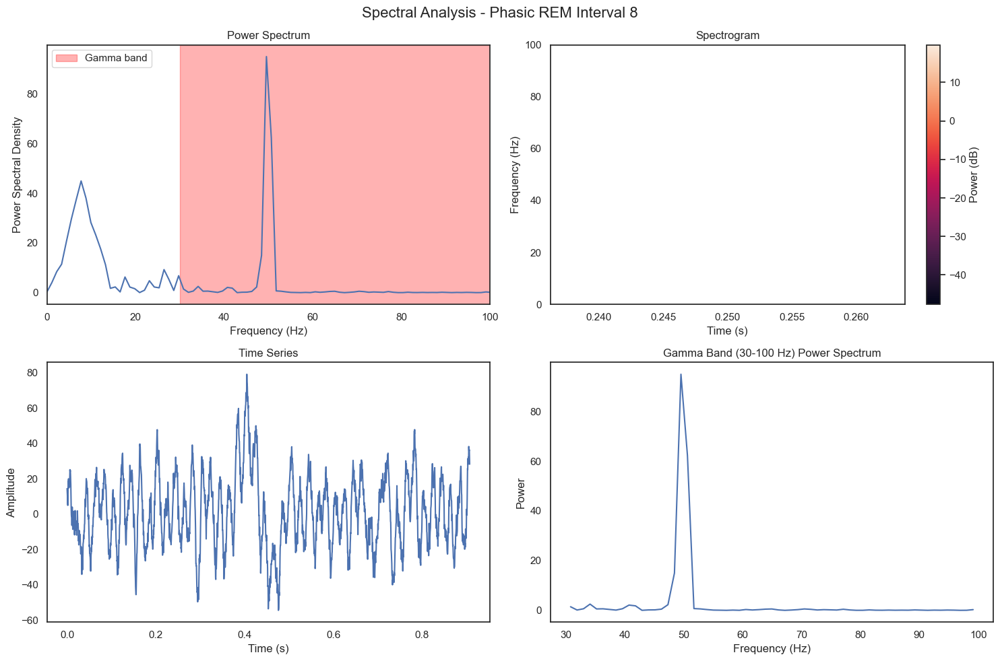


Phasic REM - Interval 9:
Number of IMF components: 7
  IMF-1: mean frequency = 88.67 Hz
  IMF-2: mean frequency = 88.67 Hz
  IMF-3: mean frequency = 134.22 Hz
  IMF-4: mean frequency = 129.95 Hz
  IMF-5: mean frequency = 185.41 Hz
  IMF-6: mean frequency = 231.63 Hz
  IMF-7: mean frequency = 176.34 Hz
Fast components (>15Hz) signal length: 2650 samples

SPECTRAL ANALYSIS: Phasic REM Interval 9
Peak frequency: 50.00 Hz
Total power: 874.2467
Gamma power (30-100 Hz): 232.8693
Gamma/total power ratio: 0.2664


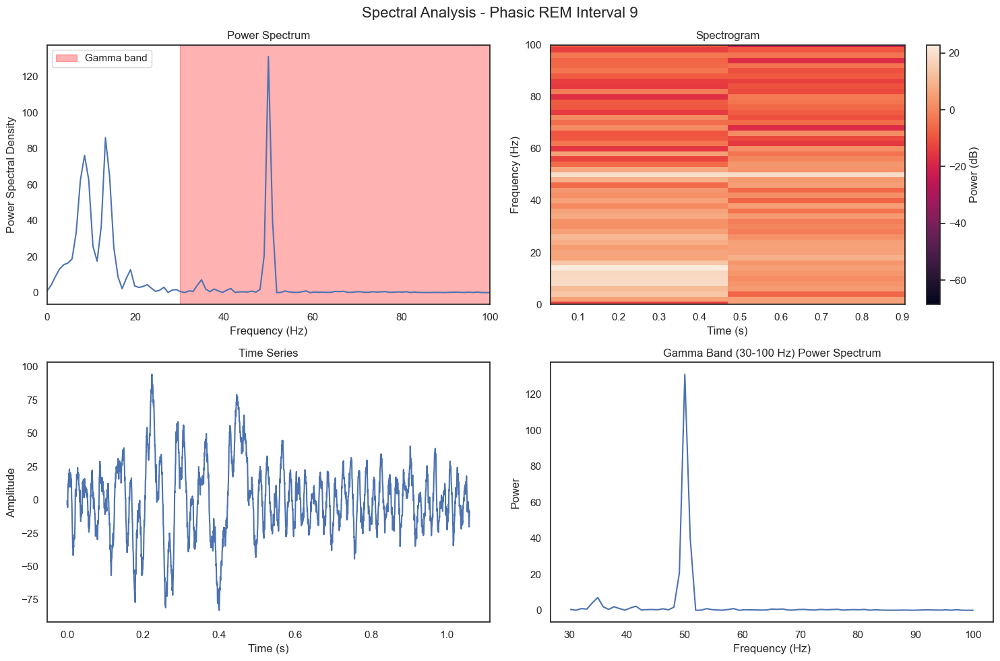


Phasic REM - Interval 10:
Number of IMF components: 8
  IMF-1: mean frequency = 12.65 Hz
  IMF-2: mean frequency = 12.65 Hz
  IMF-3: mean frequency = 54.79 Hz
  IMF-4: mean frequency = 108.01 Hz
  IMF-5: mean frequency = 139.05 Hz
  IMF-6: mean frequency = 127.77 Hz
  IMF-7: mean frequency = 78.82 Hz
  IMF-8: mean frequency = 48.09 Hz
Fast components (>15Hz) signal length: 4005 samples

SPECTRAL ANALYSIS: Phasic REM Interval 10
Peak frequency: 49.94 Hz
Total power: 1454.7367
Gamma power (30-100 Hz): 400.4005
Gamma/total power ratio: 0.2752


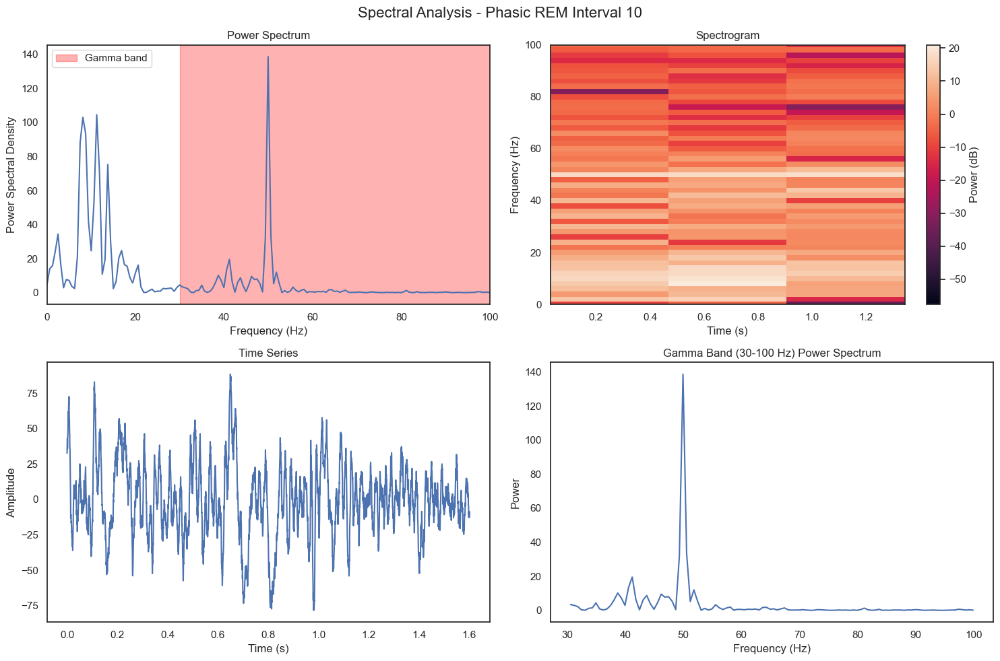

In [44]:
# Cell 6: Analyze phasic REM intervals
print("ANALYZING PHASIC REM INTERVALS")
phasic_fast_signals, phasic_spectral_results = analyze_all_intervals(
    phasic_imfs_default, phasic_imfs_freqs_default, phasic_rem_lpf_default, "Phasic REM")


ANALYZING TONIC REM INTERVALS

Tonic REM - Interval 1:
Number of IMF components: 12
  IMF-1: mean frequency = 50.58 Hz
  IMF-2: mean frequency = 50.58 Hz
  IMF-3: mean frequency = 44.20 Hz
  IMF-4: mean frequency = 49.00 Hz
  IMF-5: mean frequency = 36.93 Hz
  IMF-6: mean frequency = 43.85 Hz
  IMF-7: mean frequency = 67.30 Hz
  IMF-8: mean frequency = 77.18 Hz
  IMF-9: mean frequency = 64.72 Hz
  IMF-10: mean frequency = 59.33 Hz
  IMF-11: mean frequency = 68.58 Hz
  IMF-12: mean frequency = 71.95 Hz
Fast components (>15Hz) signal length: 150675 samples

SPECTRAL ANALYSIS: Tonic REM Interval 1
Peak frequency: 50.00 Hz
Total power: 370.0113
Gamma power (30-100 Hz): 229.2011
Gamma/total power ratio: 0.6194


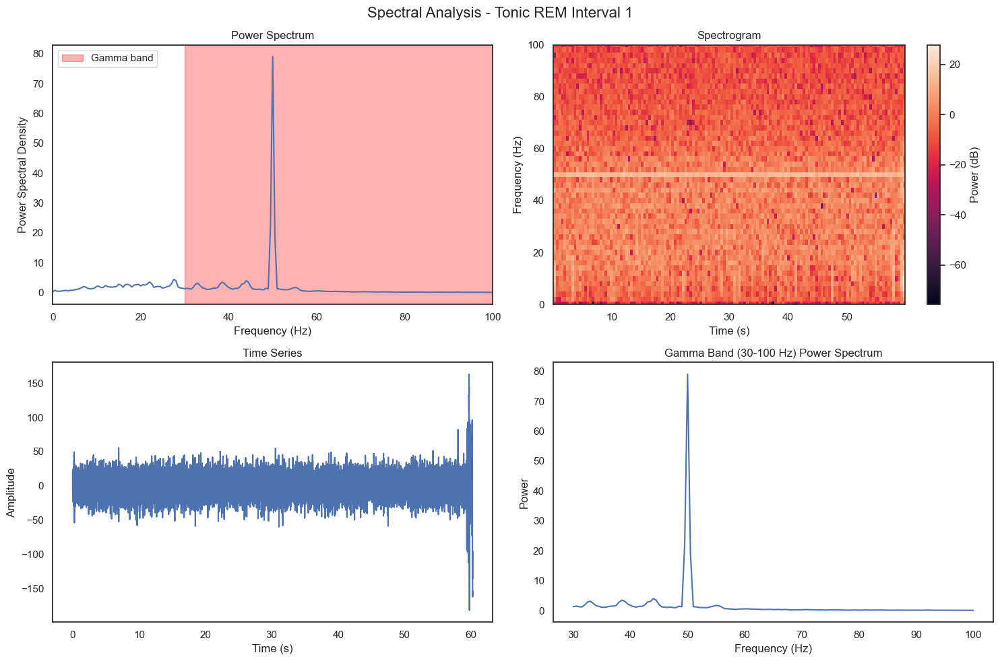


Tonic REM - Interval 2:
Number of IMF components: 9
  IMF-1: mean frequency = 66.21 Hz
  IMF-2: mean frequency = 66.21 Hz
  IMF-3: mean frequency = 64.04 Hz
  IMF-4: mean frequency = 35.67 Hz
  IMF-5: mean frequency = 29.79 Hz
  IMF-6: mean frequency = 30.76 Hz
  IMF-7: mean frequency = 35.64 Hz
  IMF-8: mean frequency = 30.58 Hz
  IMF-9: mean frequency = 27.81 Hz
Fast components (>15Hz) signal length: 21750 samples

SPECTRAL ANALYSIS: Tonic REM Interval 2
Peak frequency: 17.50 Hz
Total power: 19995.4653
Gamma power (30-100 Hz): 8492.9947
Gamma/total power ratio: 0.4247


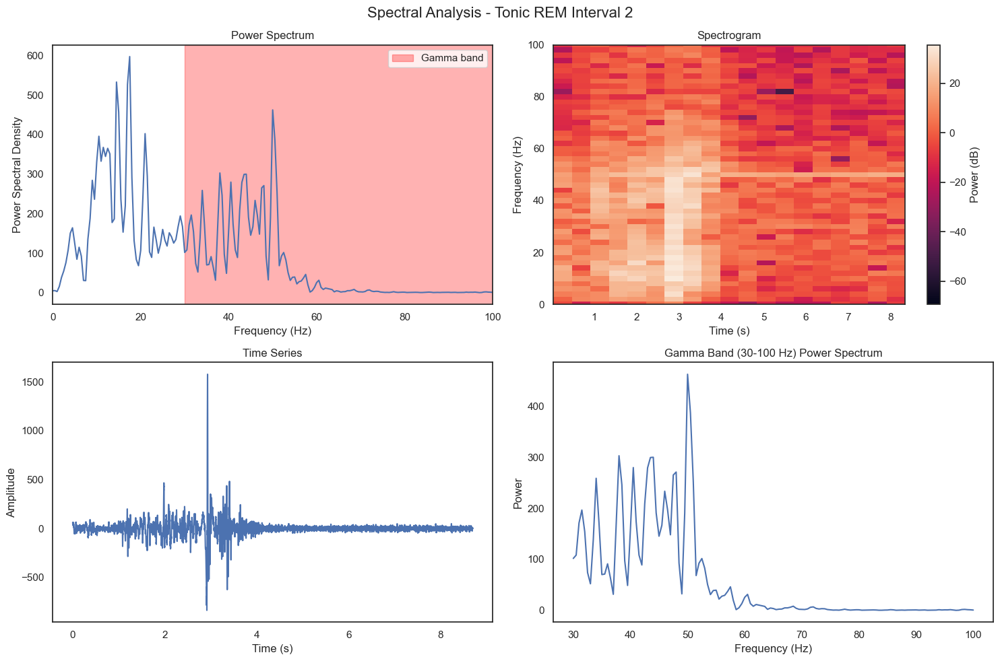


Tonic REM - Interval 3:
Number of IMF components: 12
  IMF-1: mean frequency = 49.87 Hz
  IMF-2: mean frequency = 49.87 Hz
  IMF-3: mean frequency = 71.19 Hz
  IMF-4: mean frequency = 68.97 Hz
  IMF-5: mean frequency = 84.11 Hz
  IMF-6: mean frequency = 103.44 Hz
  IMF-7: mean frequency = 58.27 Hz
  IMF-8: mean frequency = 37.03 Hz
  IMF-9: mean frequency = 31.84 Hz
  IMF-10: mean frequency = 42.06 Hz
  IMF-11: mean frequency = 52.83 Hz
  IMF-12: mean frequency = 39.47 Hz
Fast components (>15Hz) signal length: 113510 samples

SPECTRAL ANALYSIS: Tonic REM Interval 3
Peak frequency: 50.00 Hz
Total power: 703.3575
Gamma power (30-100 Hz): 434.8674
Gamma/total power ratio: 0.6183


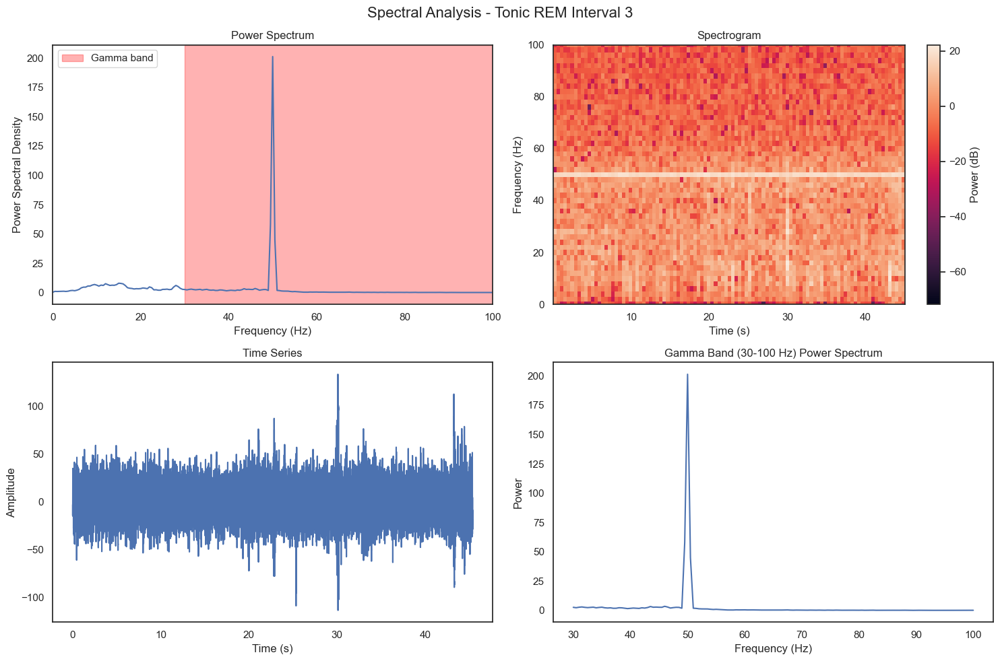


Tonic REM - Interval 4:
Number of IMF components: 11
  IMF-1: mean frequency = 49.60 Hz
  IMF-2: mean frequency = 49.60 Hz
  IMF-3: mean frequency = 19.18 Hz
  IMF-4: mean frequency = 31.56 Hz
  IMF-5: mean frequency = 55.94 Hz
  IMF-6: mean frequency = 44.71 Hz
  IMF-7: mean frequency = 48.10 Hz
  IMF-8: mean frequency = 59.30 Hz
  IMF-9: mean frequency = 84.94 Hz
  IMF-10: mean frequency = 40.83 Hz
  IMF-11: mean frequency = 41.52 Hz
Fast components (>15Hz) signal length: 85315 samples

SPECTRAL ANALYSIS: Tonic REM Interval 4
Peak frequency: 50.00 Hz
Total power: 893.2891
Gamma power (30-100 Hz): 495.4434
Gamma/total power ratio: 0.5546


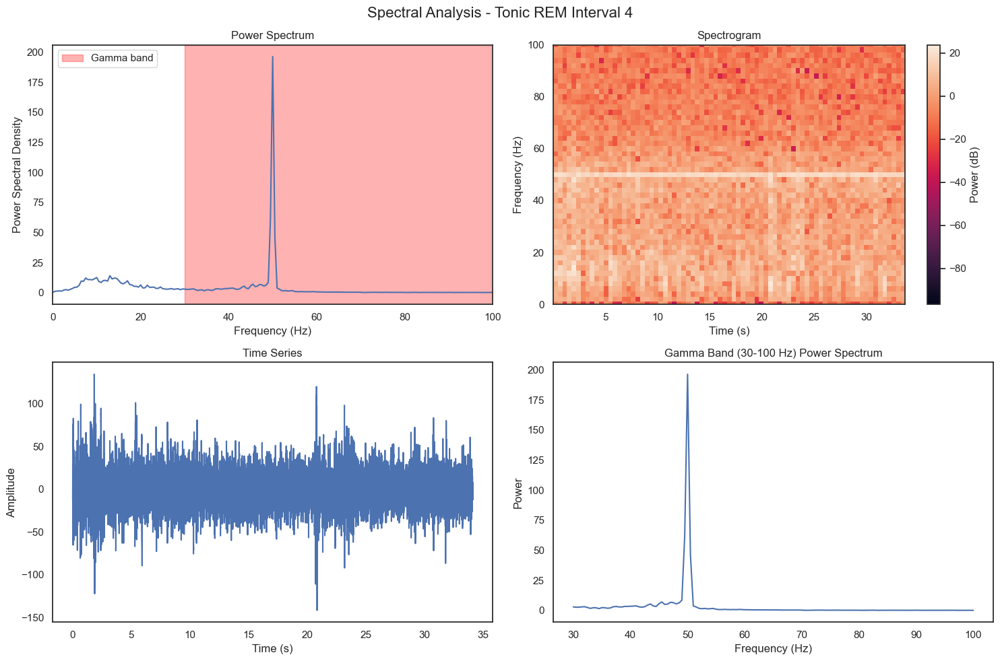


Tonic REM - Interval 5:
Number of IMF components: 7
  IMF-1: mean frequency = 127.32 Hz
  IMF-2: mean frequency = 127.32 Hz
  IMF-3: mean frequency = 100.01 Hz
  IMF-4: mean frequency = 98.03 Hz
  IMF-5: mean frequency = 89.77 Hz
  IMF-6: mean frequency = 84.00 Hz
  IMF-7: mean frequency = 100.04 Hz
Fast components (>15Hz) signal length: 7715 samples

SPECTRAL ANALYSIS: Tonic REM Interval 5
Peak frequency: 50.00 Hz
Total power: 745.9083
Gamma power (30-100 Hz): 481.7049
Gamma/total power ratio: 0.6458


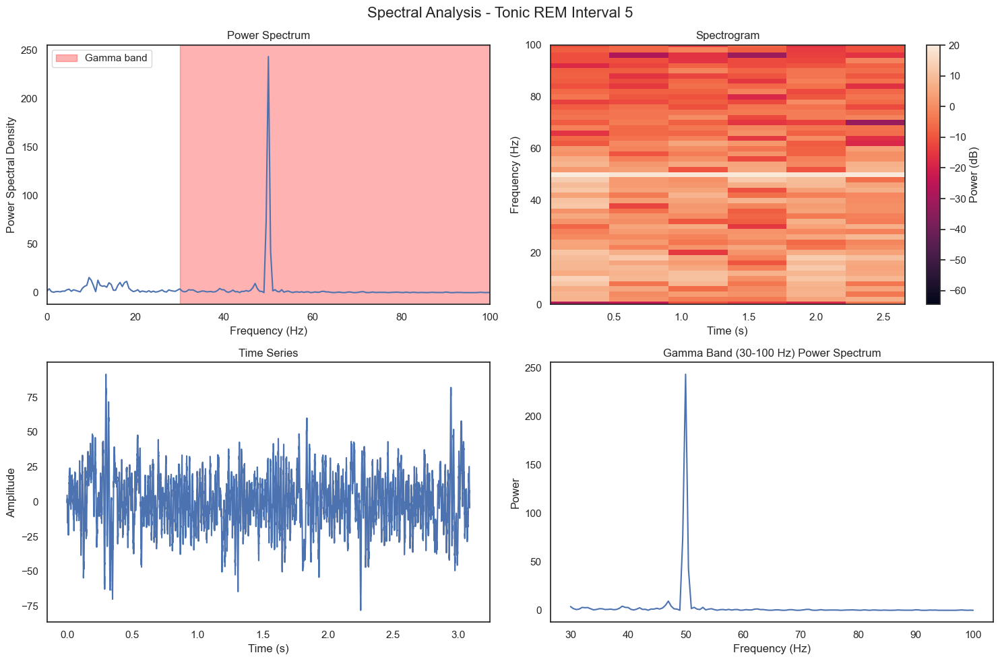


Tonic REM - Interval 6:
Number of IMF components: 11
  IMF-1: mean frequency = 115.54 Hz
  IMF-2: mean frequency = 115.54 Hz
  IMF-3: mean frequency = 106.04 Hz
  IMF-4: mean frequency = 101.59 Hz
  IMF-5: mean frequency = 106.13 Hz
  IMF-6: mean frequency = 98.40 Hz
  IMF-7: mean frequency = 78.82 Hz
  IMF-8: mean frequency = 78.16 Hz
  IMF-9: mean frequency = 78.69 Hz
  IMF-10: mean frequency = 79.62 Hz
  IMF-11: mean frequency = 81.97 Hz
Fast components (>15Hz) signal length: 59380 samples

SPECTRAL ANALYSIS: Tonic REM Interval 6
Peak frequency: 50.00 Hz
Total power: 1740.6764
Gamma power (30-100 Hz): 512.1233
Gamma/total power ratio: 0.2942


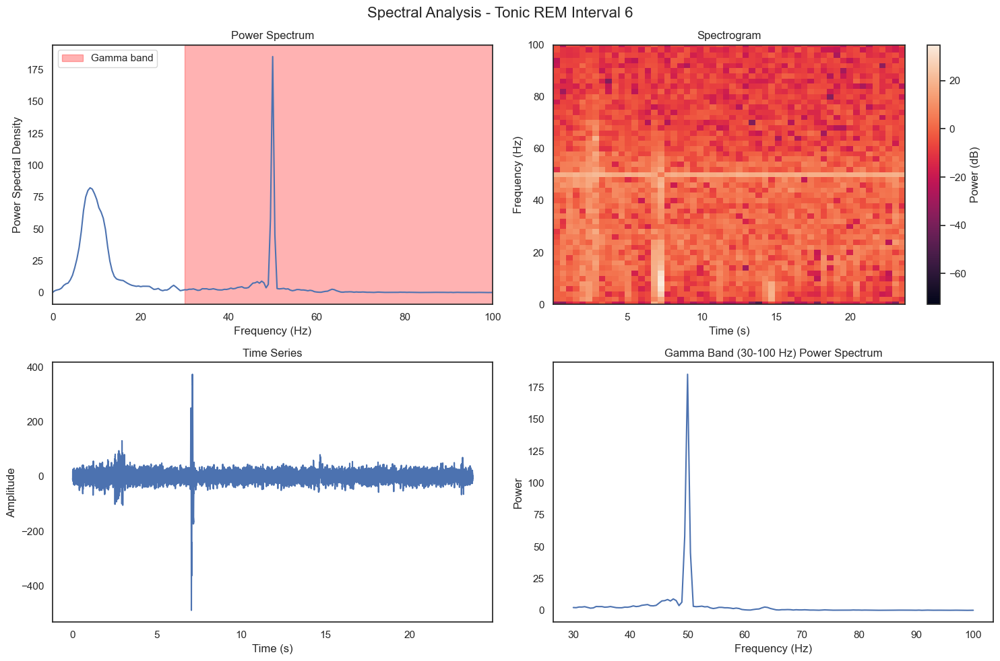


Tonic REM - Interval 7:
Number of IMF components: 10
  IMF-1: mean frequency = 94.99 Hz
  IMF-2: mean frequency = 94.99 Hz
  IMF-3: mean frequency = 60.22 Hz
  IMF-4: mean frequency = 67.55 Hz
  IMF-5: mean frequency = 93.46 Hz
  IMF-6: mean frequency = 121.99 Hz
  IMF-7: mean frequency = 135.92 Hz
  IMF-8: mean frequency = 154.01 Hz
  IMF-9: mean frequency = 127.48 Hz
  IMF-10: mean frequency = 94.37 Hz
Fast components (>15Hz) signal length: 82500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 7
Peak frequency: 50.00 Hz
Total power: 705.3000
Gamma power (30-100 Hz): 438.4217
Gamma/total power ratio: 0.6216


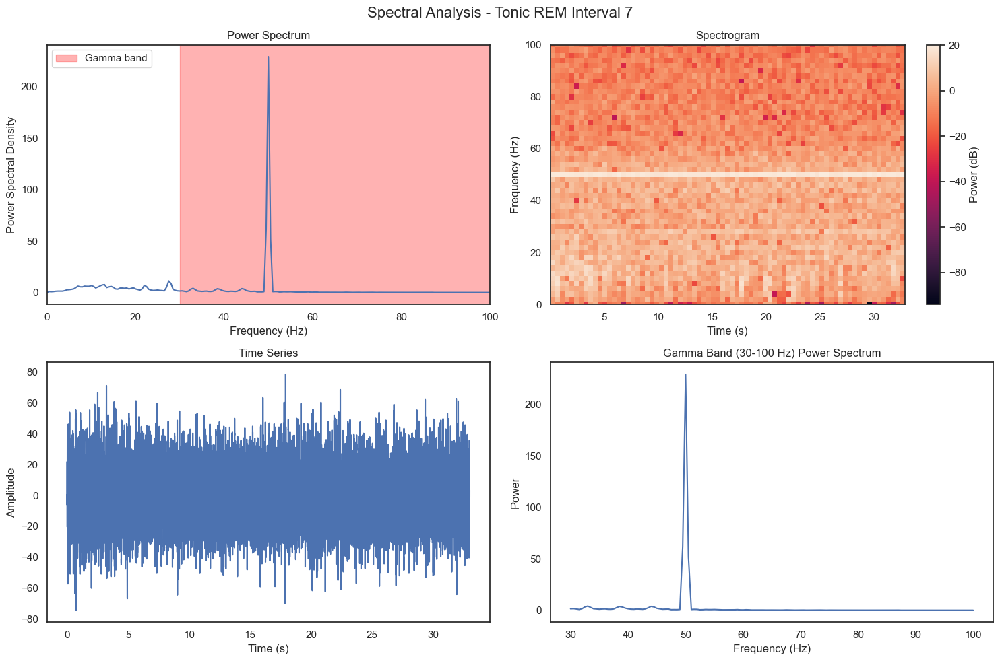


Tonic REM - Interval 8:
Number of IMF components: 13
  IMF-1: mean frequency = 2.67 Hz
  IMF-2: mean frequency = 2.67 Hz
  IMF-3: mean frequency = 29.12 Hz
  IMF-4: mean frequency = 46.18 Hz
  IMF-5: mean frequency = 38.35 Hz
  IMF-6: mean frequency = 42.89 Hz
  IMF-7: mean frequency = 48.04 Hz
  IMF-8: mean frequency = 47.48 Hz
  IMF-9: mean frequency = 48.29 Hz
  IMF-10: mean frequency = 49.77 Hz
  IMF-11: mean frequency = 49.23 Hz
  IMF-12: mean frequency = 56.78 Hz
  IMF-13: mean frequency = 71.32 Hz
Fast components (>15Hz) signal length: 542500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 8
Peak frequency: 50.00 Hz
Total power: 853.5963
Gamma power (30-100 Hz): 511.6942
Gamma/total power ratio: 0.5995


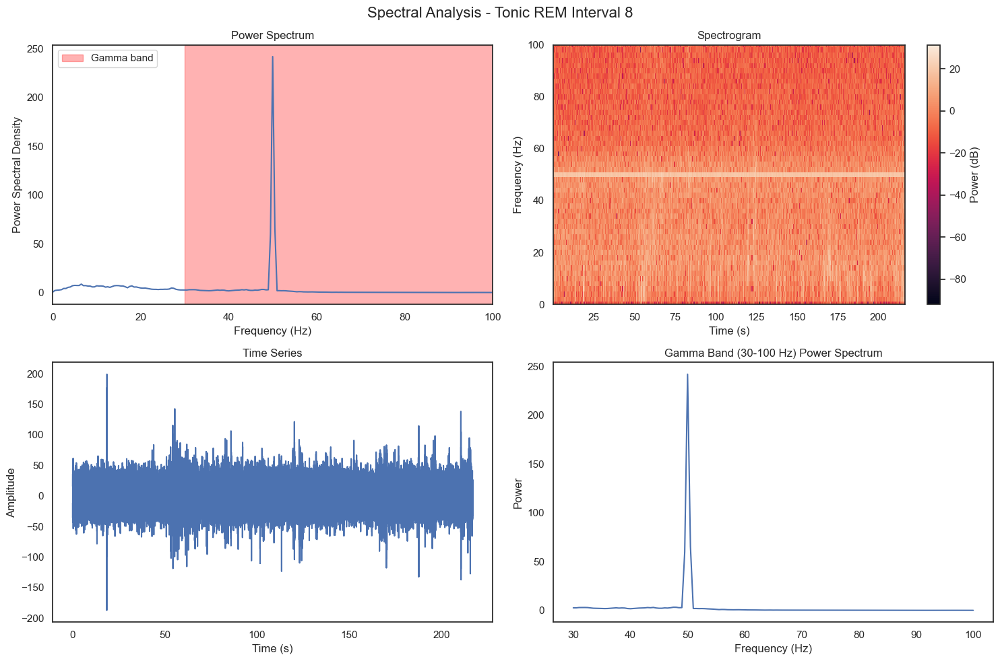


Tonic REM - Interval 9:
Number of IMF components: 10
  IMF-1: mean frequency = 57.56 Hz
  IMF-2: mean frequency = 57.56 Hz
  IMF-3: mean frequency = 63.33 Hz
  IMF-4: mean frequency = 95.11 Hz
  IMF-5: mean frequency = 109.65 Hz
  IMF-6: mean frequency = 98.04 Hz
  IMF-7: mean frequency = 107.52 Hz
  IMF-8: mean frequency = 137.08 Hz
  IMF-9: mean frequency = 153.85 Hz
  IMF-10: mean frequency = 159.26 Hz
Fast components (>15Hz) signal length: 40605 samples

SPECTRAL ANALYSIS: Tonic REM Interval 9
Peak frequency: 50.00 Hz
Total power: 726.1383
Gamma power (30-100 Hz): 456.8944
Gamma/total power ratio: 0.6292


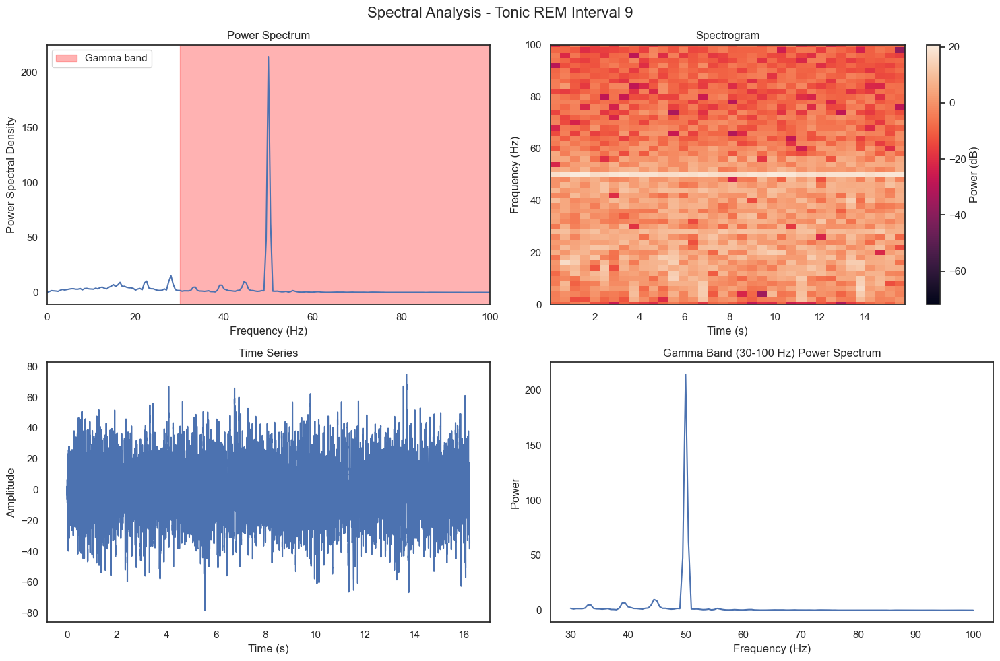


Tonic REM - Interval 10:
Number of IMF components: 12
  IMF-1: mean frequency = 3.75 Hz
  IMF-2: mean frequency = 3.75 Hz
  IMF-3: mean frequency = 18.01 Hz
  IMF-4: mean frequency = 33.88 Hz
  IMF-5: mean frequency = 38.84 Hz
  IMF-6: mean frequency = 48.00 Hz
  IMF-7: mean frequency = 77.33 Hz
  IMF-8: mean frequency = 73.19 Hz
  IMF-9: mean frequency = 73.35 Hz
  IMF-10: mean frequency = 87.00 Hz
  IMF-11: mean frequency = 71.53 Hz
  IMF-12: mean frequency = 61.01 Hz
Fast components (>15Hz) signal length: 159135 samples

SPECTRAL ANALYSIS: Tonic REM Interval 10
Peak frequency: 3.00 Hz
Total power: 36423.7082
Gamma power (30-100 Hz): 683.1273
Gamma/total power ratio: 0.0188


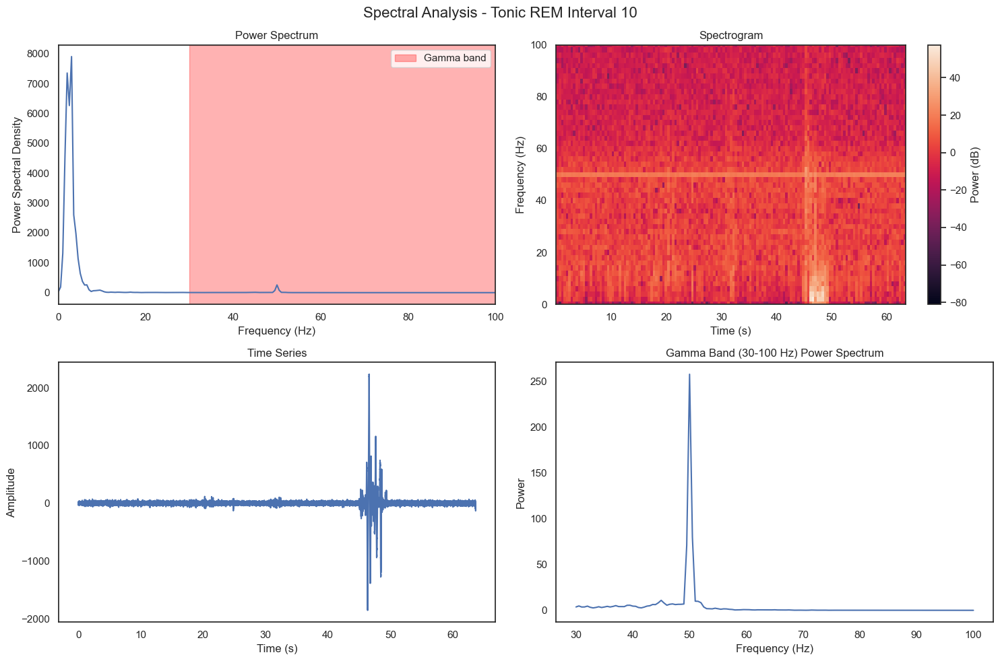


Tonic REM - Interval 11:
Number of IMF components: 11
  IMF-1: mean frequency = 108.23 Hz
  IMF-2: mean frequency = 108.23 Hz
  IMF-3: mean frequency = 103.32 Hz
  IMF-4: mean frequency = 113.29 Hz
  IMF-5: mean frequency = 101.04 Hz
  IMF-6: mean frequency = 71.28 Hz
  IMF-7: mean frequency = 50.90 Hz
  IMF-8: mean frequency = 57.21 Hz
  IMF-9: mean frequency = 42.74 Hz
  IMF-10: mean frequency = 53.94 Hz
  IMF-11: mean frequency = 63.38 Hz
Fast components (>15Hz) signal length: 72035 samples

SPECTRAL ANALYSIS: Tonic REM Interval 11
Peak frequency: 50.00 Hz
Total power: 1023.9055
Gamma power (30-100 Hz): 652.2329
Gamma/total power ratio: 0.6370


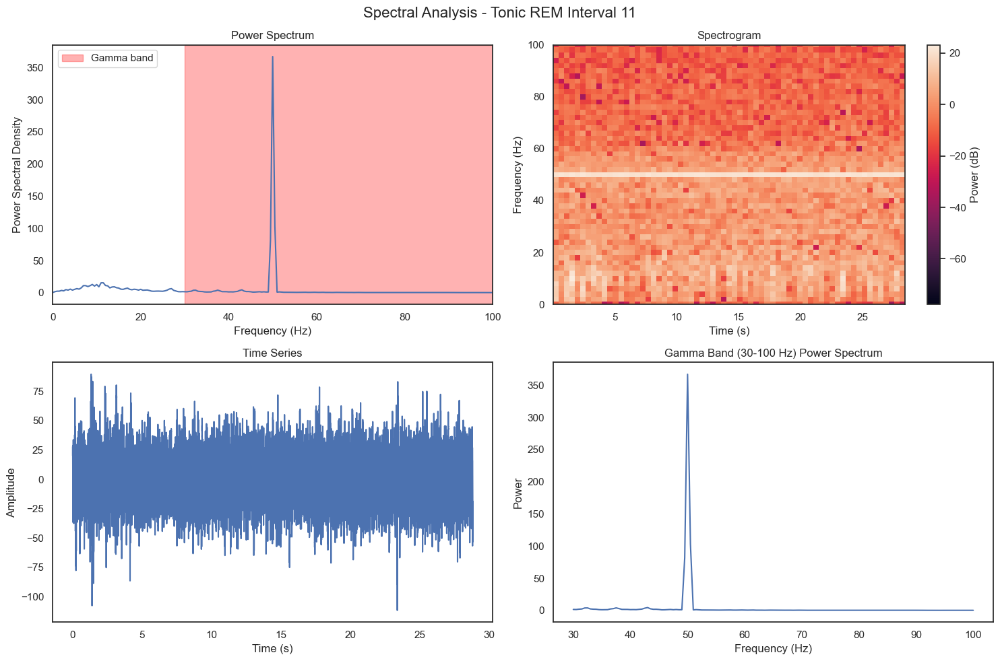


Tonic REM - Interval 12:
Number of IMF components: 12
  IMF-1: mean frequency = 58.39 Hz
  IMF-2: mean frequency = 58.39 Hz
  IMF-3: mean frequency = 46.30 Hz
  IMF-4: mean frequency = 63.69 Hz
  IMF-5: mean frequency = 81.98 Hz
  IMF-6: mean frequency = 83.27 Hz
  IMF-7: mean frequency = 75.06 Hz
  IMF-8: mean frequency = 73.33 Hz
  IMF-9: mean frequency = 75.94 Hz
  IMF-10: mean frequency = 72.21 Hz
  IMF-11: mean frequency = 108.30 Hz
  IMF-12: mean frequency = 131.70 Hz
Fast components (>15Hz) signal length: 380035 samples

SPECTRAL ANALYSIS: Tonic REM Interval 12
Peak frequency: 50.00 Hz
Total power: 996.5039
Gamma power (30-100 Hz): 693.5034
Gamma/total power ratio: 0.6959


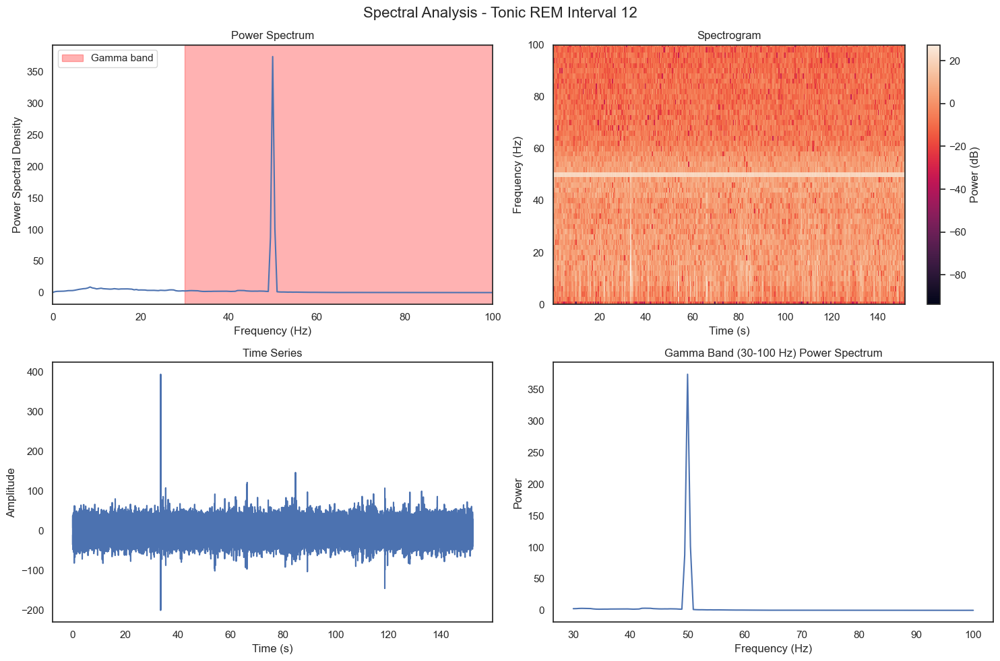


Tonic REM - Interval 13:
Number of IMF components: 10
  IMF-1: mean frequency = 68.42 Hz
  IMF-2: mean frequency = 68.42 Hz
  IMF-3: mean frequency = 74.84 Hz
  IMF-4: mean frequency = 88.58 Hz
  IMF-5: mean frequency = 120.14 Hz
  IMF-6: mean frequency = 121.24 Hz
  IMF-7: mean frequency = 93.88 Hz
  IMF-8: mean frequency = 91.29 Hz
  IMF-9: mean frequency = 76.27 Hz
  IMF-10: mean frequency = 93.18 Hz
Fast components (>15Hz) signal length: 50000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 13
Peak frequency: 50.00 Hz
Total power: 647.0927
Gamma power (30-100 Hz): 381.7471
Gamma/total power ratio: 0.5899


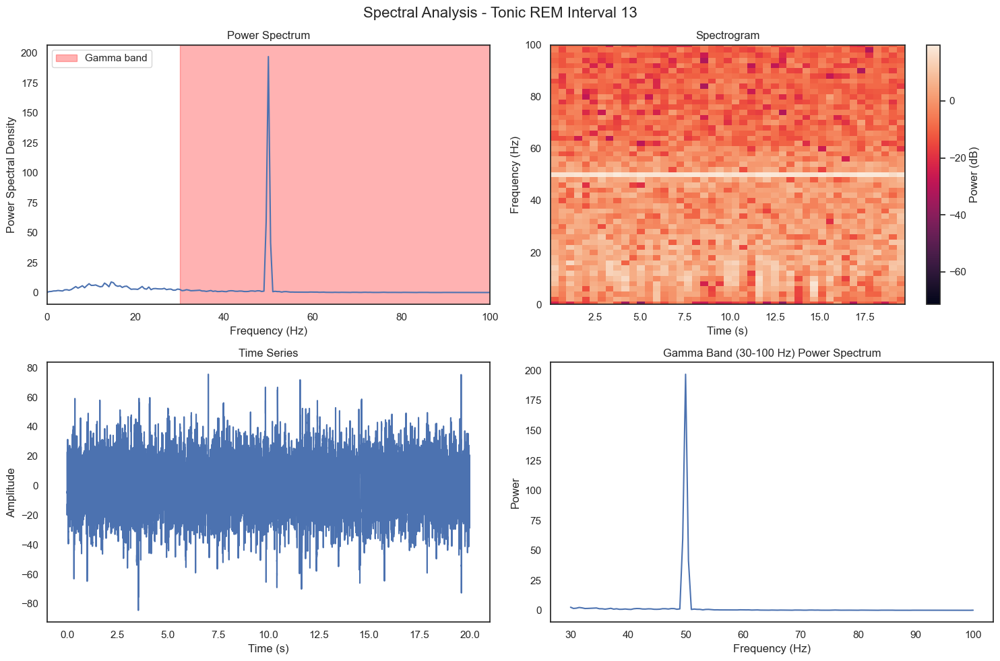


Tonic REM - Interval 14:
Number of IMF components: 10
  IMF-1: mean frequency = 52.41 Hz
  IMF-2: mean frequency = 52.41 Hz
  IMF-3: mean frequency = 38.87 Hz
  IMF-4: mean frequency = 48.15 Hz
  IMF-5: mean frequency = 58.53 Hz
  IMF-6: mean frequency = 72.96 Hz
  IMF-7: mean frequency = 88.86 Hz
  IMF-8: mean frequency = 86.41 Hz
  IMF-9: mean frequency = 107.20 Hz
  IMF-10: mean frequency = 150.82 Hz
Fast components (>15Hz) signal length: 34410 samples

SPECTRAL ANALYSIS: Tonic REM Interval 14
Peak frequency: 50.00 Hz
Total power: 816.9952
Gamma power (30-100 Hz): 438.3476
Gamma/total power ratio: 0.5365


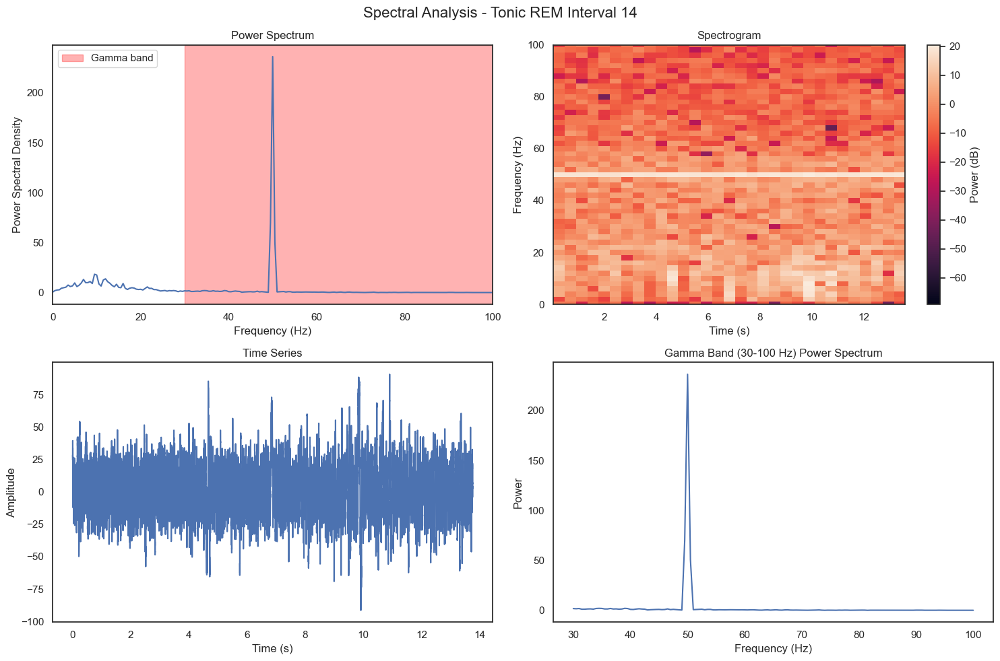


Tonic REM - Interval 15:
Number of IMF components: 10
  IMF-1: mean frequency = 126.44 Hz
  IMF-2: mean frequency = 126.44 Hz
  IMF-3: mean frequency = 135.60 Hz
  IMF-4: mean frequency = 124.41 Hz
  IMF-5: mean frequency = 88.48 Hz
  IMF-6: mean frequency = 94.02 Hz
  IMF-7: mean frequency = 123.34 Hz
  IMF-8: mean frequency = 109.50 Hz
  IMF-9: mean frequency = 52.51 Hz
  IMF-10: mean frequency = 39.73 Hz
Fast components (>15Hz) signal length: 27985 samples

SPECTRAL ANALYSIS: Tonic REM Interval 15
Peak frequency: 50.00 Hz
Total power: 777.8778
Gamma power (30-100 Hz): 434.6019
Gamma/total power ratio: 0.5587


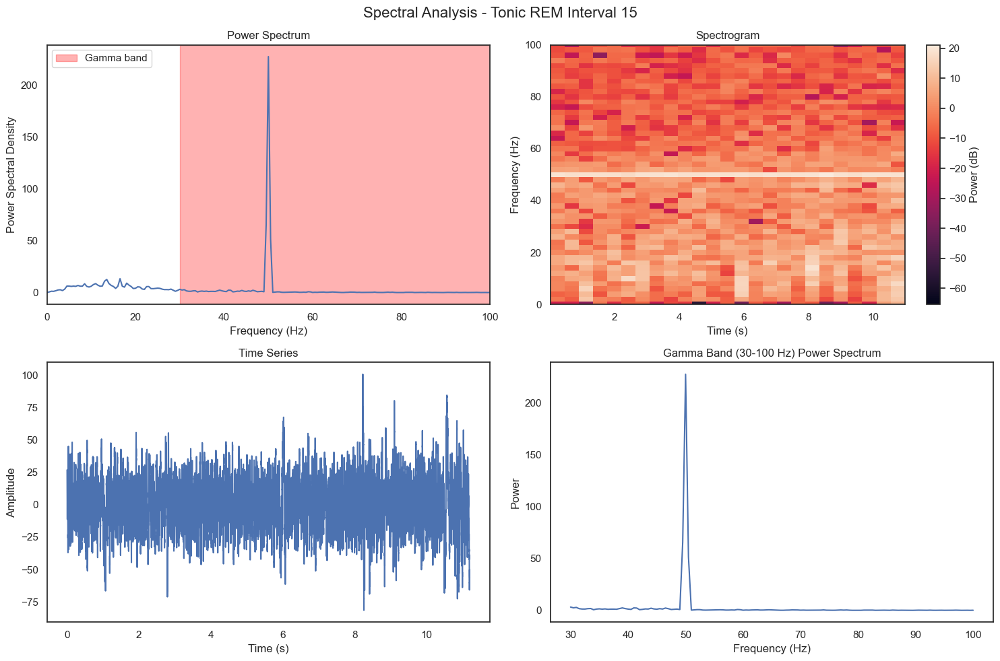


Tonic REM - Interval 16:
Number of IMF components: 13
  IMF-1: mean frequency = 103.03 Hz
  IMF-2: mean frequency = 103.03 Hz
  IMF-3: mean frequency = 72.77 Hz
  IMF-4: mean frequency = 54.14 Hz
  IMF-5: mean frequency = 60.44 Hz
  IMF-6: mean frequency = 78.63 Hz
  IMF-7: mean frequency = 85.17 Hz
  IMF-8: mean frequency = 89.87 Hz
  IMF-9: mean frequency = 92.77 Hz
  IMF-10: mean frequency = 85.61 Hz
  IMF-11: mean frequency = 84.10 Hz
  IMF-12: mean frequency = 99.08 Hz
  IMF-13: mean frequency = 98.27 Hz
Fast components (>15Hz) signal length: 280185 samples

SPECTRAL ANALYSIS: Tonic REM Interval 16
Peak frequency: 50.00 Hz
Total power: 757.7215
Gamma power (30-100 Hz): 441.1841
Gamma/total power ratio: 0.5823


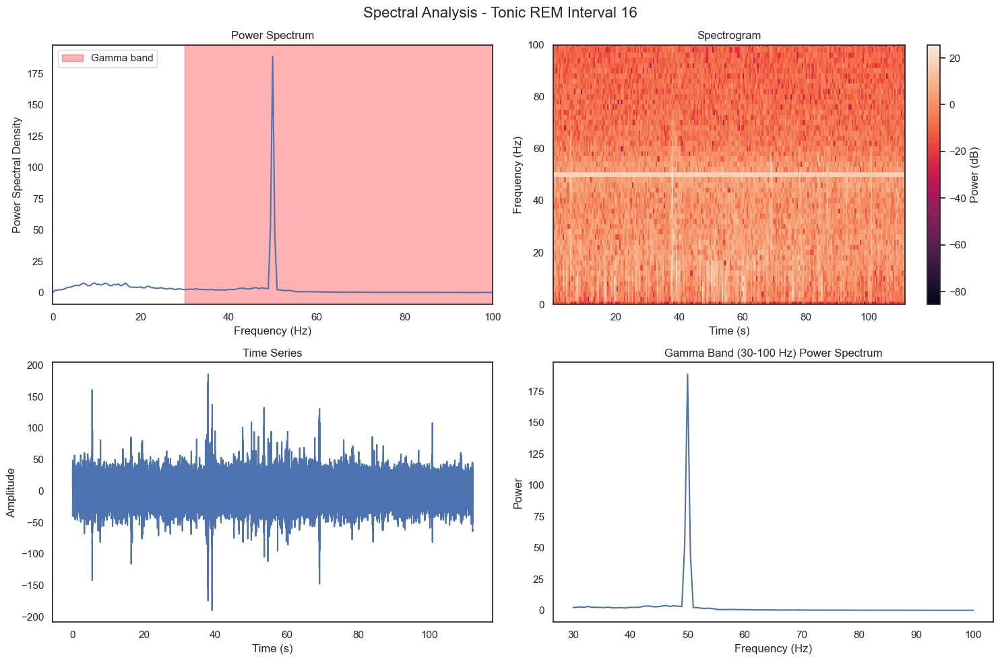


Tonic REM - Interval 17:
Number of IMF components: 11
  IMF-1: mean frequency = 65.85 Hz
  IMF-2: mean frequency = 65.85 Hz
  IMF-3: mean frequency = 57.78 Hz
  IMF-4: mean frequency = 74.27 Hz
  IMF-5: mean frequency = 88.09 Hz
  IMF-6: mean frequency = 84.44 Hz
  IMF-7: mean frequency = 64.22 Hz
  IMF-8: mean frequency = 57.28 Hz
  IMF-9: mean frequency = 69.62 Hz
  IMF-10: mean frequency = 65.64 Hz
  IMF-11: mean frequency = 52.30 Hz
Fast components (>15Hz) signal length: 97500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 17
Peak frequency: 50.00 Hz
Total power: 456.9625
Gamma power (30-100 Hz): 278.9910
Gamma/total power ratio: 0.6105


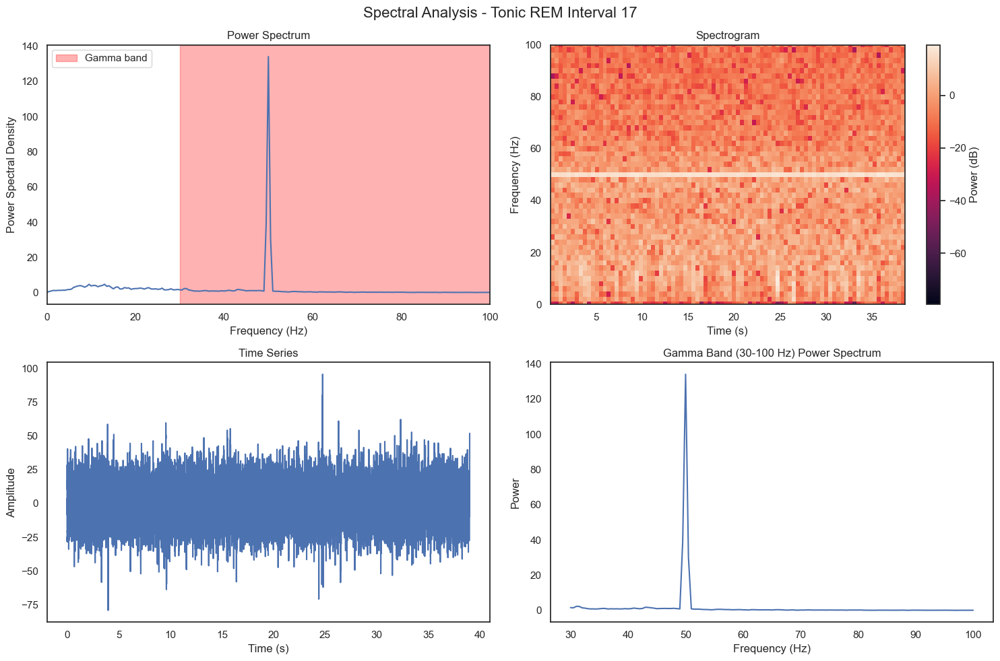


Tonic REM - Interval 18:
Number of IMF components: 9
  IMF-1: mean frequency = -10.44 Hz
  IMF-2: mean frequency = -10.44 Hz
  IMF-3: mean frequency = 23.46 Hz
  IMF-4: mean frequency = 41.34 Hz
  IMF-5: mean frequency = 52.20 Hz
  IMF-6: mean frequency = 46.24 Hz
  IMF-7: mean frequency = 51.60 Hz
  IMF-8: mean frequency = 56.66 Hz
  IMF-9: mean frequency = 64.32 Hz
Fast components (>15Hz) signal length: 32500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 18
Peak frequency: 50.00 Hz
Total power: 924.2204
Gamma power (30-100 Hz): 609.9326
Gamma/total power ratio: 0.6599


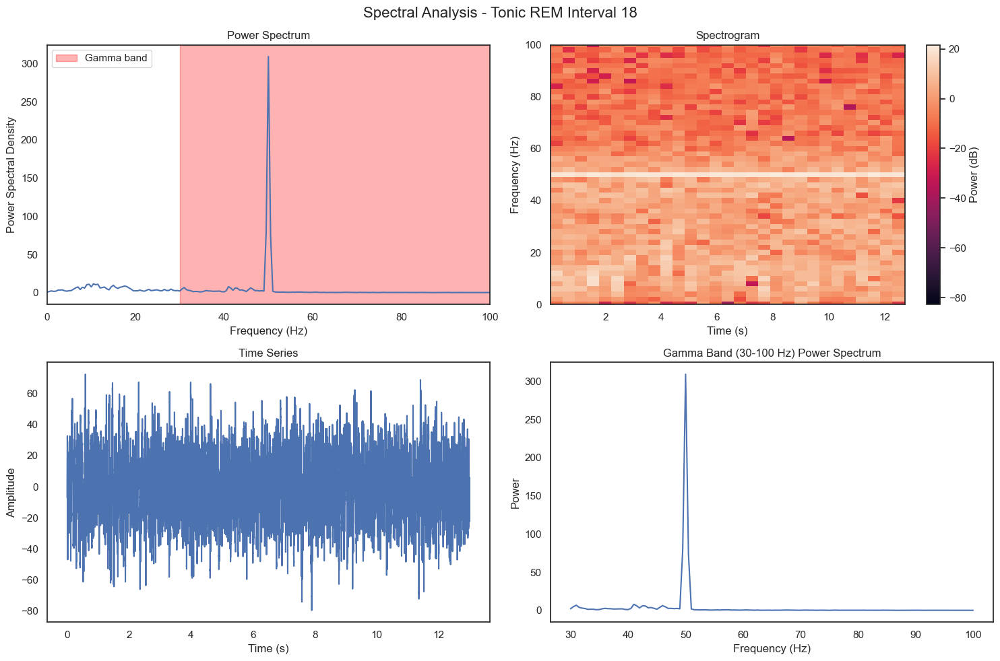


Tonic REM - Interval 19:
Number of IMF components: 11
  IMF-1: mean frequency = 43.17 Hz
  IMF-2: mean frequency = 43.17 Hz
  IMF-3: mean frequency = 42.17 Hz
  IMF-4: mean frequency = 74.33 Hz
  IMF-5: mean frequency = 86.30 Hz
  IMF-6: mean frequency = 65.00 Hz
  IMF-7: mean frequency = 48.04 Hz
  IMF-8: mean frequency = 57.14 Hz
  IMF-9: mean frequency = 62.74 Hz
  IMF-10: mean frequency = 55.58 Hz
  IMF-11: mean frequency = 61.91 Hz
Fast components (>15Hz) signal length: 117500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 19
Peak frequency: 50.00 Hz
Total power: 494.1067
Gamma power (30-100 Hz): 335.9336
Gamma/total power ratio: 0.6799


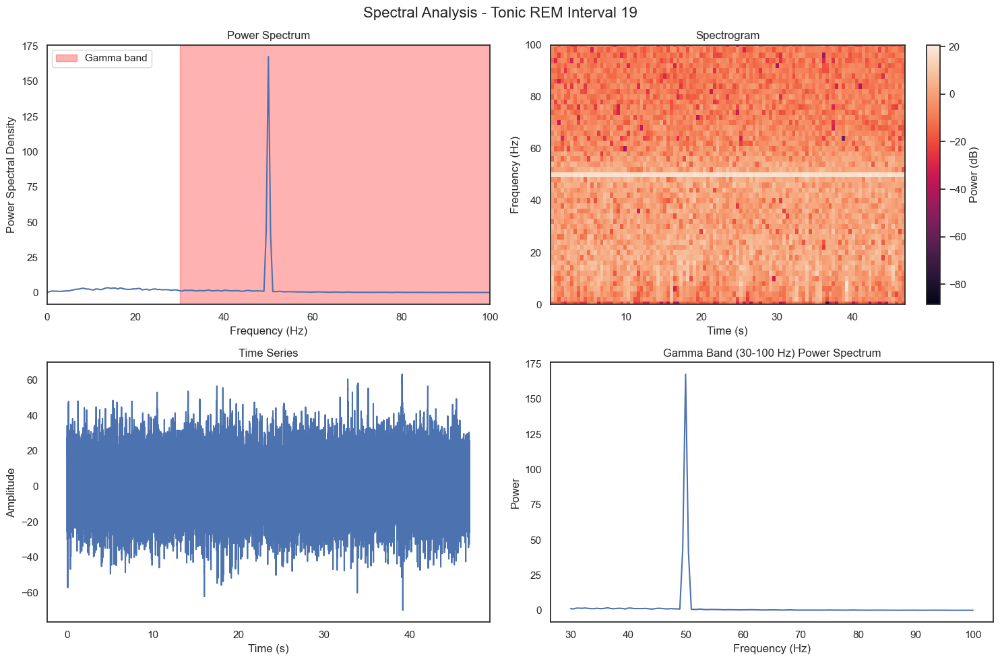


Tonic REM - Interval 20:
Number of IMF components: 12
  IMF-1: mean frequency = 37.30 Hz
  IMF-2: mean frequency = 37.30 Hz
  IMF-3: mean frequency = 40.06 Hz
  IMF-4: mean frequency = 42.81 Hz
  IMF-5: mean frequency = 54.39 Hz
  IMF-6: mean frequency = 73.69 Hz
  IMF-7: mean frequency = 87.99 Hz
  IMF-8: mean frequency = 89.31 Hz
  IMF-9: mean frequency = 64.12 Hz
  IMF-10: mean frequency = 71.90 Hz
  IMF-11: mean frequency = 72.05 Hz
  IMF-12: mean frequency = 49.78 Hz
Fast components (>15Hz) signal length: 194380 samples

SPECTRAL ANALYSIS: Tonic REM Interval 20
Peak frequency: 50.00 Hz
Total power: 578.2559
Gamma power (30-100 Hz): 352.0519
Gamma/total power ratio: 0.6088


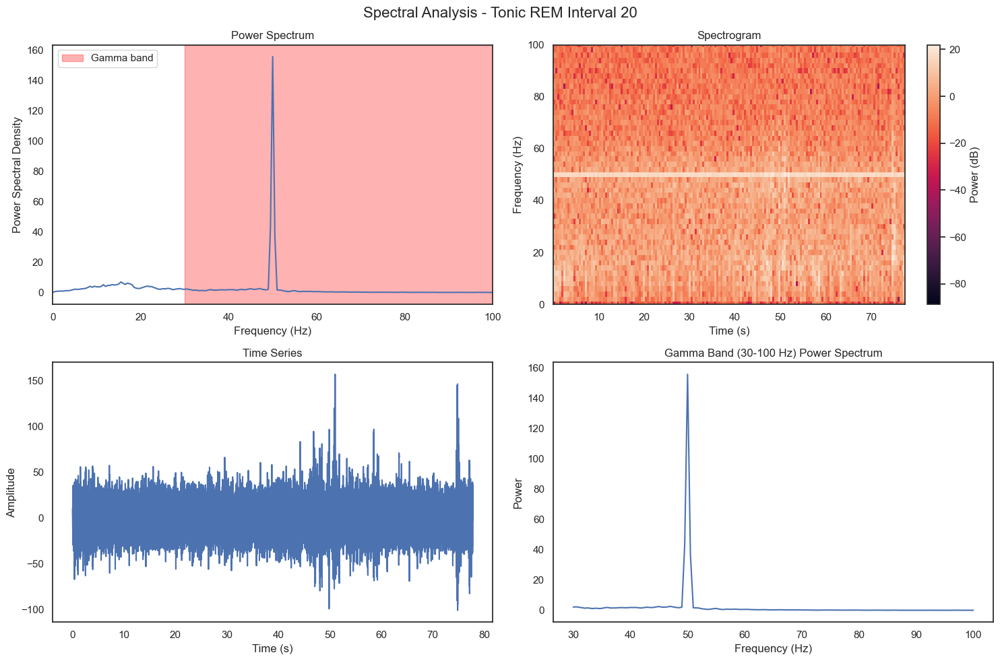


Tonic REM - Interval 21:
Number of IMF components: 13
  IMF-1: mean frequency = 29.49 Hz
  IMF-2: mean frequency = 29.49 Hz
  IMF-3: mean frequency = 19.57 Hz
  IMF-4: mean frequency = 24.66 Hz
  IMF-5: mean frequency = 15.66 Hz
  IMF-6: mean frequency = 15.28 Hz
  IMF-7: mean frequency = 27.97 Hz
  IMF-8: mean frequency = 39.55 Hz
  IMF-9: mean frequency = 56.49 Hz
  IMF-10: mean frequency = 75.99 Hz
  IMF-11: mean frequency = 92.40 Hz
  IMF-12: mean frequency = 119.58 Hz
  IMF-13: mean frequency = 139.39 Hz
Fast components (>15Hz) signal length: 321615 samples

SPECTRAL ANALYSIS: Tonic REM Interval 21
Peak frequency: 50.00 Hz
Total power: 998.9744
Gamma power (30-100 Hz): 597.9583
Gamma/total power ratio: 0.5986


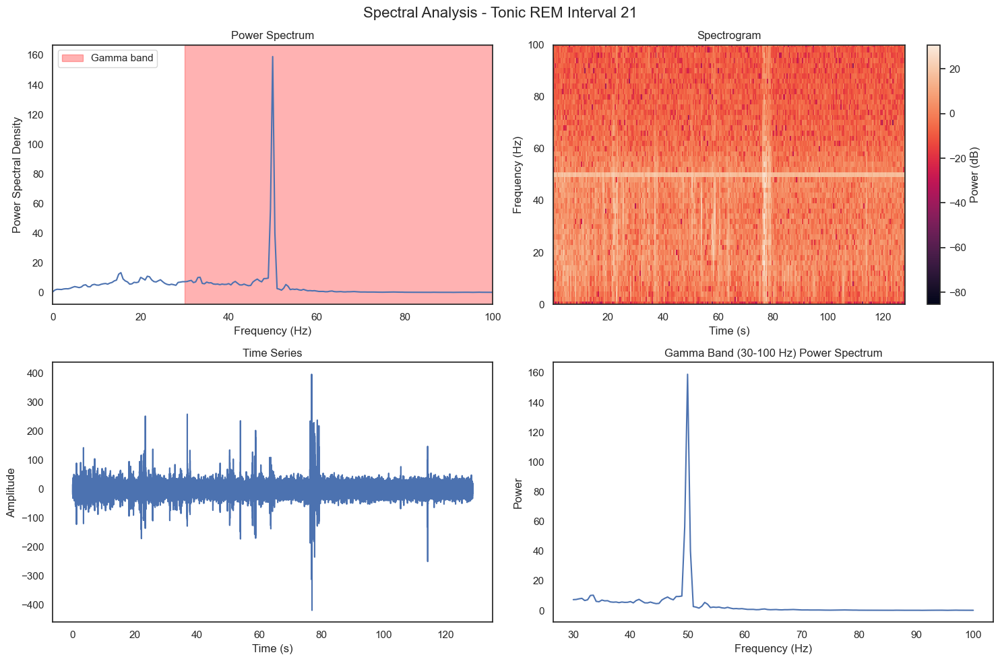


Tonic REM - Interval 22:
Number of IMF components: 9
  IMF-1: mean frequency = 83.99 Hz
  IMF-2: mean frequency = 83.99 Hz
  IMF-3: mean frequency = 87.63 Hz
  IMF-4: mean frequency = 77.80 Hz
  IMF-5: mean frequency = 63.44 Hz
  IMF-6: mean frequency = 72.63 Hz
  IMF-7: mean frequency = 54.45 Hz
  IMF-8: mean frequency = 57.29 Hz
  IMF-9: mean frequency = 92.54 Hz
Fast components (>15Hz) signal length: 12500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 22
Peak frequency: 50.00 Hz
Total power: 530.1097
Gamma power (30-100 Hz): 362.6095
Gamma/total power ratio: 0.6840


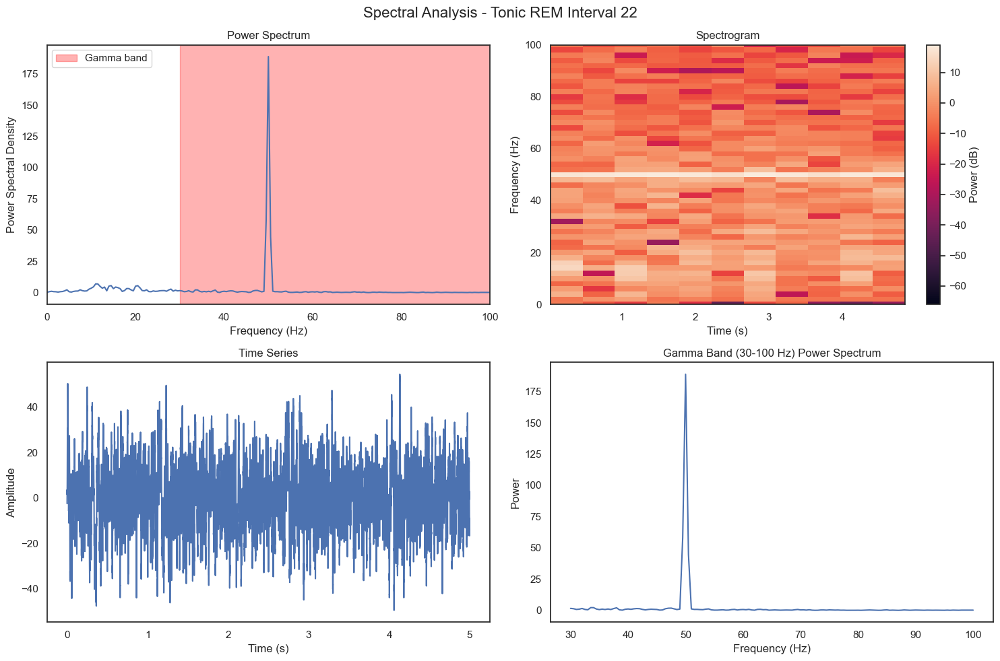


Tonic REM - Interval 23:
Number of IMF components: 10
  IMF-1: mean frequency = 108.91 Hz
  IMF-2: mean frequency = 108.91 Hz
  IMF-3: mean frequency = 126.71 Hz
  IMF-4: mean frequency = 134.30 Hz
  IMF-5: mean frequency = 117.29 Hz
  IMF-6: mean frequency = 104.68 Hz
  IMF-7: mean frequency = 114.53 Hz
  IMF-8: mean frequency = 114.60 Hz
  IMF-9: mean frequency = 102.05 Hz
  IMF-10: mean frequency = 90.38 Hz
Fast components (>15Hz) signal length: 72500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 23
Peak frequency: 50.00 Hz
Total power: 455.0980
Gamma power (30-100 Hz): 292.9864
Gamma/total power ratio: 0.6438


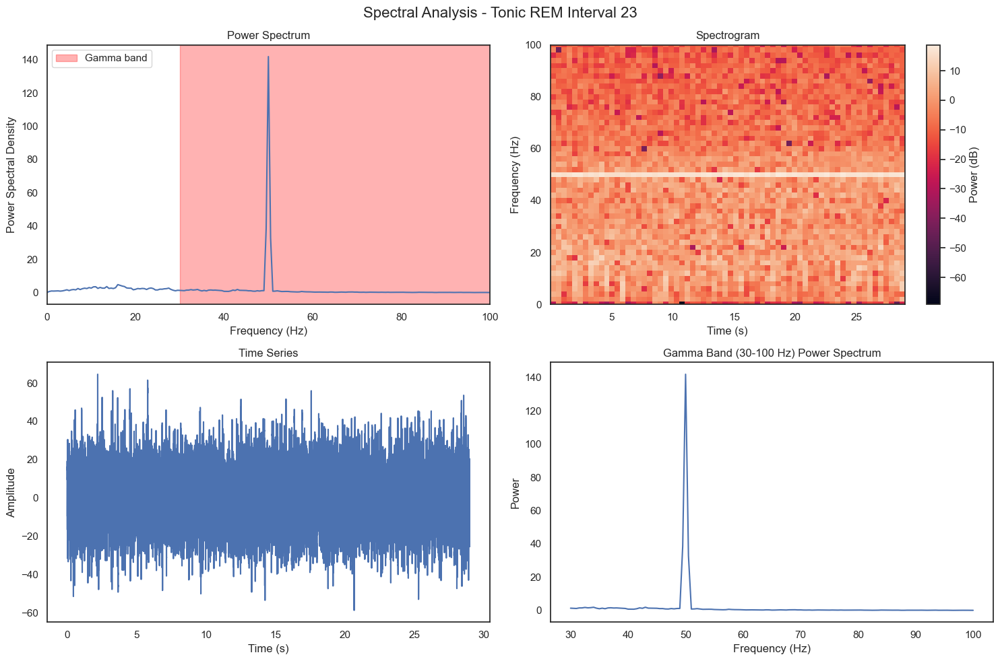


Tonic REM - Interval 24:
Number of IMF components: 11
  IMF-1: mean frequency = 69.61 Hz
  IMF-2: mean frequency = 69.61 Hz
  IMF-3: mean frequency = 87.91 Hz
  IMF-4: mean frequency = 59.17 Hz
  IMF-5: mean frequency = 37.10 Hz
  IMF-6: mean frequency = 43.42 Hz
  IMF-7: mean frequency = 73.42 Hz
  IMF-8: mean frequency = 72.73 Hz
  IMF-9: mean frequency = 81.16 Hz
  IMF-10: mean frequency = 121.67 Hz
  IMF-11: mean frequency = 88.14 Hz
Fast components (>15Hz) signal length: 55000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 24
Peak frequency: 50.00 Hz
Total power: 821.1418
Gamma power (30-100 Hz): 503.0369
Gamma/total power ratio: 0.6126


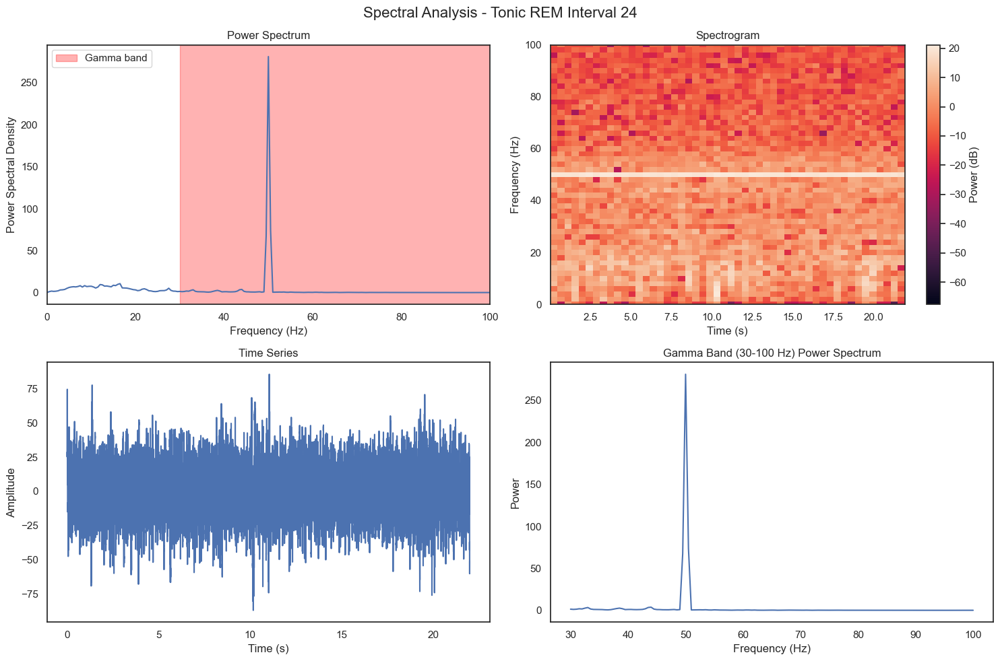


Tonic REM - Interval 25:
Number of IMF components: 13
  IMF-1: mean frequency = 1.80 Hz
  IMF-2: mean frequency = 1.80 Hz
  IMF-3: mean frequency = 13.45 Hz
  IMF-4: mean frequency = 53.99 Hz
  IMF-5: mean frequency = 57.47 Hz
  IMF-6: mean frequency = 63.69 Hz
  IMF-7: mean frequency = 78.91 Hz
  IMF-8: mean frequency = 101.93 Hz
  IMF-9: mean frequency = 113.39 Hz
  IMF-10: mean frequency = 97.75 Hz
  IMF-11: mean frequency = 89.17 Hz
  IMF-12: mean frequency = 79.87 Hz
  IMF-13: mean frequency = 60.81 Hz
Fast components (>15Hz) signal length: 190000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 25
Peak frequency: 50.00 Hz
Total power: 361.1115
Gamma power (30-100 Hz): 216.0928
Gamma/total power ratio: 0.5984


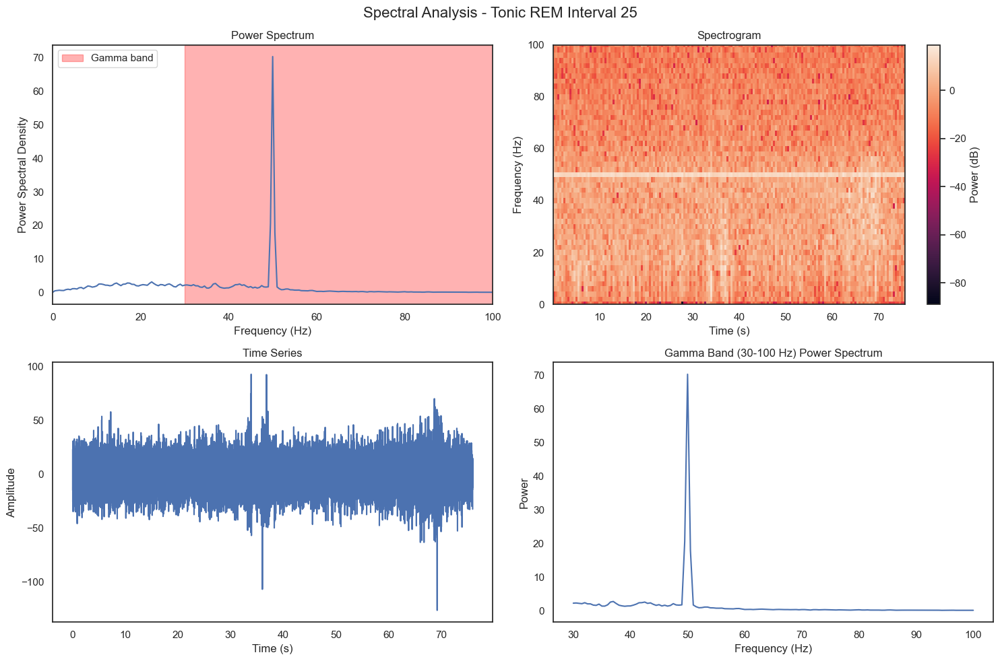


Tonic REM - Interval 26:
Number of IMF components: 12
  IMF-1: mean frequency = 121.86 Hz
  IMF-2: mean frequency = 121.86 Hz
  IMF-3: mean frequency = 145.36 Hz
  IMF-4: mean frequency = 65.04 Hz
  IMF-5: mean frequency = 42.48 Hz
  IMF-6: mean frequency = 83.02 Hz
  IMF-7: mean frequency = 106.94 Hz
  IMF-8: mean frequency = 86.70 Hz
  IMF-9: mean frequency = 51.32 Hz
  IMF-10: mean frequency = 56.65 Hz
  IMF-11: mean frequency = 82.67 Hz
  IMF-12: mean frequency = 97.21 Hz
Fast components (>15Hz) signal length: 232500 samples

SPECTRAL ANALYSIS: Tonic REM Interval 26
Peak frequency: 50.00 Hz
Total power: 1401.8629
Gamma power (30-100 Hz): 657.5135
Gamma/total power ratio: 0.4690


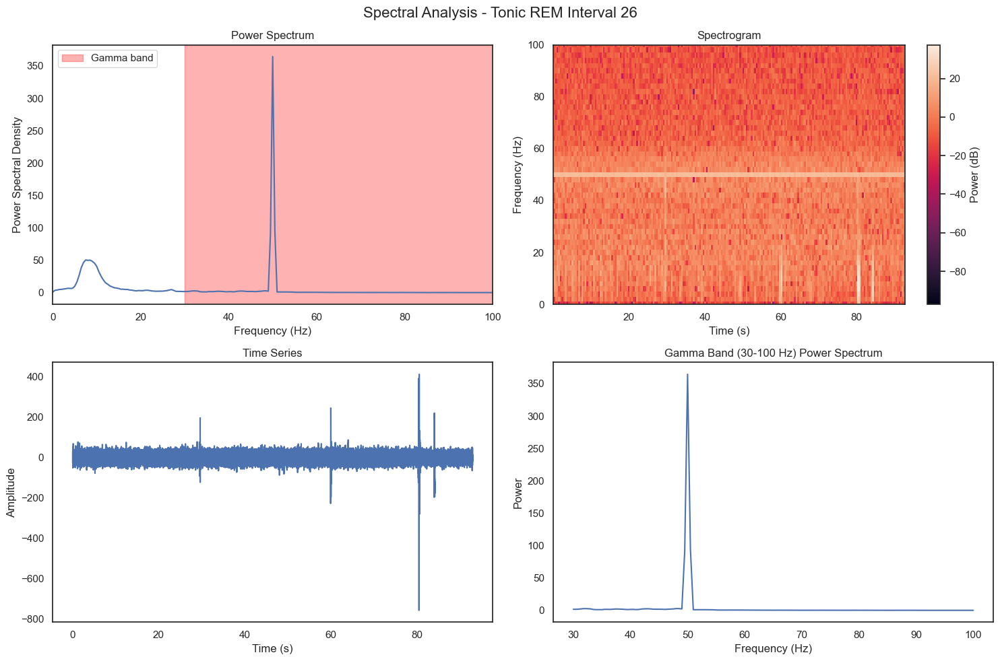


Tonic REM - Interval 27:
Number of IMF components: 13
  IMF-1: mean frequency = 6.45 Hz
  IMF-2: mean frequency = 6.45 Hz
  IMF-3: mean frequency = 28.03 Hz
  IMF-4: mean frequency = 55.43 Hz
  IMF-5: mean frequency = 67.40 Hz
  IMF-6: mean frequency = 74.11 Hz
  IMF-7: mean frequency = 43.43 Hz
  IMF-8: mean frequency = 50.75 Hz
  IMF-9: mean frequency = 53.93 Hz
  IMF-10: mean frequency = 50.24 Hz
  IMF-11: mean frequency = 86.89 Hz
  IMF-12: mean frequency = 54.05 Hz
  IMF-13: mean frequency = 43.30 Hz
Fast components (>15Hz) signal length: 305000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 27
Peak frequency: 50.00 Hz
Total power: 731.8316
Gamma power (30-100 Hz): 495.6210
Gamma/total power ratio: 0.6772


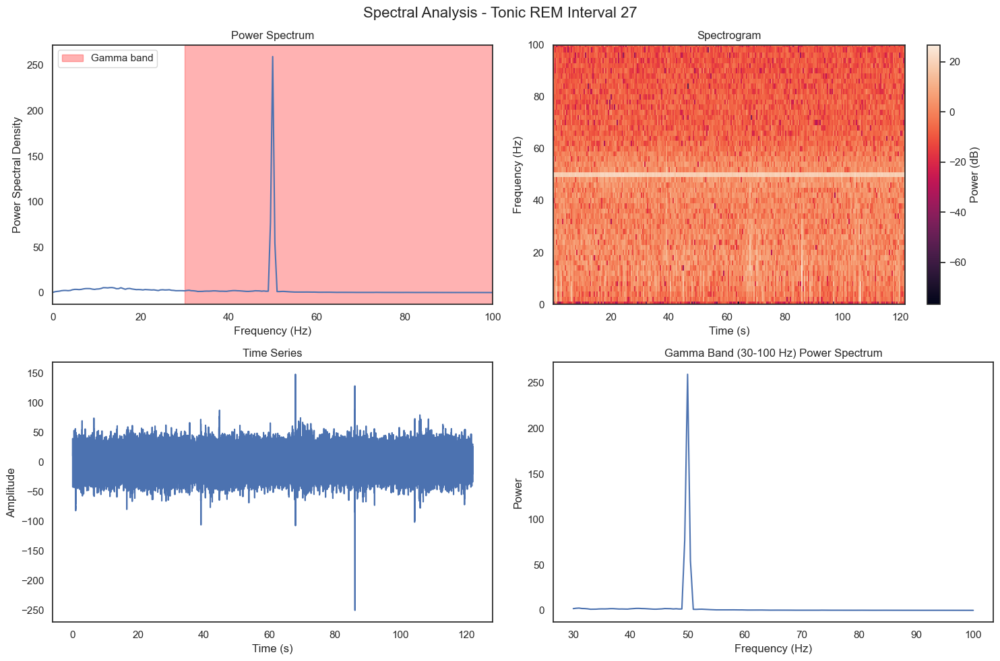


Tonic REM - Interval 28:
Number of IMF components: 10
  IMF-1: mean frequency = 40.82 Hz
  IMF-2: mean frequency = 40.82 Hz
  IMF-3: mean frequency = 50.63 Hz
  IMF-4: mean frequency = 82.80 Hz
  IMF-5: mean frequency = 116.59 Hz
  IMF-6: mean frequency = 106.01 Hz
  IMF-7: mean frequency = 68.16 Hz
  IMF-8: mean frequency = 63.46 Hz
  IMF-9: mean frequency = 57.39 Hz
  IMF-10: mean frequency = 52.24 Hz
Fast components (>15Hz) signal length: 30000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 28
Peak frequency: 50.00 Hz
Total power: 715.9345
Gamma power (30-100 Hz): 363.0039
Gamma/total power ratio: 0.5070


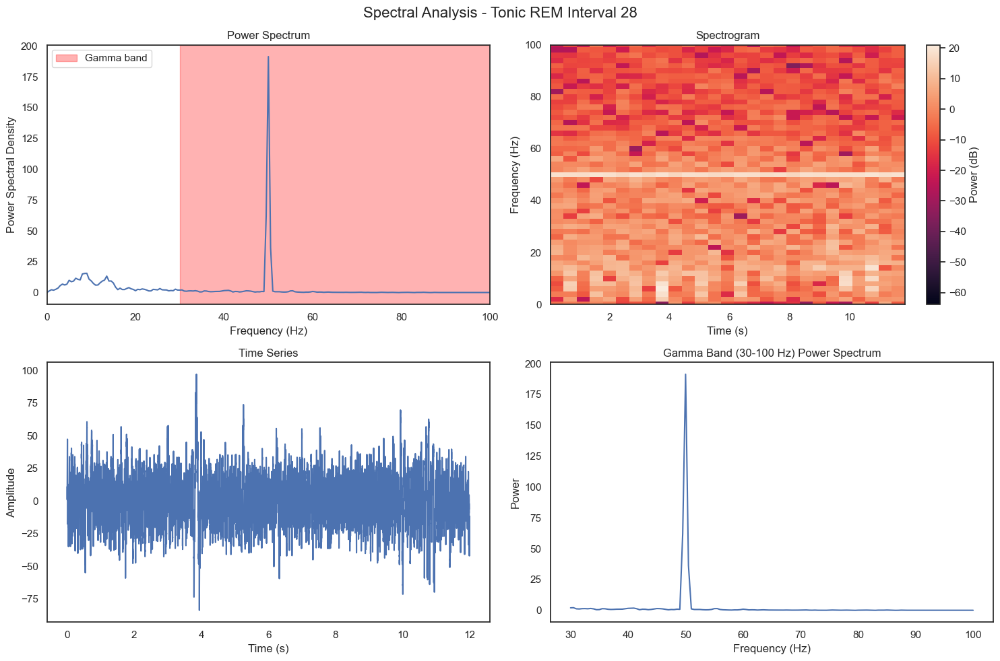


Tonic REM - Interval 29:
Number of IMF components: 13
  IMF-1: mean frequency = 77.09 Hz
  IMF-2: mean frequency = 77.09 Hz
  IMF-3: mean frequency = 48.88 Hz
  IMF-4: mean frequency = 46.62 Hz
  IMF-5: mean frequency = 47.44 Hz
  IMF-6: mean frequency = 53.21 Hz
  IMF-7: mean frequency = 49.65 Hz
  IMF-8: mean frequency = 45.64 Hz
  IMF-9: mean frequency = 41.03 Hz
  IMF-10: mean frequency = 35.03 Hz
  IMF-11: mean frequency = 29.81 Hz
  IMF-12: mean frequency = 27.25 Hz
  IMF-13: mean frequency = -1.28 Hz
Fast components (>15Hz) signal length: 275000 samples

SPECTRAL ANALYSIS: Tonic REM Interval 29
Peak frequency: 50.00 Hz
Total power: 719.9694
Gamma power (30-100 Hz): 393.0269
Gamma/total power ratio: 0.5459


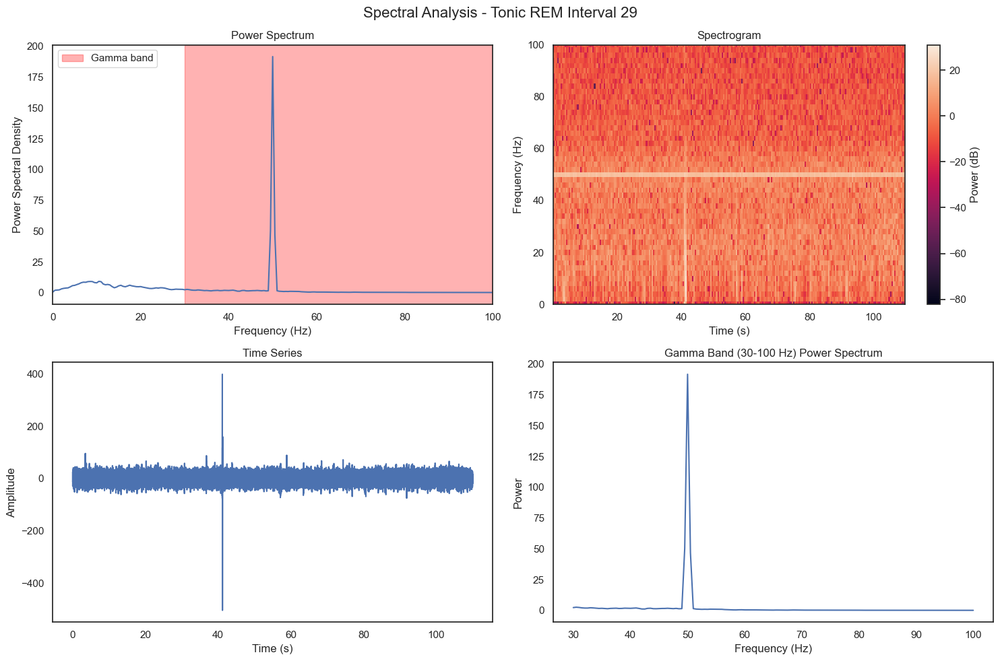

In [45]:
# Cell 7: Analyze tonic REM intervals  
print("\nANALYZING TONIC REM INTERVALS")
tonic_fast_signals, tonic_spectral_results = analyze_all_intervals(
    tonic_imfs_default, tonic_imfs_freqs_default, tonic_rem_lpf_default, "Tonic REM")

In [46]:
# Cell 8: Comparative analysis function
def comparative_analysis(phasic_results, tonic_results):
    """
    Compare spectral properties between phasic and tonic REM
    """
    if not phasic_results or not tonic_results:
        print("Not enough data for comparative analysis")
        return
    
    # Extract key metrics
    phasic_peak_freqs = [r['peak_frequency'] for r in phasic_results]
    tonic_peak_freqs = [r['peak_frequency'] for r in tonic_results]
    
    phasic_gamma_ratios = [r['gamma_ratio'] for r in phasic_results]
    tonic_gamma_ratios = [r['gamma_ratio'] for r in tonic_results]
    
    # Statistical comparison
    from scipy import stats
    
    print("\n" + "="*60)
    print("COMPARATIVE ANALYSIS: Phasic vs Tonic REM")
    print("="*60)
    
    # Peak frequency comparison
    if len(phasic_peak_freqs) > 1 and len(tonic_peak_freqs) > 1:
        t_stat, p_value = stats.ttest_ind(phasic_peak_freqs, tonic_peak_freqs)
        print(f"Peak frequency - Phasic: {np.mean(phasic_peak_freqs):.2f} Hz, "
              f"Tonic: {np.mean(tonic_peak_freqs):.2f} Hz")
        print(f"T-test: t={t_stat:.3f}, p={p_value:.3f}")
    
    # Gamma ratio comparison
    if len(phasic_gamma_ratios) > 1 and len(tonic_gamma_ratios) > 1:
        t_stat, p_value = stats.ttest_ind(phasic_gamma_ratios, tonic_gamma_ratios)
        print(f"Gamma ratio - Phasic: {np.mean(phasic_gamma_ratios):.4f}, "
              f"Tonic: {np.mean(tonic_gamma_ratios):.4f}")
        print(f"T-test: t={t_stat:.3f}, p={p_value:.3f}")
    
    # Plot comparative distributions
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Peak frequency distribution
    axes[0].boxplot([phasic_peak_freqs, tonic_peak_freqs], labels=['Phasic', 'Tonic'])
    axes[0].set_ylabel('Peak Frequency (Hz)')
    axes[0].set_title('Peak Frequency Distribution')
    
    # Gamma ratio distribution
    axes[1].boxplot([phasic_gamma_ratios, tonic_gamma_ratios], labels=['Phasic', 'Tonic'])
    axes[1].set_ylabel('Gamma/Total Power Ratio')
    axes[1].set_title('Gamma Power Ratio Distribution')
    
    plt.tight_layout()
    plt.show()


COMPARATIVE ANALYSIS: Phasic vs Tonic REM
Peak frequency - Phasic: 42.18 Hz, Tonic: 47.26 Hz
T-test: t=-1.147, p=0.259
Gamma ratio - Phasic: 0.3762, Tonic: 0.5697
T-test: t=-3.671, p=0.001


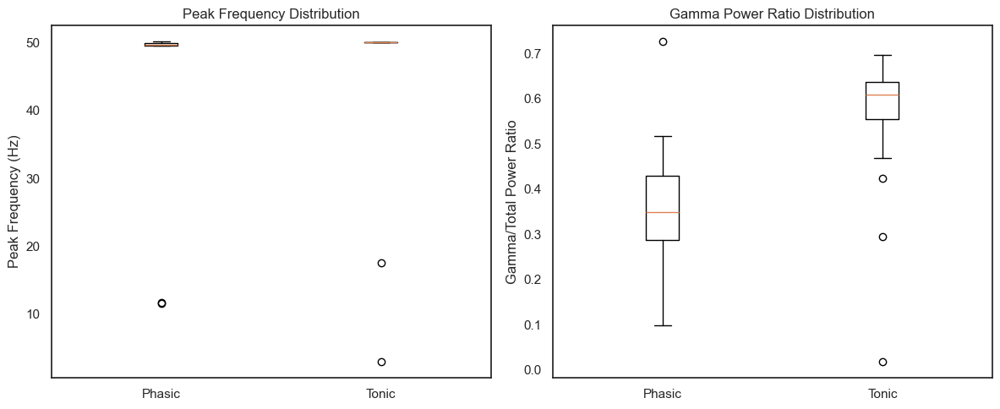

In [47]:
# Cell 9: Perform comparative analysis
comparative_analysis(phasic_spectral_results, tonic_spectral_results)

In [48]:
# Cell 10: Summary statistics
def print_summary_statistics(phasic_signals, tonic_signals, phasic_results, tonic_results):
    """
    Print summary statistics for the analysis
    """
    print("\n" + "="*60)
    print("SUMMARY STATISTICS")
    print("="*60)
    
    print(f"Phasic REM intervals analyzed: {len(phasic_signals)}")
    print(f"Tonic REM intervals analyzed: {len(tonic_signals)}")
    
    if phasic_results:
        avg_phasic_gamma = np.mean([r['gamma_ratio'] for r in phasic_results])
        print(f"Average gamma ratio (Phasic): {avg_phasic_gamma:.4f}")
    
    if tonic_results:
        avg_tonic_gamma = np.mean([r['gamma_ratio'] for r in tonic_results])
        print(f"Average gamma ratio (Tonic): {avg_tonic_gamma:.4f}")

print_summary_statistics(phasic_fast_signals, tonic_fast_signals, 
                        phasic_spectral_results, tonic_spectral_results)


SUMMARY STATISTICS
Phasic REM intervals analyzed: 10
Tonic REM intervals analyzed: 29
Average gamma ratio (Phasic): 0.3762
Average gamma ratio (Tonic): 0.5697


In [49]:
###----------------

In [50]:
# Cell 1: Modified EMD function with default settings
def extract_imfs_default(lfp, fs, interval, return_imfs_freqs=False, plot_imfs=True):
    all_imfs = []
    all_imf_freqs = []
    rem_lfp = []
    
    for ii in range(len(interval)):
        start_idx = int(interval.loc[ii, 'start'] * fs)
        end_idx = int(interval.loc[ii, 'end'] * fs)
        sig_part = lfp[start_idx:end_idx]
        sig = np.array(sig_part)

        rem_lfp.append(sig)

        try:
            # Use default EMD settings with basic threshold
            imf = emd.sift.sift(sig, imf_opts={'sd_thresh': 0.1})
        except Exception as e:
            print(f"EMD failed: {e}. Skipping this interval.")
            continue
            
        all_imfs.append(imf)
        
        # Plot IMFs for the first few intervals to show decomposition
        if plot_imfs and ii < 3:  # Plot only first 3 intervals to avoid too many plots
            plt.figure(figsize=(12, 8))
            emd.plotting.plot_imfs(imf[:2000], cmap=True)  # First 2000 samples for clarity
            plt.suptitle(f'{interval.name if hasattr(interval, "name") else "Interval"} {ii+1} - IMF Decomposition')
            plt.tight_layout()
            plt.show()
        
        # Calculate IMF frequencies using Hilbert transform
        IP, IF, IA = emd.spectra.frequency_transform(imf, fs, 'hilbert')
        all_imf_freqs.append(IF)

    if return_imfs_freqs:
        return all_imfs, all_imf_freqs, rem_lfp
    else:
        return all_imfs

EXTRACTING PHASIC REM IMFs WITH PLOTTING


<Figure size 1200x800 with 0 Axes>

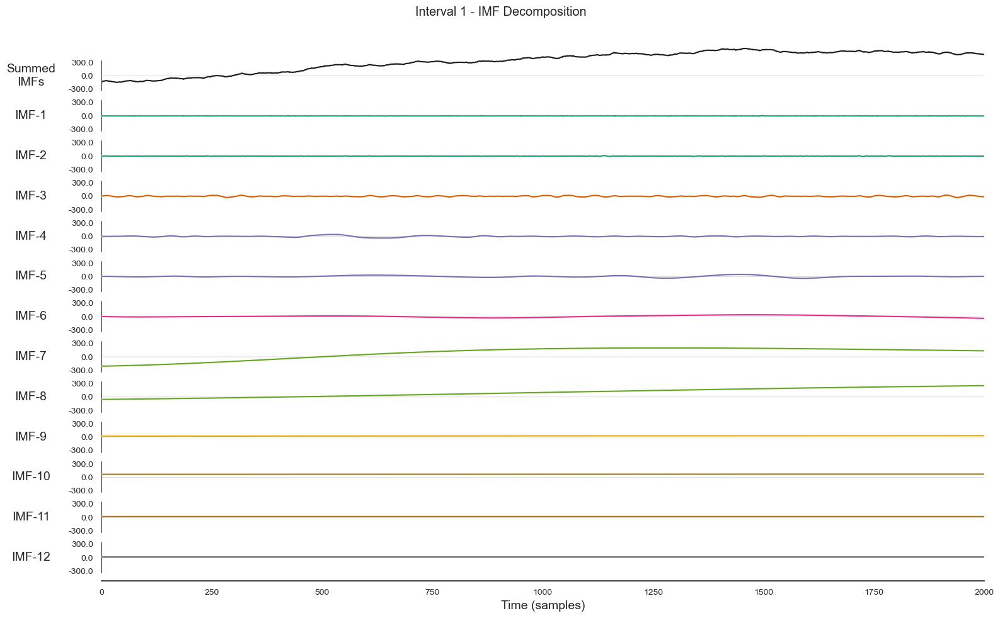

<Figure size 1200x800 with 0 Axes>

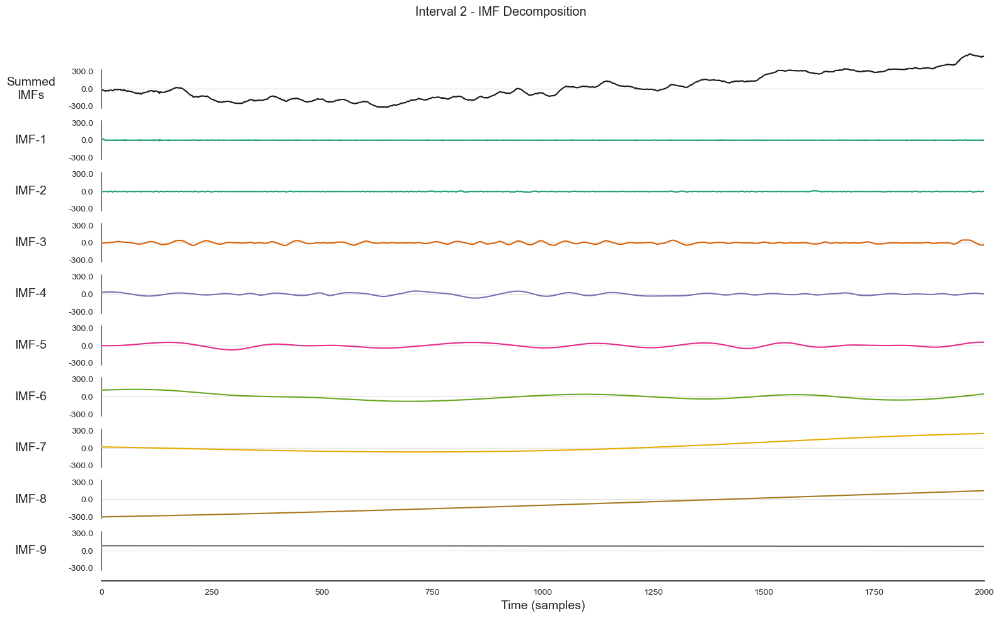

<Figure size 1200x800 with 0 Axes>

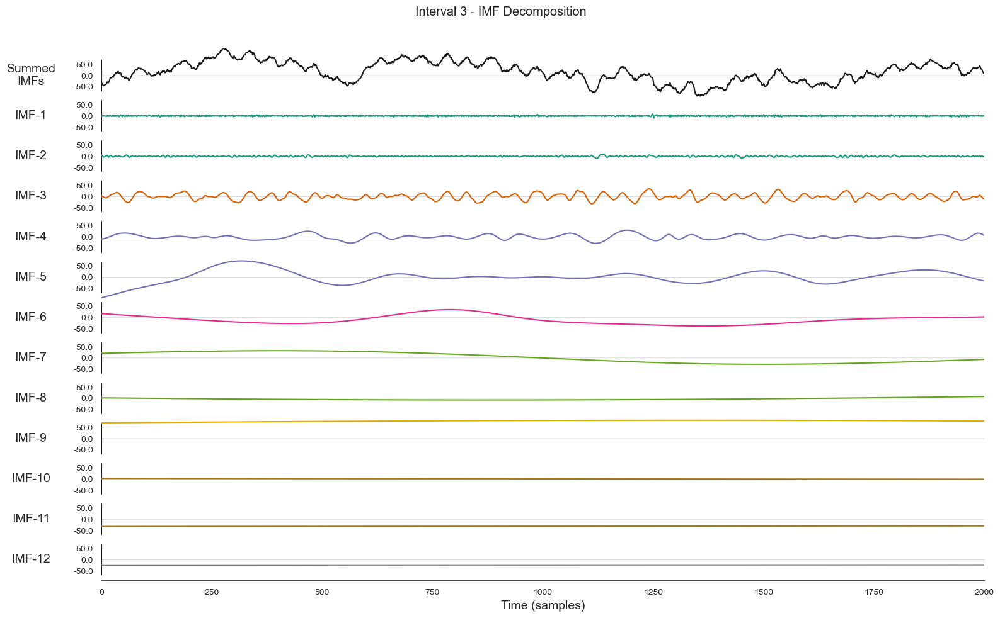


EXTRACTING TONIC REM IMFs WITH PLOTTING


<Figure size 1200x800 with 0 Axes>

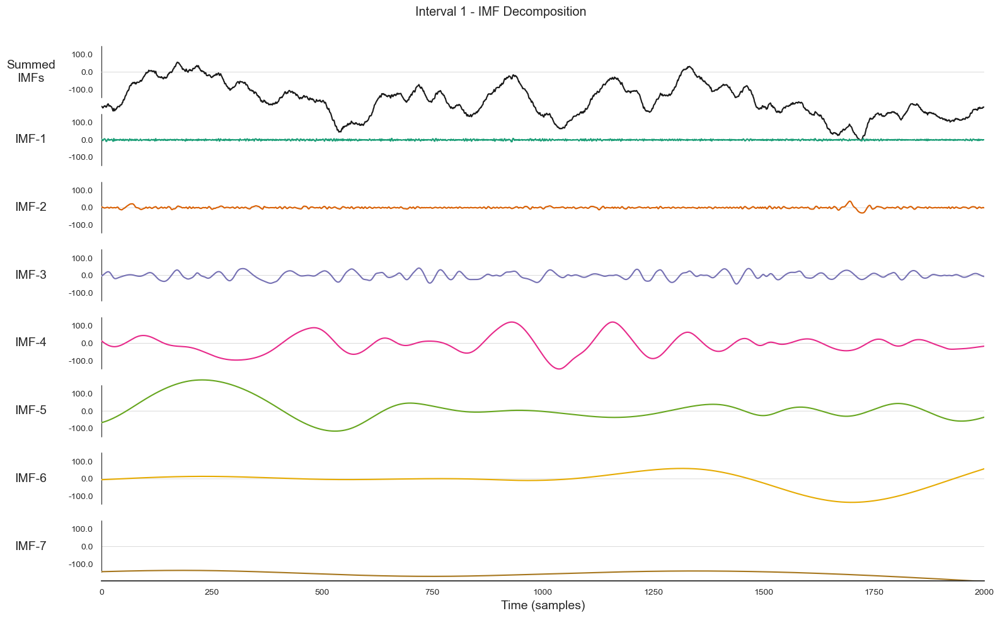

<Figure size 1200x800 with 0 Axes>

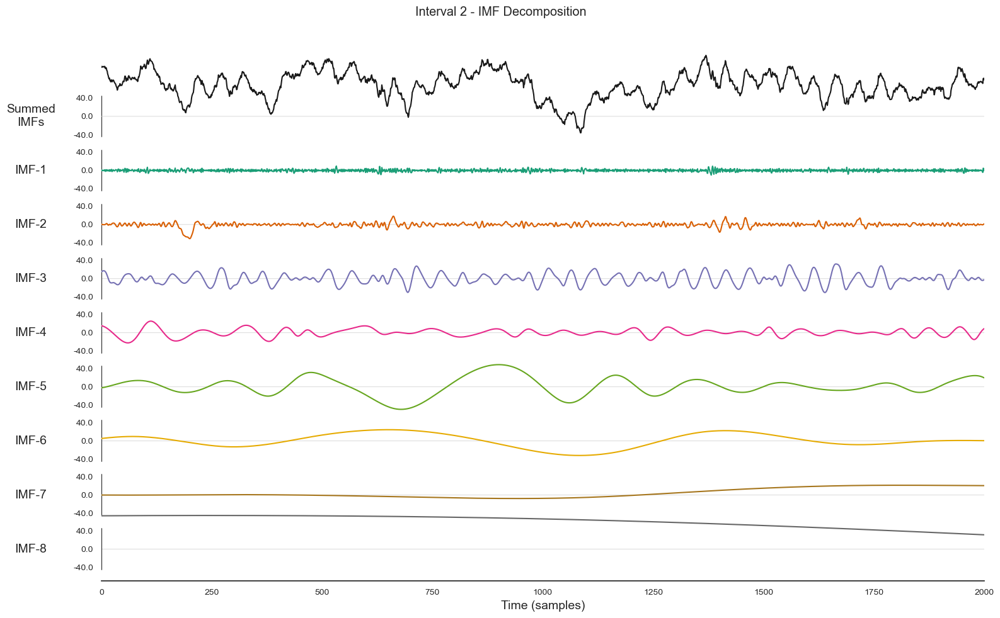

<Figure size 1200x800 with 0 Axes>

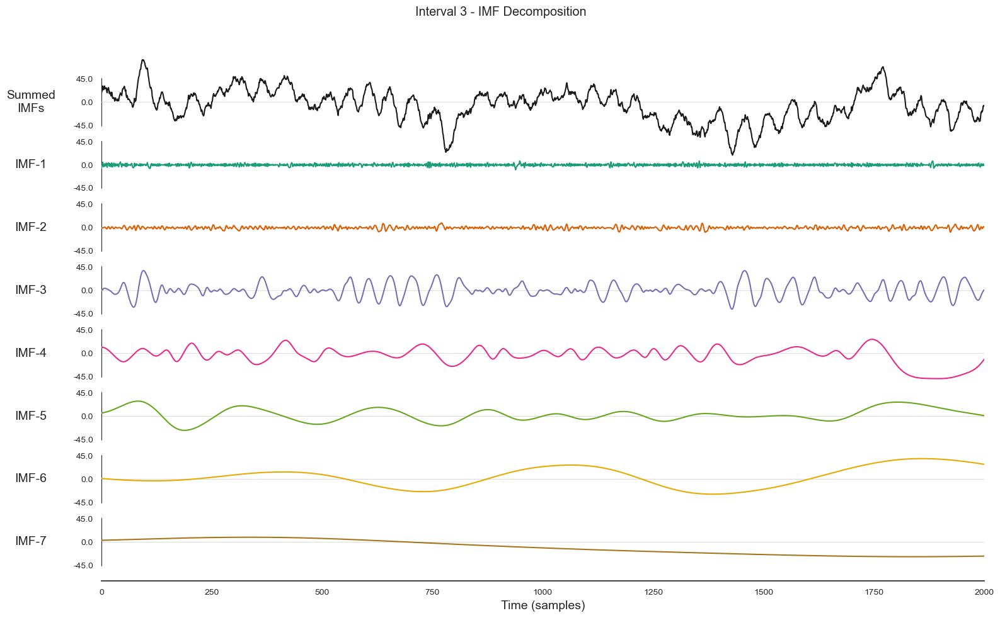

Phasic intervals processed: 29
Tonic intervals processed: 10


In [51]:
# Cell 2: Extract IMFs and plot decompositions
print("EXTRACTING PHASIC REM IMFs WITH PLOTTING")
phasic_imfs_default, phasic_imfs_freqs_default, phasic_rem_lpf_default = extract_imfs_default(
    lfp, fs, tonic_interval, return_imfs_freqs=True, plot_imfs=True)

print("\nEXTRACTING TONIC REM IMFs WITH PLOTTING")
tonic_imfs_default, tonic_imfs_freqs_default, tonic_rem_lpf_default = extract_imfs_default(
    lfp, fs, phasic_interval, return_imfs_freqs=True, plot_imfs=True)

print(f"Phasic intervals processed: {len(phasic_imfs_default)}")
print(f"Tonic intervals processed: {len(tonic_imfs_default)}")

In [52]:
# Cell 3: Function to sum components faster than 15Hz with component analysis
def sum_fast_components(imf, instantaneous_freq, threshold_freq=15, plot_components=True):
    """
    Sum IMF components that have mean instantaneous frequency faster than threshold_freq
    """
    fast_components_sum = np.zeros_like(imf[:, 0])
    fast_component_indices = []
    
    for comp_idx in range(imf.shape[1]):
        mean_freq = np.mean(instantaneous_freq[:, comp_idx])
        if mean_freq > threshold_freq:
            fast_components_sum += imf[:, comp_idx]
            fast_component_indices.append(comp_idx)
    
    # Plot the fast components
    if plot_components and fast_component_indices:
        time_axis = np.arange(imf.shape[0]) / 2500  # Assuming fs=2500
        
        plt.figure(figsize=(12, 8))
        
        # Plot original signal
        plt.subplot(len(fast_component_indices) + 2, 1, 1)
        plt.plot(time_axis, imf.sum(axis=1))
        plt.title('Original Signal (sum of all IMFs)')
        plt.ylabel('Amplitude')
        
        # Plot each fast component
        for i, comp_idx in enumerate(fast_component_indices):
            plt.subplot(len(fast_component_indices) + 2, 1, i + 2)
            plt.plot(time_axis, imf[:, comp_idx])
            mean_freq = np.mean(instantaneous_freq[:, comp_idx])
            plt.title(f'IMF-{comp_idx+1} (Mean freq: {mean_freq:.1f} Hz)')
            plt.ylabel('Amplitude')
        
        # Plot summed fast components
        plt.subplot(len(fast_component_indices) + 2, 1, len(fast_component_indices) + 2)
        plt.plot(time_axis, fast_components_sum)
        plt.title(f'Sum of Fast Components (> {threshold_freq} Hz)')
        plt.ylabel('Amplitude')
        plt.xlabel('Time (s)')
        
        plt.tight_layout()
        plt.show()
    
    return fast_components_sum, fast_component_indices

In [53]:
# Cell 4: Simple spectral analysis focusing on component frequencies
def analyze_component_frequencies(imf, instantaneous_freq, condition_name):
    """
    Simple analysis focusing on component frequencies
    """
    print(f"\n{'='*60}")
    print(f"COMPONENT FREQUENCY ANALYSIS: {condition_name}")
    print(f"{'='*60}")
    
    # Analyze each component
    gamma_components = []
    for comp_idx in range(imf.shape[1]):
        comp_freq = instantaneous_freq[:, comp_idx]
        mean_freq = np.mean(comp_freq)
        std_freq = np.std(comp_freq)
        
        print(f"IMF-{comp_idx+1}: Mean freq = {mean_freq:.1f} Hz, Std = {std_freq:.1f} Hz")
        
        # Check if in gamma range
        if 30 <= mean_freq <= 100:
            gamma_components.append(comp_idx)
            print(f"  → Gamma component detected!")
    
    return gamma_components

In [54]:
# Cell 5: Main analysis with emphasis on visualization
def main_analysis_with_plots(imfs_list, imf_freqs_list, condition_name):
    """
    Main analysis focusing on the plots your advisor wants
    """
    print(f"\n{'='*60}")
    print(f"ANALYZING: {condition_name}")
    print(f"{'='*60}")
    
    all_gamma_components = []
    
    for idx, (imf, instantaneous_freq) in enumerate(zip(imfs_list, imf_freqs_list)):
        if idx >= 2:  # Analyze only first 2 intervals to avoid information overload
            break
            
        print(f"\n--- {condition_name} Interval {idx+1} ---")
        
        # 1. Analyze component frequencies
        gamma_comps = analyze_component_frequencies(imf, instantaneous_freq, 
                                                  f"{condition_name} Interval {idx+1}")
        all_gamma_components.append(gamma_comps)
        
        # 2. Sum fast components with plotting
        fast_signal, fast_indices = sum_fast_components(imf, instantaneous_freq, 
                                                      threshold_freq=15, plot_components=True)
        
        # 3. Simple power analysis
        if fast_indices:
            total_power = np.sum(imf**2)
            fast_power = np.sum(fast_signal**2)
            gamma_ratio = fast_power / total_power
            
            print(f"Fast components power ratio: {gamma_ratio:.3f}")
            print(f"Gamma components found: {fast_indices}")
    
    return all_gamma_components


ANALYZING: Phasic REM

--- Phasic REM Interval 1 ---

COMPONENT FREQUENCY ANALYSIS: Phasic REM Interval 1
IMF-1: Mean freq = 557.3 Hz, Std = 274.3 Hz
IMF-2: Mean freq = 244.1 Hz, Std = 127.6 Hz
IMF-3: Mean freq = 65.5 Hz, Std = 53.4 Hz
  → Gamma component detected!
IMF-4: Mean freq = 29.1 Hz, Std = 18.9 Hz
IMF-5: Mean freq = 10.7 Hz, Std = 8.3 Hz
IMF-6: Mean freq = 4.7 Hz, Std = 2.5 Hz
IMF-7: Mean freq = 1.6 Hz, Std = 1.8 Hz
IMF-8: Mean freq = 0.5 Hz, Std = 0.6 Hz
IMF-9: Mean freq = 0.2 Hz, Std = 0.3 Hz
IMF-10: Mean freq = 0.1 Hz, Std = 0.1 Hz
IMF-11: Mean freq = 0.0 Hz, Std = 0.0 Hz
IMF-12: Mean freq = 0.0 Hz, Std = 0.0 Hz


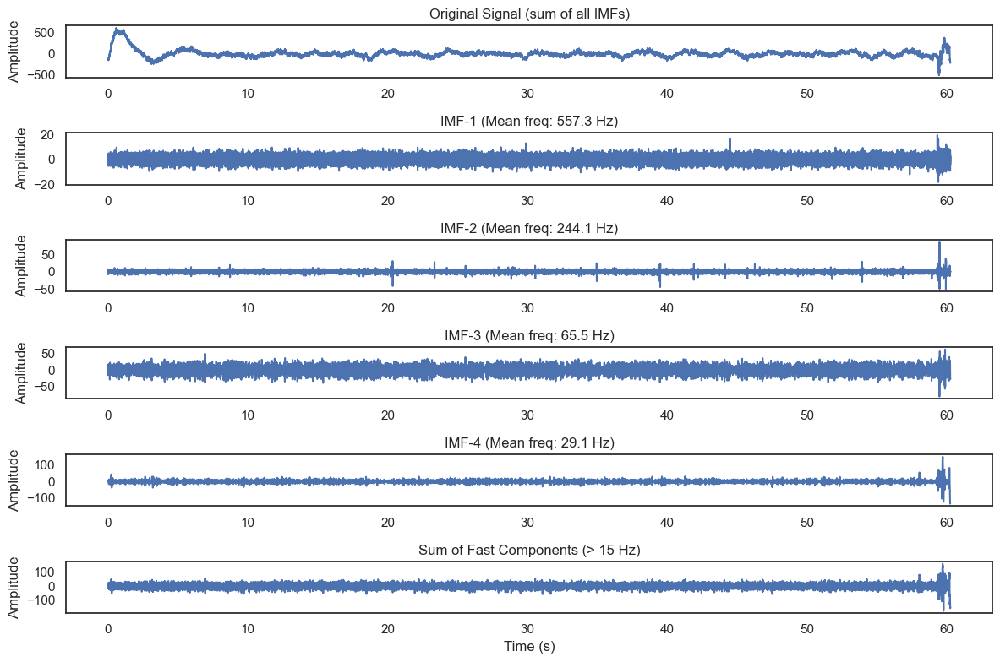

Fast components power ratio: 0.037
Gamma components found: [0, 1, 2, 3]

--- Phasic REM Interval 2 ---

COMPONENT FREQUENCY ANALYSIS: Phasic REM Interval 2
IMF-1: Mean freq = 558.4 Hz, Std = 259.3 Hz
IMF-2: Mean freq = 216.4 Hz, Std = 153.7 Hz
IMF-3: Mean freq = 55.6 Hz, Std = 49.6 Hz
  → Gamma component detected!
IMF-4: Mean freq = 25.8 Hz, Std = 16.9 Hz
IMF-5: Mean freq = 4.7 Hz, Std = 11.6 Hz
IMF-6: Mean freq = 1.7 Hz, Std = 4.2 Hz
IMF-7: Mean freq = 1.0 Hz, Std = 0.9 Hz
IMF-8: Mean freq = 0.2 Hz, Std = 0.6 Hz
IMF-9: Mean freq = 0.1 Hz, Std = 0.1 Hz


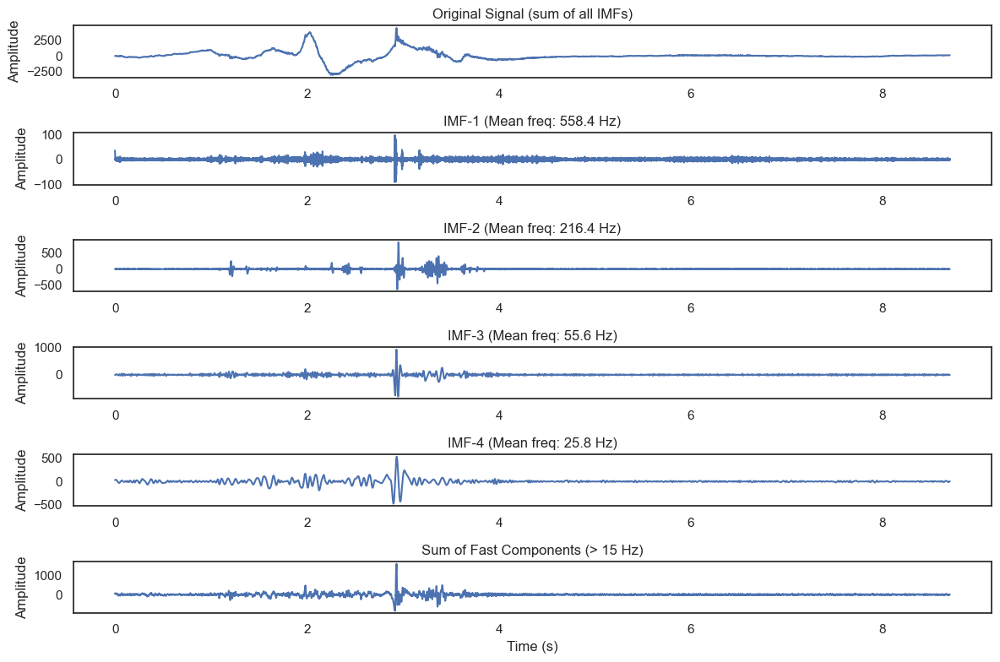

Fast components power ratio: 0.009
Gamma components found: [0, 1, 2, 3]

ANALYZING: Tonic REM

--- Tonic REM Interval 1 ---

COMPONENT FREQUENCY ANALYSIS: Tonic REM Interval 1
IMF-1: Mean freq = 518.1 Hz, Std = 267.5 Hz
IMF-2: Mean freq = 204.5 Hz, Std = 134.9 Hz
IMF-3: Mean freq = 53.2 Hz, Std = 48.2 Hz
  → Gamma component detected!
IMF-4: Mean freq = 17.0 Hz, Std = 12.6 Hz
IMF-5: Mean freq = 6.8 Hz, Std = 4.3 Hz
IMF-6: Mean freq = 1.9 Hz, Std = 1.9 Hz
IMF-7: Mean freq = -0.0 Hz, Std = 1.5 Hz


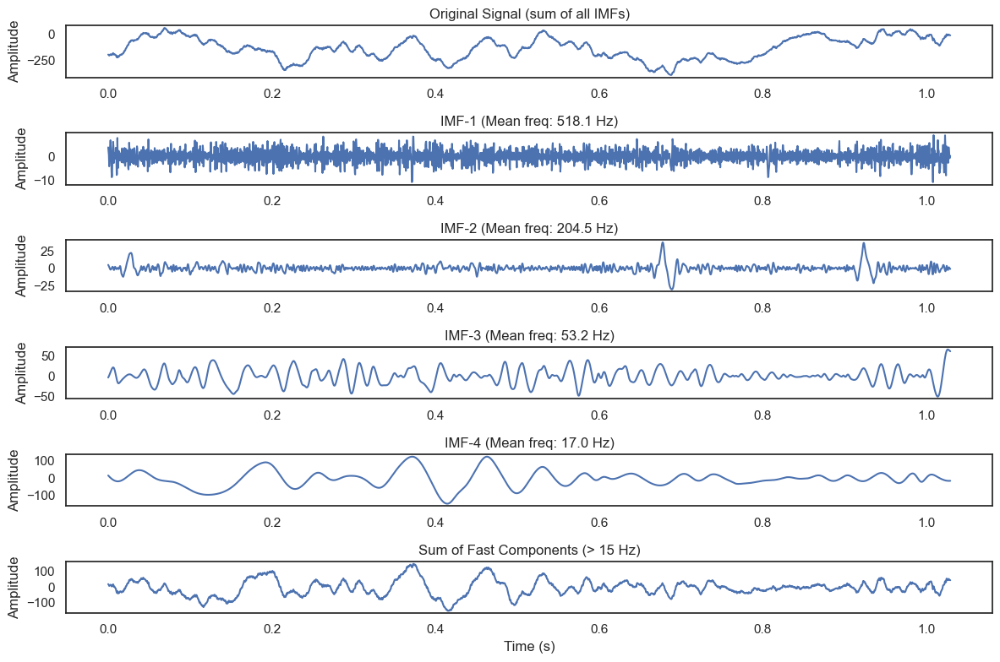

Fast components power ratio: 0.053
Gamma components found: [0, 1, 2, 3]

--- Tonic REM Interval 2 ---

COMPONENT FREQUENCY ANALYSIS: Tonic REM Interval 2
IMF-1: Mean freq = 531.5 Hz, Std = 275.0 Hz
IMF-2: Mean freq = 189.3 Hz, Std = 150.0 Hz
IMF-3: Mean freq = 58.1 Hz, Std = 41.1 Hz
  → Gamma component detected!
IMF-4: Mean freq = 23.5 Hz, Std = 15.6 Hz
IMF-5: Mean freq = 7.4 Hz, Std = 5.4 Hz
IMF-6: Mean freq = 2.7 Hz, Std = 7.5 Hz
IMF-7: Mean freq = 0.6 Hz, Std = 0.7 Hz
IMF-8: Mean freq = 0.6 Hz, Std = 0.6 Hz


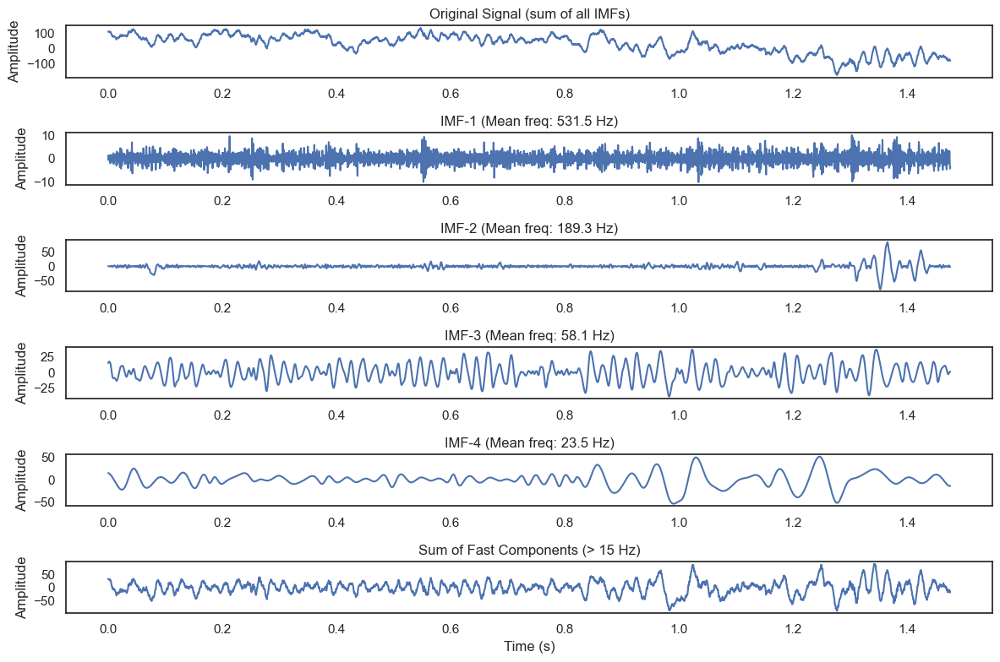

Fast components power ratio: 0.163
Gamma components found: [0, 1, 2, 3]


In [55]:
# Cell 6: Analyze phasic REM
phasic_gamma_comps = main_analysis_with_plots(phasic_imfs_default, phasic_imfs_freqs_default, "Phasic REM")

# Cell 7: Analyze tonic REM  
tonic_gamma_comps = main_analysis_with_plots(tonic_imfs_default, tonic_imfs_freqs_default, "Tonic REM")

In [56]:
#### doing EMD of summ the components which are faster that 15hz in Whole SINGAL NOT TONIC AND PAHSIC

In [57]:
# Cell 1: EMD on entire PFC signal
print("PERFORMING EMD ON ENTIRE PFC SIGNAL")
print("="*50)

# Use the entire LFP signal
whole_signal = lfpPFC  # Your complete PFC signal

# Perform EMD with default settings
imf_whole = emd.sift.sift(whole_signal, imf_opts={'sd_thresh': 0.1})

print(f"Signal length: {len(whole_signal)} samples ({len(whole_signal)/2500:.1f} seconds)")
print(f"Number of IMFs extracted: {imf_whole.shape[1]}")

PERFORMING EMD ON ENTIRE PFC SIGNAL
Signal length: 27037838 samples (10815.1 seconds)
Number of IMFs extracted: 13


<Figure size 1500x1000 with 0 Axes>

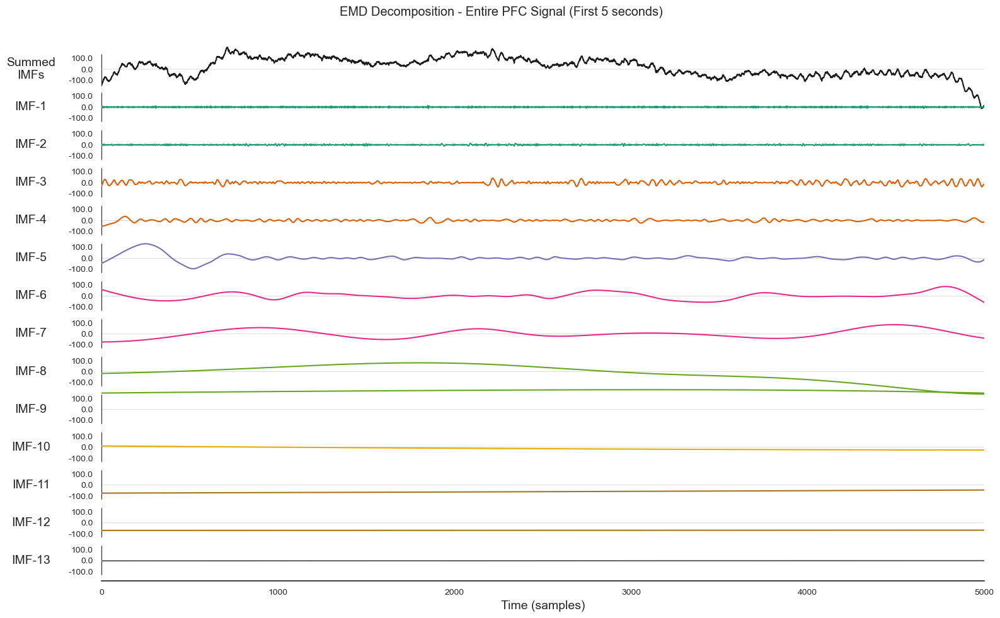

In [58]:
# Cell 2: Plot IMFs for the whole signal
plt.figure(figsize=(15, 10))
emd.plotting.plot_imfs(imf_whole[:5000], cmap=True)  # First 5 seconds for clarity
plt.suptitle('EMD Decomposition - Entire PFC Signal (First 5 seconds)')
plt.tight_layout()
plt.show()

In [61]:
##- previous code wasnt complete

SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION
Total REM intervals: 10
Total REM duration: 195.00 seconds

First few combined intervals:
  index    start    end
      0       10     25
      1       30     45
      2       50     75
      3       80     95
      4      110    130
      5      140    165
      6      190    220
      7      230    245
      8      250    265
      9      270    290
shape: (10, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 10.00s to 25.00s added.
Segment from 30.00s to 45.00s added.
Segment from 50.00s to 75.00s added.
Segment from 80.00s to 95.00s added.
Segment from 110.00s to 130.00s added.
Segment from 140.00s to 165.00s added.
Segment from 190.00s to 220.00s added.
Segment from 230.00s to 245.00s added.
Segment from 250.00s to 265.00s added.
Segment from 270.00s to 290.00s added.

Total length of combined signal: 195.00 seconds

PERFORMING EMD ON THE WHOLE COMBINED SIGNAL
✓ Successfully extracted 8 IMFs from the whole signal.

P

<Figure size 1400x1000 with 0 Axes>

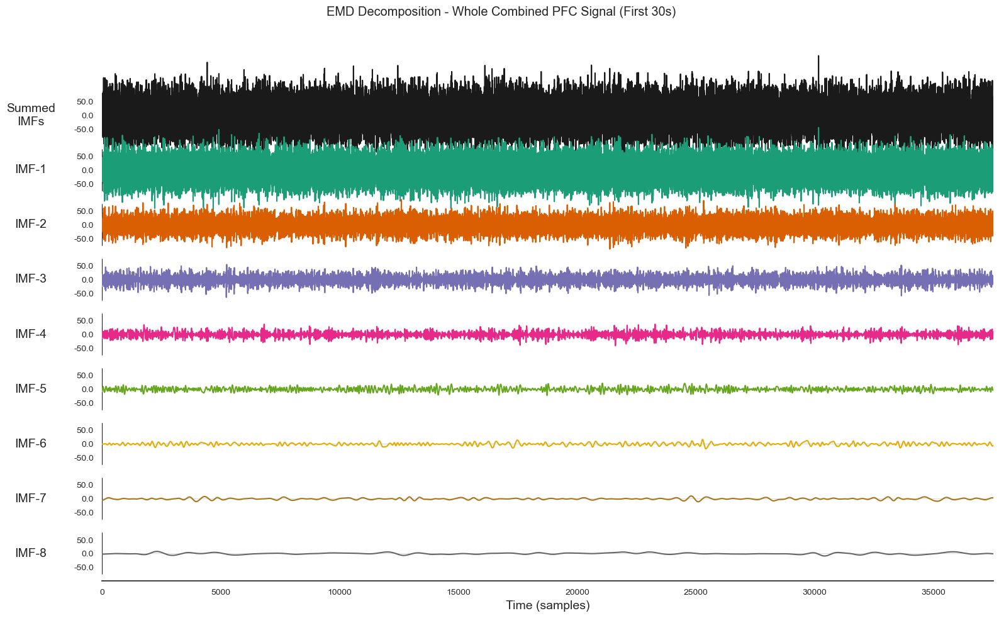


FREQUENCY ANALYSIS - ALL COMPONENTS
IMF-1: 101.3 ± 85.6 Hz → High Frequency
IMF-2: 131.8 ± 44.0 Hz → High Frequency
IMF-3:  68.1 ± 29.8 Hz → GAMMA
IMF-4:  28.6 ± 14.4 Hz → Beta
IMF-5:  11.9 ±  6.5 Hz → Alpha/Beta
IMF-6:   5.0 ±  2.8 Hz → Theta
IMF-7:   2.2 ±  1.2 Hz → Delta
IMF-8:   0.6 ±  1.0 Hz → Delta

Gamma components found: ['IMF-3']

EXTRACTING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 1 IMFs.

VISUALIZING GAMMA COMPONENTS (First 5 seconds)


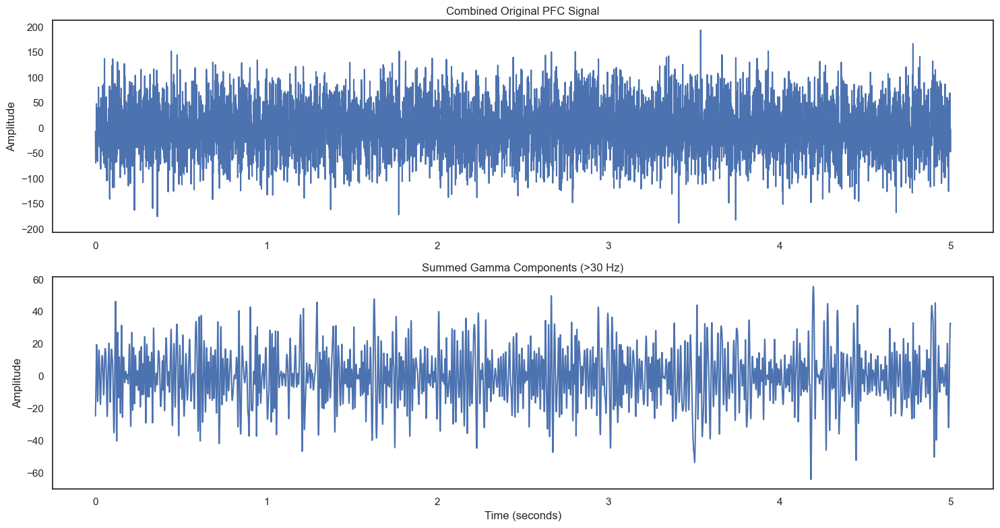


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 57.4 Hz
Gamma/Total Power Ratio: 0.849


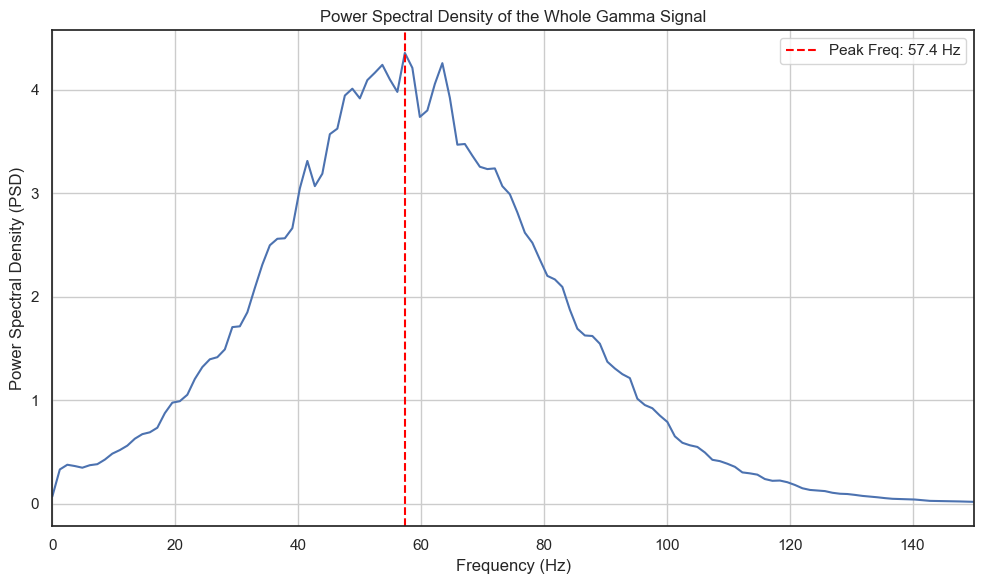

In [64]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA
# ==============================================================================
# Note: You should replace this with your actual data loading
# This placeholder data mimics your variables for a runnable example.

print("SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION")
print("="*60)

fs = 1250.0  # Sample frequency
duration_sec = 300  # Total duration of the LFP signal
lfpPFC = np.random.randn(int(duration_sec * fs)) * 50  # Mock LFP signal

# Create mock tonic and phasic intervals (in seconds)
tonic_intervals = nap.IntervalSet(
    start=np.array([10, 50, 110, 190, 250]),
    end=np.array([25, 75, 130, 220, 265])
)
phasic_intervals = nap.IntervalSet(
    start=np.array([30, 80, 140, 230, 270]),
    end=np.array([45, 95, 165, 245, 290])
)

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. PLOT IMFS FOR A SECTION OF THE WHOLE SIGNAL
# ==============================================================================
print("\nPLOTTING IMF DECOMPOSITION (First 30 seconds)")
print("="*60)

plt.figure(figsize=(14, 10))
# Plot the first 30 seconds (or the full signal if it's shorter)
samples_to_plot = min(int(30 * fs), imfs_whole_signal.shape[0])
emd.plotting.plot_imfs(imfs_whole_signal[:samples_to_plot], cmap=True)
plt.suptitle('EMD Decomposition - Whole Combined PFC Signal (First 30s)')
plt.tight_layout()
plt.show()


# ==============================================================================
# 4. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

for comp_idx in range(imfs_whole_signal.shape[1]):
    comp_freq = IF_whole[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif 15 <= mean_freq < 30:
        classification = "Beta"
    elif 30 <= mean_freq <= 100:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    else:
        classification = "High Frequency"
        
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 5. EXTRACT GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(imfs_whole_signal[:, 0])

for comp_idx in gamma_components_indices:
    gamma_signal_whole += imfs_whole_signal[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 6. VISUALIZE GAMMA COMPONENTS
# ==============================================================================
print("\nVISUALIZING GAMMA COMPONENTS (First 5 seconds)")
print("="*60)

# Plot the first 5 seconds
samples_5sec = min(int(5 * fs), len(combined_signal))
time_axis = np.arange(samples_5sec) / fs

plt.figure(figsize=(15, 8))

# Plot 1: Original signal
plt.subplot(2, 1, 1)
plt.plot(time_axis, combined_signal[:samples_5sec])
plt.title('Combined Original PFC Signal')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal
plt.subplot(2, 1, 2)
plt.plot(time_axis, gamma_signal_whole[:samples_5sec])
plt.title('Summed Gamma Components (>30 Hz)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 7. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # Calculate gamma ratio
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 30) & (freqs <= 100)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 150])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    plt.title('Power Spectral Density of the Whole Gamma Signal')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")


SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION
Total REM intervals: 10
Total REM duration: 195.00 seconds

First few combined intervals:
  index    start    end
      0       10     25
      1       30     45
      2       50     75
      3       80     95
      4      110    130
      5      140    165
      6      190    220
      7      230    245
      8      250    265
      9      270    290
shape: (10, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 10.00s to 25.00s added.
Segment from 30.00s to 45.00s added.
Segment from 50.00s to 75.00s added.
Segment from 80.00s to 95.00s added.
Segment from 110.00s to 130.00s added.
Segment from 140.00s to 165.00s added.
Segment from 190.00s to 220.00s added.
Segment from 230.00s to 245.00s added.
Segment from 250.00s to 265.00s added.
Segment from 270.00s to 290.00s added.

Total length of combined signal: 195.00 seconds

PERFORMING EMD ON THE WHOLE COMBINED SIGNAL
✓ Successfully extracted 8 IMFs from the whole signal.

P

<Figure size 1400x1000 with 0 Axes>

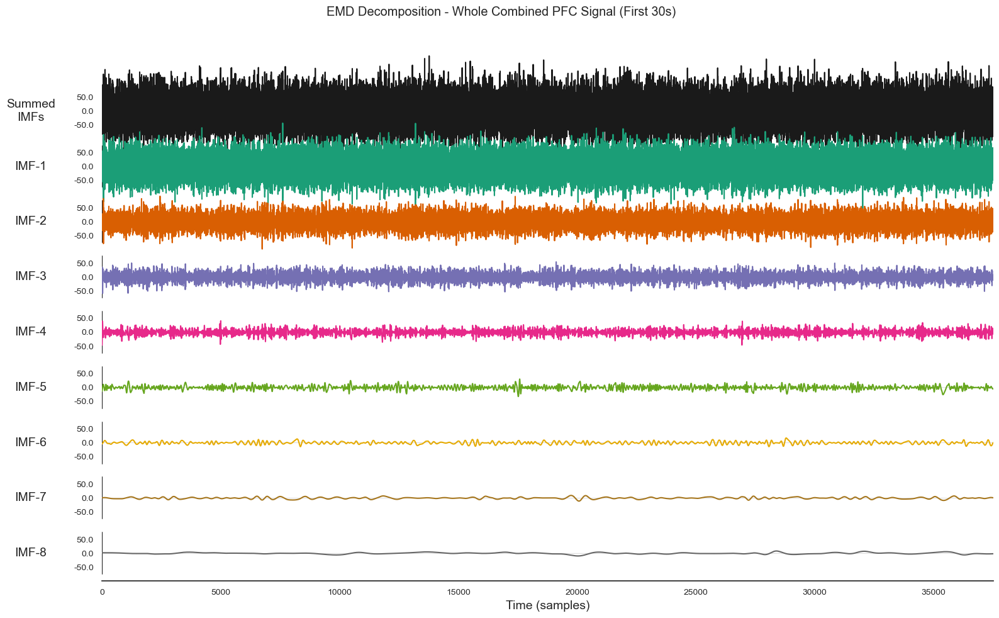


FREQUENCY ANALYSIS - ALL COMPONENTS
IMF-1: 100.9 ± 86.1 Hz → High Frequency
IMF-2: 131.7 ± 44.1 Hz → High Frequency
IMF-3:  67.6 ± 29.9 Hz → GAMMA
IMF-4:  28.3 ± 14.1 Hz → Beta
IMF-5:  11.9 ±  6.6 Hz → Alpha/Beta
IMF-6:   5.0 ±  2.8 Hz → Theta
IMF-7:   2.0 ±  1.2 Hz → Delta
IMF-8:   0.5 ±  1.0 Hz → Delta

Gamma components found: ['IMF-3']

EXTRACTING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 1 IMFs.

VISUALIZING GAMMA COMPONENTS (First 5 seconds)


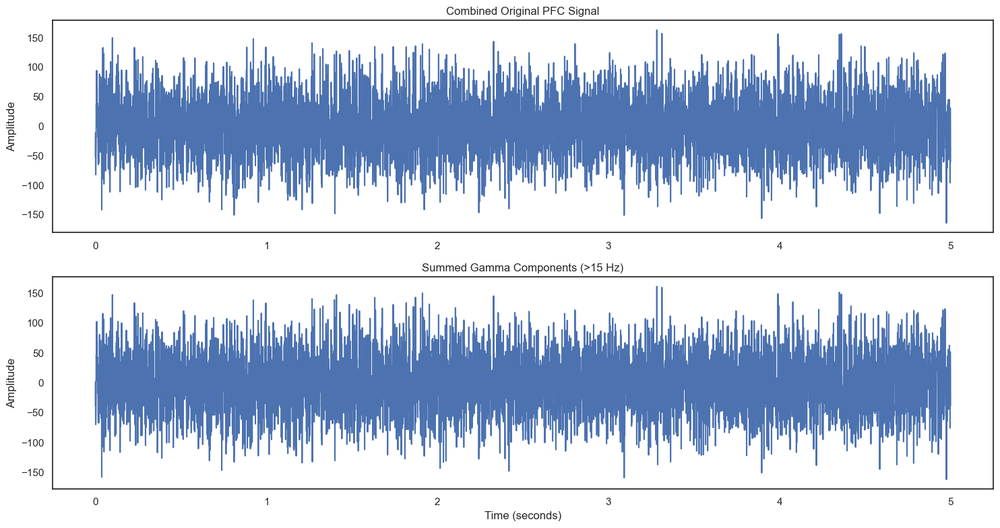


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 511.5 Hz
Gamma (>15Hz)/Total Power Ratio: 0.133


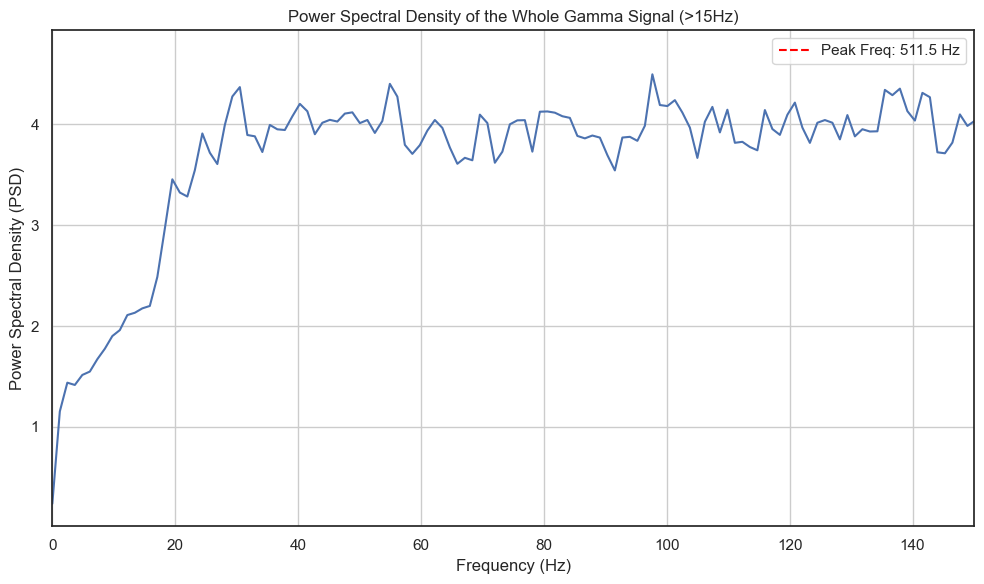

In [65]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA
# ==============================================================================
# Note: You should replace this with your actual data loading
# This placeholder data mimics your variables for a runnable example.

print("SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION")
print("="*60)

fs = 1250.0  # Sample frequency
duration_sec = 300  # Total duration of the LFP signal
lfpPFC = np.random.randn(int(duration_sec * fs)) * 50  # Mock LFP signal

# Create mock tonic and phasic intervals (in seconds)
tonic_intervals = nap.IntervalSet(
    start=np.array([10, 50, 110, 190, 250]),
    end=np.array([25, 75, 130, 220, 265])
)
phasic_intervals = nap.IntervalSet(
    start=np.array([30, 80, 140, 230, 270]),
    end=np.array([45, 95, 165, 245, 290])
)

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. PLOT IMFS FOR A SECTION OF THE WHOLE SIGNAL
# ==============================================================================
print("\nPLOTTING IMF DECOMPOSITION (First 30 seconds)")
print("="*60)

plt.figure(figsize=(14, 10))
# Plot the first 30 seconds (or the full signal if it's shorter)
samples_to_plot = min(int(30 * fs), imfs_whole_signal.shape[0])
emd.plotting.plot_imfs(imfs_whole_signal[:samples_to_plot], cmap=True)
plt.suptitle('EMD Decomposition - Whole Combined PFC Signal (First 30s)')
plt.tight_layout()
plt.show()


# ==============================================================================
# 4. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

for comp_idx in range(imfs_whole_signal.shape[1]):
    comp_freq = IF_whole[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif 15 <= mean_freq < 30:
        classification = "Beta"
    elif 15 <= mean_freq <= 100:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    else:
        classification = "High Frequency"
        
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 5. EXTRACT GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(imfs_whole_signal[:, 0])

# Sum all components with mean frequency greater than 15 Hz
for comp_idx in range(imfs_whole_signal.shape[1]):
    mean_freq = np.mean(IF_whole[:, comp_idx][IF_whole[:, comp_idx] < 200]) # Re-calculate mean freq
    if mean_freq > 15:
        gamma_signal_whole += imfs_whole_signal[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 6. VISUALIZE GAMMA COMPONENTS
# ==============================================================================
print("\nVISUALIZING GAMMA COMPONENTS (First 5 seconds)")
print("="*60)

# Plot the first 5 seconds
samples_5sec = min(int(5 * fs), len(combined_signal))
time_axis = np.arange(samples_5sec) / fs

plt.figure(figsize=(15, 8))

# Plot 1: Original signal
plt.subplot(2, 1, 1)
plt.plot(time_axis, combined_signal[:samples_5sec])
plt.title('Combined Original PFC Signal')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal
plt.subplot(2, 1, 2)
plt.plot(time_axis, gamma_signal_whole[:samples_5sec])
plt.title('Summed Gamma Components (>15 Hz)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 7. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # Calculate gamma ratio for >15 Hz
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 15) & (freqs <= 100)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma (>15Hz)/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 150])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    plt.title('Power Spectral Density of the Whole Gamma Signal (>15Hz)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")


SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION
Total REM intervals: 10
Total REM duration: 195.00 seconds

First few combined intervals:
  index    start    end
      0       10     25
      1       30     45
      2       50     75
      3       80     95
      4      110    130
      5      140    165
      6      190    220
      7      230    245
      8      250    265
      9      270    290
shape: (10, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 10.00s to 25.00s added.
Segment from 30.00s to 45.00s added.
Segment from 50.00s to 75.00s added.
Segment from 80.00s to 95.00s added.
Segment from 110.00s to 130.00s added.
Segment from 140.00s to 165.00s added.
Segment from 190.00s to 220.00s added.
Segment from 230.00s to 245.00s added.
Segment from 250.00s to 265.00s added.
Segment from 270.00s to 290.00s added.

Total length of combined signal: 195.00 seconds

PERFORMING EMD ON THE WHOLE COMBINED SIGNAL
✓ Successfully extracted 8 IMFs from the whole signal.

F

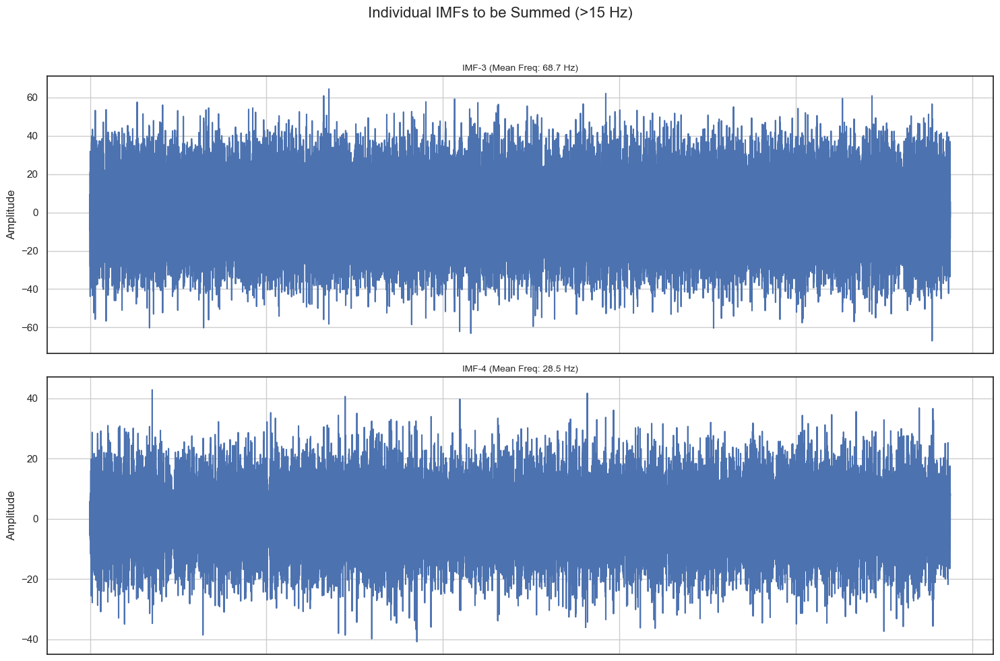


EXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 2 IMFs.

VISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)


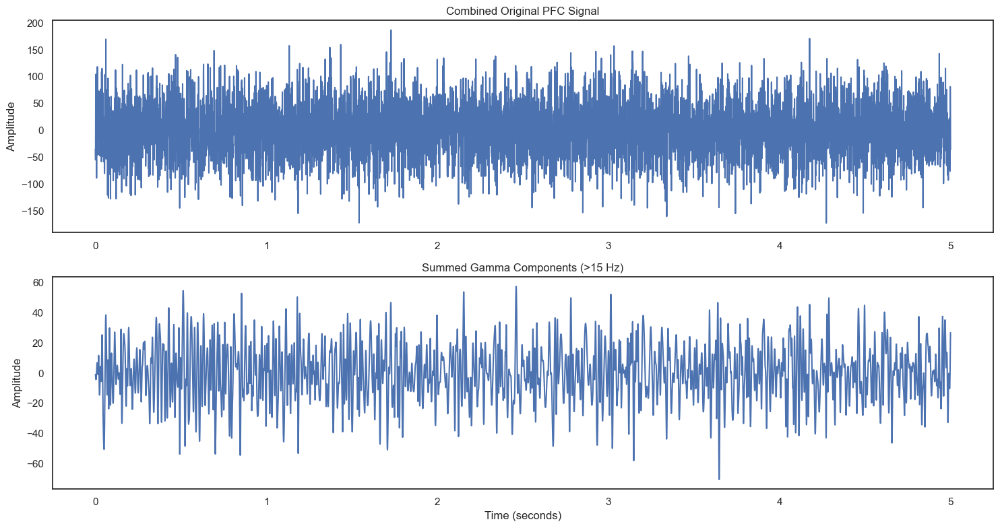


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 35.4 Hz
Gamma (>15Hz)/Total Power Ratio: 0.909


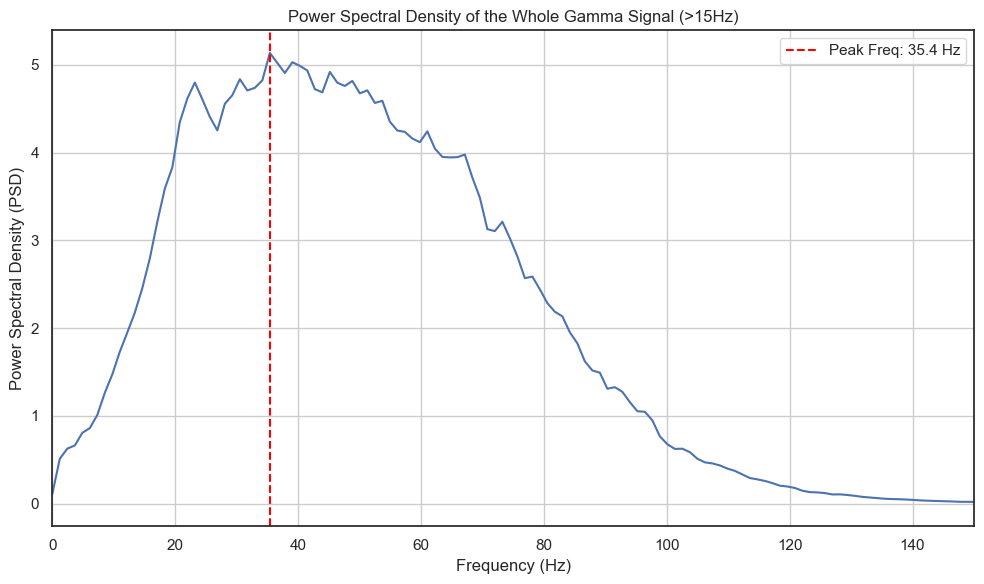

In [66]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA
# ==============================================================================
# Note: You should replace this with your actual data loading
# This placeholder data mimics your variables for a runnable example.

print("SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION")
print("="*60)

fs = 1250.0  # Sample frequency
duration_sec = 300  # Total duration of the LFP signal
lfpPFC = np.random.randn(int(duration_sec * fs)) * 50  # Mock LFP signal

# Create mock tonic and phasic intervals (in seconds)
tonic_intervals = nap.IntervalSet(
    start=np.array([10, 50, 110, 190, 250]),
    end=np.array([25, 75, 130, 220, 265])
)
phasic_intervals = nap.IntervalSet(
    start=np.array([30, 80, 140, 230, 270]),
    end=np.array([45, 95, 165, 245, 290])
)

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

for comp_idx in range(imfs_whole_signal.shape[1]):
    comp_freq = IF_whole[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    # CORRECTED: Use 15 Hz as the threshold for gamma
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif 15 <= mean_freq <= 100:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    else:
        classification = "High Frequency"
        
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 4. VISUALIZING THE IMFs TO BE SUMMED
# ==============================================================================
print("\nVISUALIZING COMPONENTS TO BE SUMMED")
print("="*60)

if len(gamma_components_indices) > 0:
    plt.figure(figsize=(15, 10))
    plt.suptitle('Individual IMFs to be Summed (>15 Hz)', fontsize=16)

    # Plot each gamma component in a separate subplot
    for i, comp_idx in enumerate(gamma_components_indices):
        plt.subplot(len(gamma_components_indices), 1, i + 1)
        plt.plot(imfs_whole_signal[:, comp_idx], 'b')
        mean_freq = np.mean(IF_whole[:, comp_idx])
        plt.title(f'IMF-{comp_idx+1} (Mean Freq: {mean_freq:.1f} Hz)', fontsize=10)
        plt.ylabel('Amplitude')
        plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
        plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ==============================================================================
# 5. EXTRACT AND SUM GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(imfs_whole_signal[:, 0])

# Sum all components identified as gamma
for comp_idx in gamma_components_indices:
    gamma_signal_whole += imfs_whole_signal[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 6. VISUALIZE THE FINAL SUMMED GAMMA SIGNAL
# ==============================================================================
print("\nVISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)")
print("="*60)

# Plot the first 5 seconds
samples_5sec = min(int(5 * fs), len(combined_signal))
time_axis = np.arange(samples_5sec) / fs

plt.figure(figsize=(15, 8))

# Plot 1: Original signal
plt.subplot(2, 1, 1)
plt.plot(time_axis, combined_signal[:samples_5sec])
plt.title('Combined Original PFC Signal')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal
plt.subplot(2, 1, 2)
plt.plot(time_axis, gamma_signal_whole[:samples_5sec])
plt.title('Summed Gamma Components (>15 Hz)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 7. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # CORRECTED: Use a gamma mask starting at 15 Hz
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 15) & (freqs <= 100)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma (>15Hz)/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 150])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    # CORRECTED: Update plot title to reflect the >15 Hz threshold
    plt.title('Power Spectral Density of the Whole Gamma Signal (>15Hz)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")


SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION
Total REM intervals: 10
Total REM duration: 195.00 seconds

First few combined intervals:
  index    start    end
      0       10     25
      1       30     45
      2       50     75
      3       80     95
      4      110    130
      5      140    165
      6      190    220
      7      230    245
      8      250    265
      9      270    290
shape: (10, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 10.00s to 25.00s added.
Segment from 30.00s to 45.00s added.
Segment from 50.00s to 75.00s added.
Segment from 80.00s to 95.00s added.
Segment from 110.00s to 130.00s added.
Segment from 140.00s to 165.00s added.
Segment from 190.00s to 220.00s added.
Segment from 230.00s to 245.00s added.
Segment from 250.00s to 265.00s added.
Segment from 270.00s to 290.00s added.

Total length of combined signal: 195.00 seconds

PERFORMING EMD ON THE WHOLE COMBINED SIGNAL
✓ Successfully extracted 8 IMFs from the whole signal.

P

<Figure size 1400x1000 with 0 Axes>

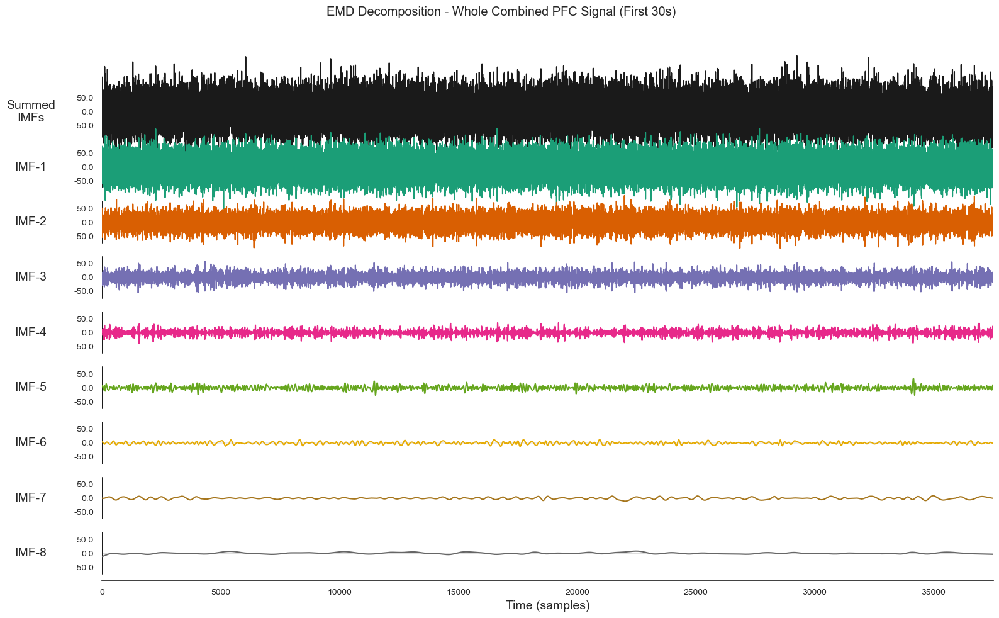


FREQUENCY ANALYSIS - ALL COMPONENTS
IMF-1: 102.3 ± 84.5 Hz → High Frequency
IMF-2: 132.2 ± 44.1 Hz → High Frequency
IMF-3:  68.1 ± 29.5 Hz → GAMMA
IMF-4:  28.8 ± 14.7 Hz → GAMMA
IMF-5:  12.2 ±  6.4 Hz → Alpha/Beta
IMF-6:   5.0 ±  2.9 Hz → Theta
IMF-7:   2.0 ±  1.6 Hz → Delta
IMF-8:   0.5 ±  0.7 Hz → Delta

Gamma components found: ['IMF-3', 'IMF-4']

VISUALIZING COMPONENTS TO BE SUMMED


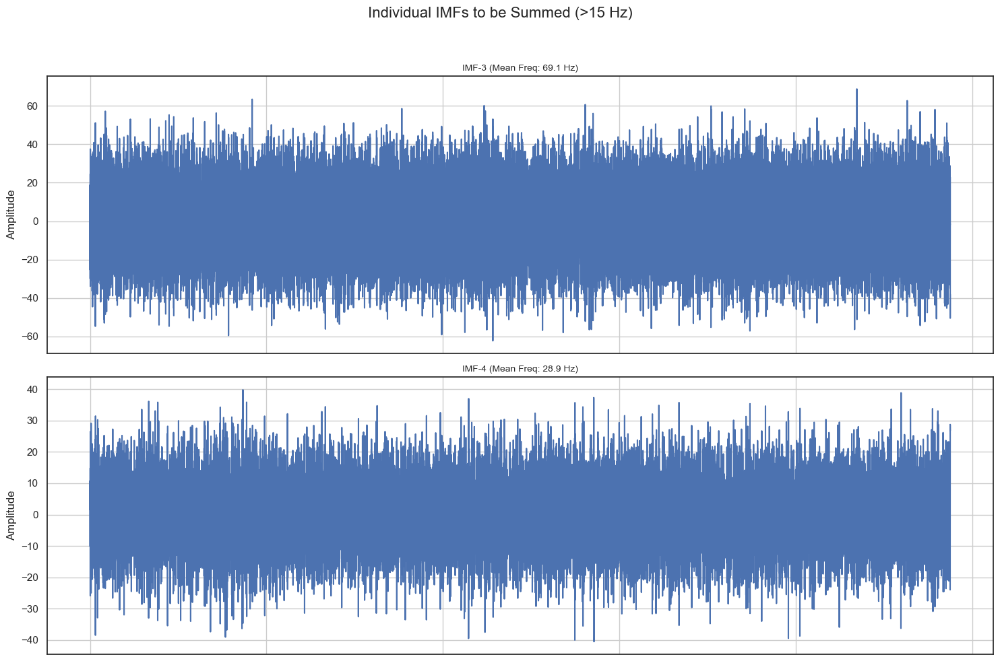


EXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 2 IMFs.

VISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)


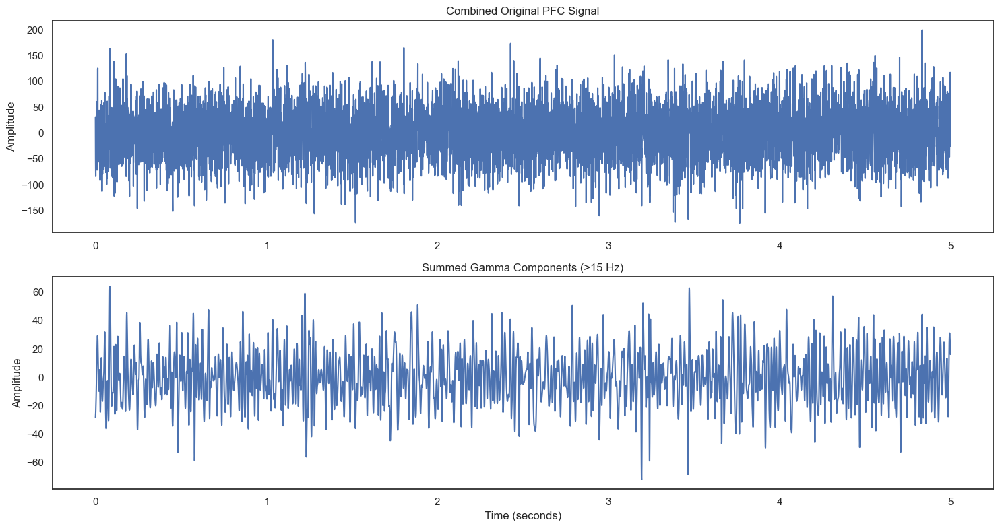


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 33.0 Hz
Gamma (>15Hz)/Total Power Ratio: 0.908


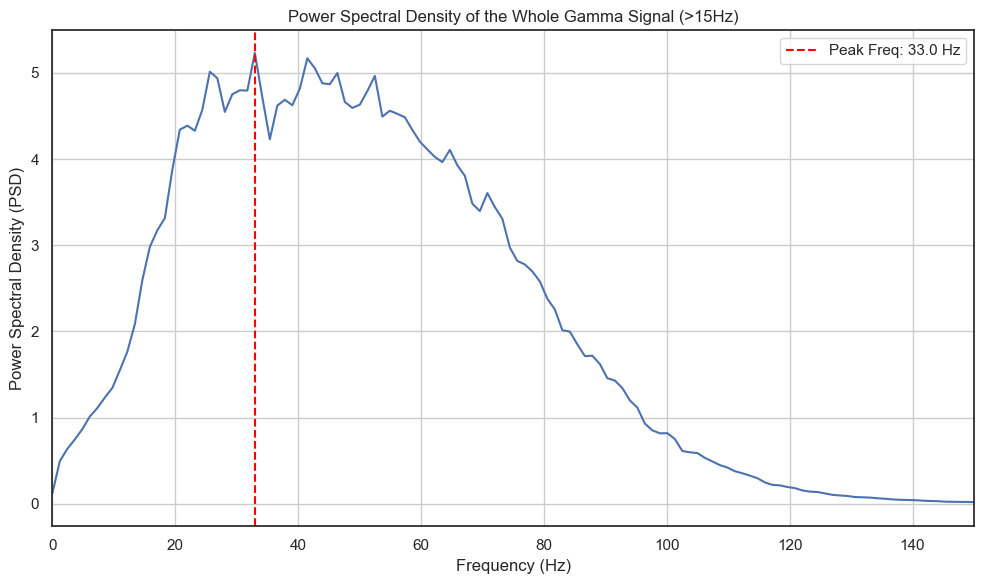

In [67]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA
# ==============================================================================
# Note: You should replace this with your actual data loading
# This placeholder data mimics your variables for a runnable example.

print("SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION")
print("="*60)

fs = 1250.0  # Sample frequency
duration_sec = 300  # Total duration of the LFP signal
lfpPFC = np.random.randn(int(duration_sec * fs)) * 50  # Mock LFP signal

# Create mock tonic and phasic intervals (in seconds)
tonic_intervals = nap.IntervalSet(
    start=np.array([10, 50, 110, 190, 250]),
    end=np.array([25, 75, 130, 220, 265])
)
phasic_intervals = nap.IntervalSet(
    start=np.array([30, 80, 140, 230, 270]),
    end=np.array([45, 95, 165, 245, 290])
)

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. PLOT EMD DECOMPOSITION
# ==============================================================================
print("\nPLOTTING IMF DECOMPOSITION (First 30 seconds)")
print("="*60)

plt.figure(figsize=(14, 10))
# Plot the first 30 seconds (or the full signal if it's shorter)
samples_to_plot = min(int(30 * fs), imfs_whole_signal.shape[0])
emd.plotting.plot_imfs(imfs_whole_signal[:samples_to_plot], cmap=True)
plt.suptitle('EMD Decomposition - Whole Combined PFC Signal (First 30s)')
plt.tight_layout()
plt.show()


# ==============================================================================
# 4. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

for comp_idx in range(imfs_whole_signal.shape[1]):
    comp_freq = IF_whole[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    # CORRECTED: Use 15 Hz as the threshold for gamma
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif 15 <= mean_freq <= 100:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    else:
        classification = "High Frequency"
        
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 5. VISUALIZING THE IMFs TO BE SUMMED
# ==============================================================================
print("\nVISUALIZING COMPONENTS TO BE SUMMED")
print("="*60)

if len(gamma_components_indices) > 0:
    plt.figure(figsize=(15, 10))
    plt.suptitle('Individual IMFs to be Summed (>15 Hz)', fontsize=16)

    # Plot each gamma component in a separate subplot
    for i, comp_idx in enumerate(gamma_components_indices):
        plt.subplot(len(gamma_components_indices), 1, i + 1)
        plt.plot(imfs_whole_signal[:, comp_idx], 'b')
        mean_freq = np.mean(IF_whole[:, comp_idx])
        plt.title(f'IMF-{comp_idx+1} (Mean Freq: {mean_freq:.1f} Hz)', fontsize=10)
        plt.ylabel('Amplitude')
        plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
        plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ==============================================================================
# 6. EXTRACT AND SUM GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(imfs_whole_signal[:, 0])

# Sum all components identified as gamma
for comp_idx in gamma_components_indices:
    gamma_signal_whole += imfs_whole_signal[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 7. VISUALIZE THE FINAL SUMMED GAMMA SIGNAL
# ==============================================================================
print("\nVISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)")
print("="*60)

# Plot the first 5 seconds
samples_5sec = min(int(5 * fs), len(combined_signal))
time_axis = np.arange(samples_5sec) / fs

plt.figure(figsize=(15, 8))

# Plot 1: Original signal
plt.subplot(2, 1, 1)
plt.plot(time_axis, combined_signal[:samples_5sec])
plt.title('Combined Original PFC Signal')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal
plt.subplot(2, 1, 2)
plt.plot(time_axis, gamma_signal_whole[:samples_5sec])
plt.title('Summed Gamma Components (>15 Hz)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 8. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # CORRECTED: Use a gamma mask starting at 15 Hz
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 15) & (freqs <= 100)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma (>15Hz)/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 150])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    # CORRECTED: Update plot title to reflect the >15 Hz threshold
    plt.title('Power Spectral Density of the Whole Gamma Signal (>15Hz)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")


SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION
Total REM intervals: 10
Total REM duration: 195.00 seconds

First few combined intervals:
  index    start    end
      0       10     25
      1       30     45
      2       50     75
      3       80     95
      4      110    130
      5      140    165
      6      190    220
      7      230    245
      8      250    265
      9      270    290
shape: (10, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 10.00s to 25.00s added.
Segment from 30.00s to 45.00s added.
Segment from 50.00s to 75.00s added.
Segment from 80.00s to 95.00s added.
Segment from 110.00s to 130.00s added.
Segment from 140.00s to 165.00s added.
Segment from 190.00s to 220.00s added.
Segment from 230.00s to 245.00s added.
Segment from 250.00s to 265.00s added.
Segment from 270.00s to 290.00s added.

Total length of combined signal: 195.00 seconds

PERFORMING EMD ON THE WHOLE COMBINED SIGNAL
✓ Successfully extracted 8 IMFs from the whole signal.

S

<Figure size 1400x1000 with 0 Axes>

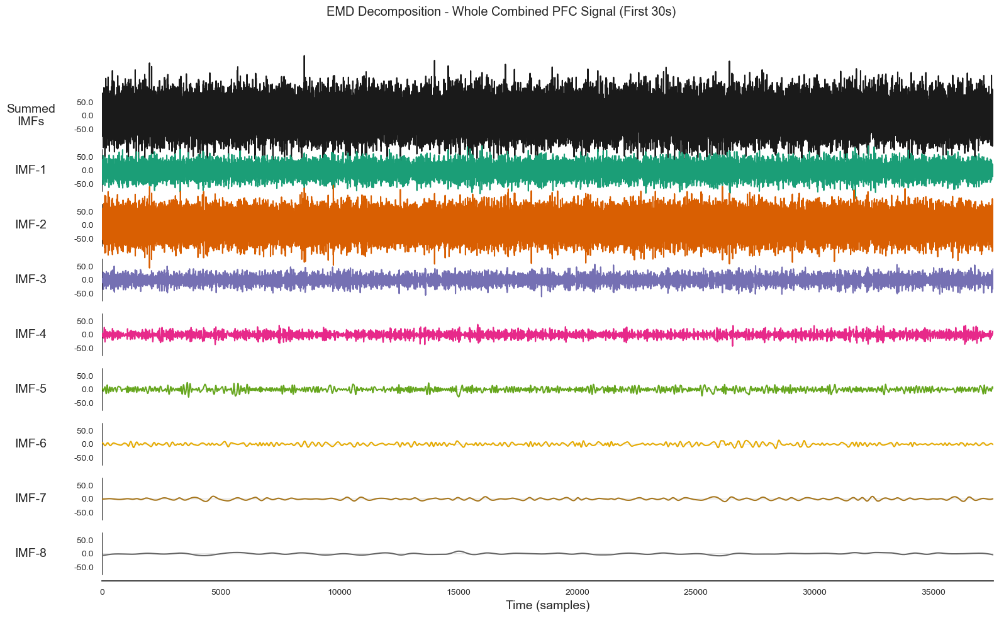


FREQUENCY ANALYSIS - ALL COMPONENTS
IMF-1: 132.4 ± 43.7 Hz → High Frequency
IMF-2: 102.0 ± 83.7 Hz → High Frequency
IMF-3:  67.7 ± 30.0 Hz → GAMMA
IMF-4:  28.5 ± 14.3 Hz → GAMMA
IMF-5:  11.8 ±  6.7 Hz → Alpha/Beta
IMF-6:   4.9 ±  3.0 Hz → Theta
IMF-7:   2.0 ±  1.5 Hz → Delta
IMF-8:   0.5 ±  1.0 Hz → Delta

Gamma components found: ['IMF-3', 'IMF-4']

VISUALIZING COMPONENTS TO BE SUMMED


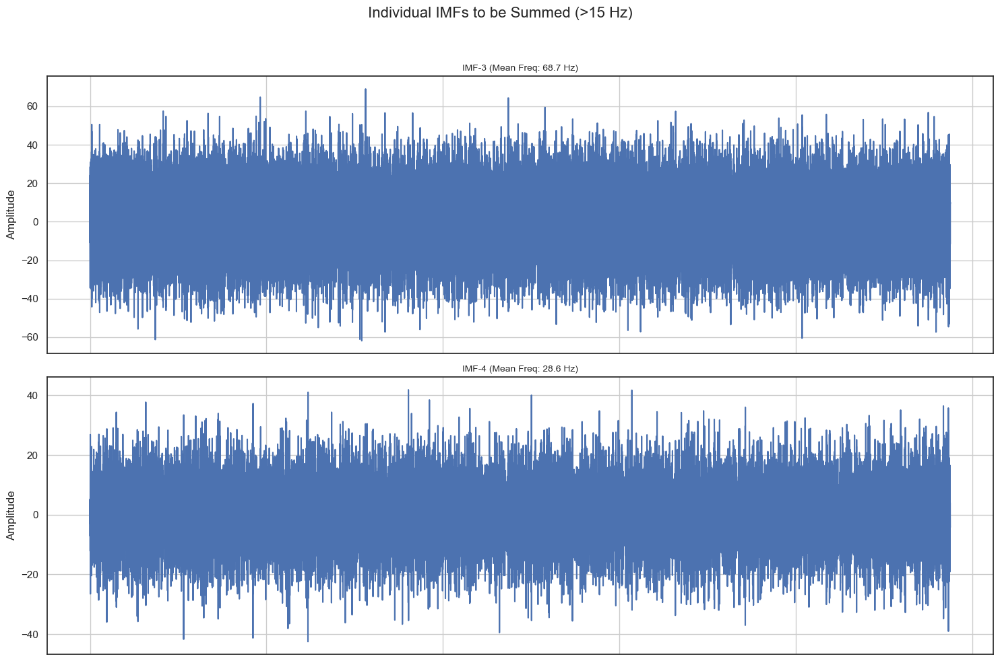


EXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 2 IMFs.

VISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)


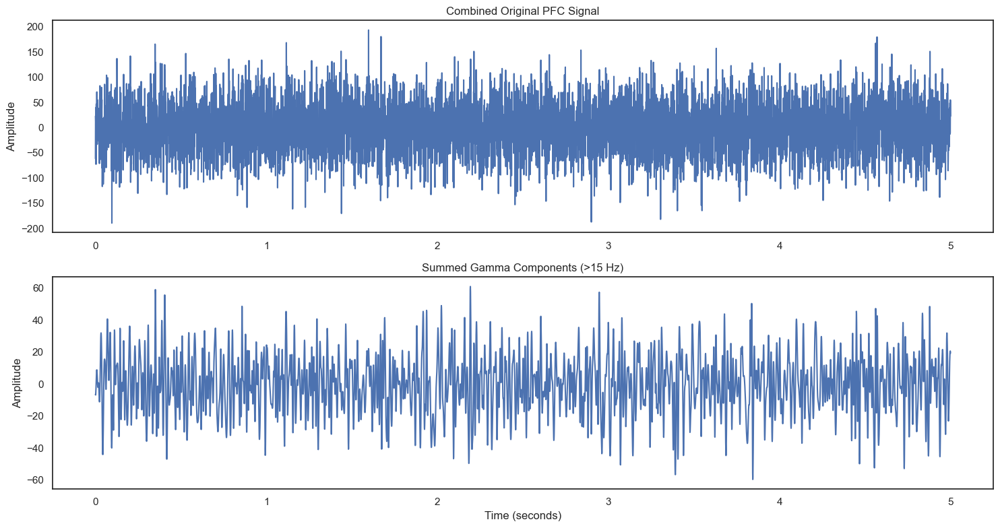


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 35.4 Hz
Gamma (>15Hz)/Total Power Ratio: 0.907


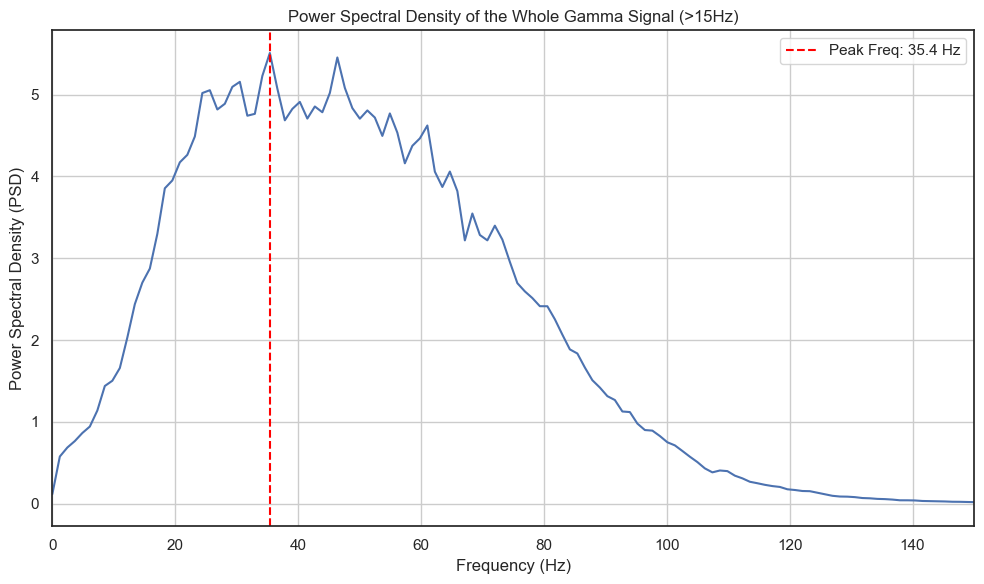

In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA
# ==============================================================================
# Note: You should replace this with your actual data loading
# This placeholder data mimics your variables for a runnable example.

print("SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION")
print("="*60)

fs = 1250.0  # Sample frequency
duration_sec = 300  # Total duration of the LFP signal
lfpPFC = np.random.randn(int(duration_sec * fs)) * 50  # Mock LFP signal

# Create mock tonic and phasic intervals (in seconds)
tonic_intervals = nap.IntervalSet(
    start=np.array([10, 50, 110, 190, 250]),
    end=np.array([25, 75, 130, 220, 265])
)
phasic_intervals = nap.IntervalSet(
    start=np.array([30, 80, 140, 230, 270]),
    end=np.array([45, 95, 165, 245, 290])
)

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. SORT IMFs BY MEAN FREQUENCY (FOR VISUALIZATION)
# ==============================================================================
print("\nSORTING IMFs BY MEAN FREQUENCY")
print("="*60)

# Calculate mean frequency for each IMF
mean_freqs = np.array([np.mean(IF_whole[:, i][IF_whole[:, i] < 200]) for i in range(IF_whole.shape[1])])

# Get the indices that would sort the mean frequencies in descending order
sorted_indices = np.argsort(mean_freqs)[::-1]

# Sort both the IMFs and their instantaneous frequencies for consistent plotting
sorted_imfs = imfs_whole_signal[:, sorted_indices]
sorted_if = IF_whole[:, sorted_indices]

print("✓ IMFs have been sorted for easier visualization and analysis.")


# ==============================================================================
# 4. PLOT EMD DECOMPOSITION
# ==============================================================================
print("\nPLOTTING IMF DECOMPOSITION (First 30 seconds)")
print("="*60)

plt.figure(figsize=(14, 10))
# Plot the first 30 seconds (or the full signal if it's shorter)
samples_to_plot = min(int(30 * fs), sorted_imfs.shape[0])
emd.plotting.plot_imfs(sorted_imfs[:samples_to_plot], cmap=True)
plt.suptitle('EMD Decomposition - Whole Combined PFC Signal (First 30s)')
plt.tight_layout()
plt.show()


# ==============================================================================
# 5. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

# Iterate through the sorted IMFs and their frequencies
for comp_idx in range(sorted_imfs.shape[1]):
    comp_freq = sorted_if[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    # Use 15 Hz as the threshold for gamma
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif 15 <= mean_freq <= 100:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    else:
        classification = "High Frequency"
        
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 6. VISUALIZING THE IMFs TO BE SUMMED
# ==============================================================================
print("\nVISUALIZING COMPONENTS TO BE SUMMED")
print("="*60)

if len(gamma_components_indices) > 0:
    plt.figure(figsize=(15, 10))
    plt.suptitle('Individual IMFs to be Summed (>15 Hz)', fontsize=16)

    # Plot each gamma component in a separate subplot
    for i, comp_idx in enumerate(gamma_components_indices):
        plt.subplot(len(gamma_components_indices), 1, i + 1)
        plt.plot(sorted_imfs[:, comp_idx], 'b')
        mean_freq = np.mean(sorted_if[:, comp_idx])
        plt.title(f'IMF-{comp_idx+1} (Mean Freq: {mean_freq:.1f} Hz)', fontsize=10)
        plt.ylabel('Amplitude')
        plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
        plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ==============================================================================
# 7. EXTRACT AND SUM GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(sorted_imfs[:, 0])

# Sum all components identified as gamma
for comp_idx in gamma_components_indices:
    gamma_signal_whole += sorted_imfs[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 8. VISUALIZE THE FINAL SUMMED GAMMA SIGNAL
# ==============================================================================
print("\nVISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)")
print("="*60)

# Plot the first 5 seconds
samples_5sec = min(int(5 * fs), len(combined_signal))
time_axis = np.arange(samples_5sec) / fs

plt.figure(figsize=(15, 8))

# Plot 1: Original signal
plt.subplot(2, 1, 1)
plt.plot(time_axis, combined_signal[:samples_5sec])
plt.title('Combined Original PFC Signal')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal
plt.subplot(2, 1, 2)
plt.plot(time_axis, gamma_signal_whole[:samples_5sec])
plt.title('Summed Gamma Components (>15 Hz)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 9. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # Use a gamma mask starting at 15 Hz
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 15) & (freqs <= 100)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma (>15Hz)/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 150])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    # Update plot title to reflect the >15 Hz threshold
    plt.title('Power Spectral Density of the Whole Gamma Signal (>15Hz)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")


SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION
Total REM intervals: 10
Total REM duration: 195.00 seconds

First few combined intervals:
  index    start    end
      0       10     25
      1       30     45
      2       50     75
      3       80     95
      4      110    130
      5      140    165
      6      190    220
      7      230    245
      8      250    265
      9      270    290
shape: (10, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 10.00s to 25.00s added.
Segment from 30.00s to 45.00s added.
Segment from 50.00s to 75.00s added.
Segment from 80.00s to 95.00s added.
Segment from 110.00s to 130.00s added.
Segment from 140.00s to 165.00s added.
Segment from 190.00s to 220.00s added.
Segment from 230.00s to 245.00s added.
Segment from 250.00s to 265.00s added.
Segment from 270.00s to 290.00s added.

Total length of combined signal: 195.00 seconds

PERFORMING EMD ON THE WHOLE COMBINED SIGNAL
✓ Successfully extracted 8 IMFs from the whole signal.

S

<Figure size 1400x1000 with 0 Axes>

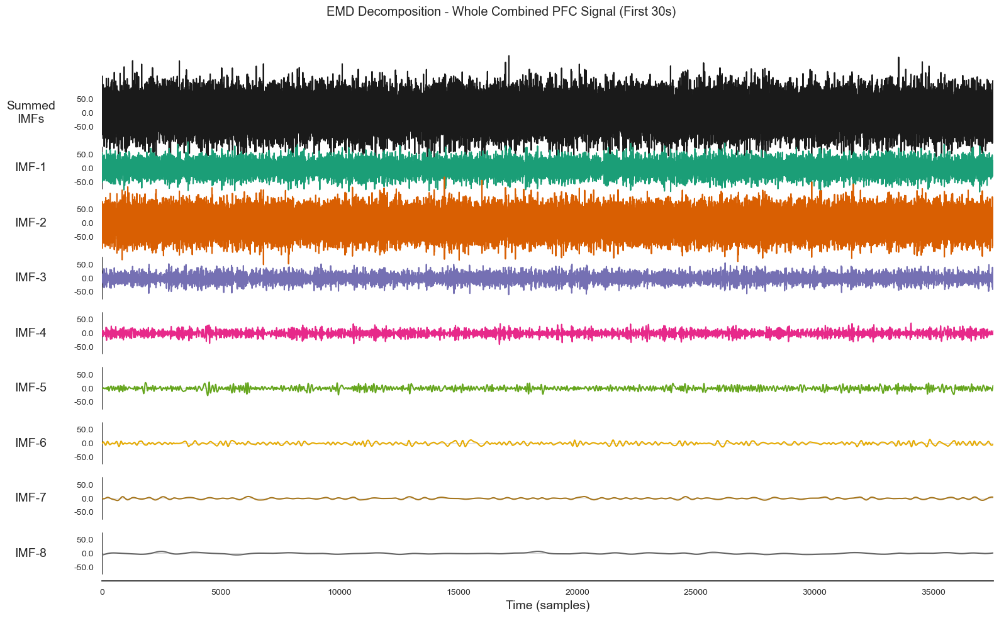


FREQUENCY ANALYSIS - ALL COMPONENTS
IMF-1: 131.8 ± 44.1 Hz → GAMMA
IMF-2: 101.1 ± 85.2 Hz → GAMMA
IMF-3:  67.6 ± 29.8 Hz → GAMMA
IMF-4:  28.2 ± 14.2 Hz → GAMMA
IMF-5:  11.6 ±  6.5 Hz → Alpha/Beta
IMF-6:   4.8 ±  2.8 Hz → Theta
IMF-7:   2.1 ±  1.3 Hz → Delta
IMF-8:   0.5 ±  0.8 Hz → Delta

Gamma components found: ['IMF-1', 'IMF-2', 'IMF-3', 'IMF-4']

VISUALIZING COMPONENTS TO BE SUMMED


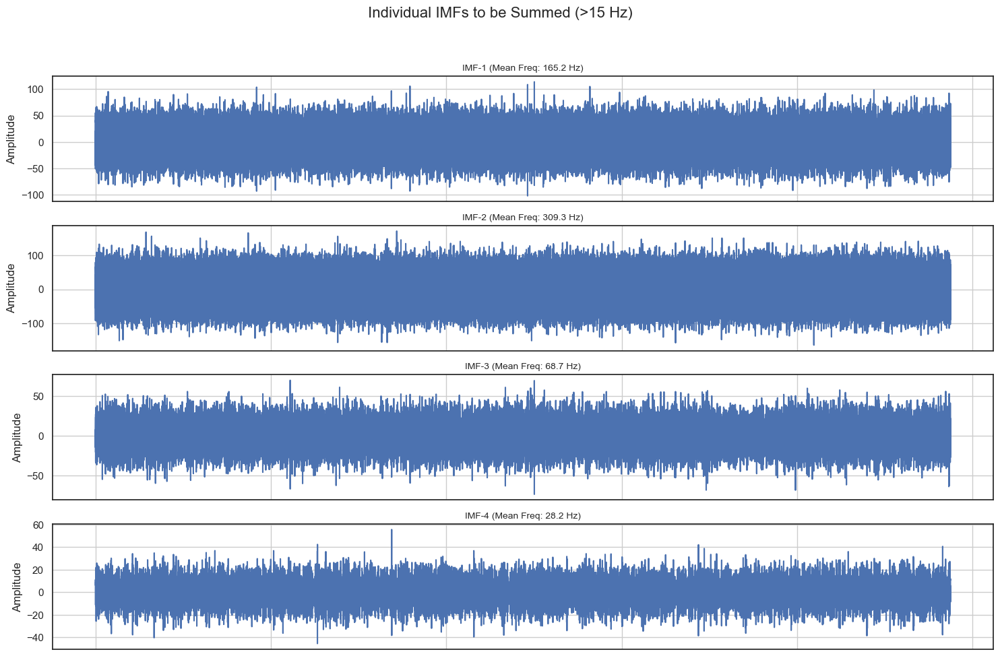


EXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 4 IMFs.

VISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)


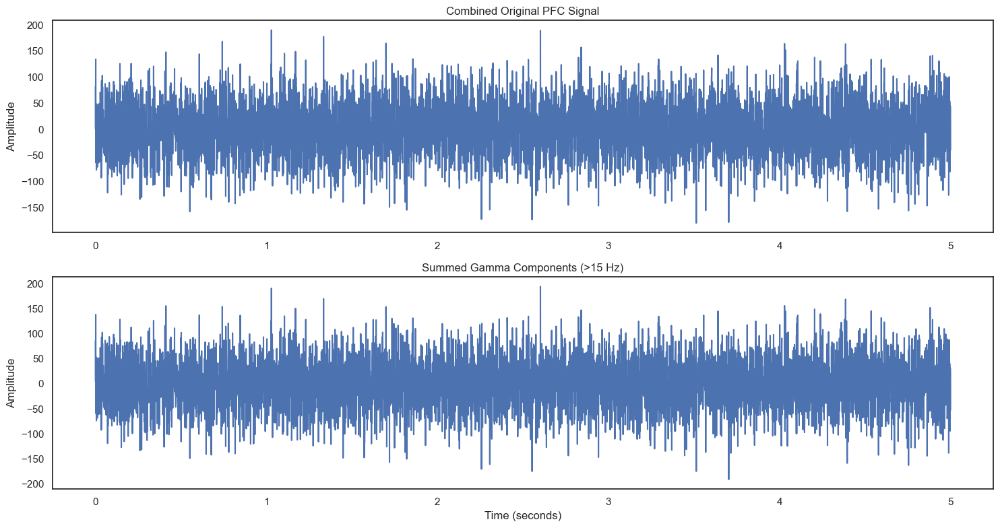


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 356.4 Hz
Gamma (>15Hz)/Total Power Ratio: 0.989


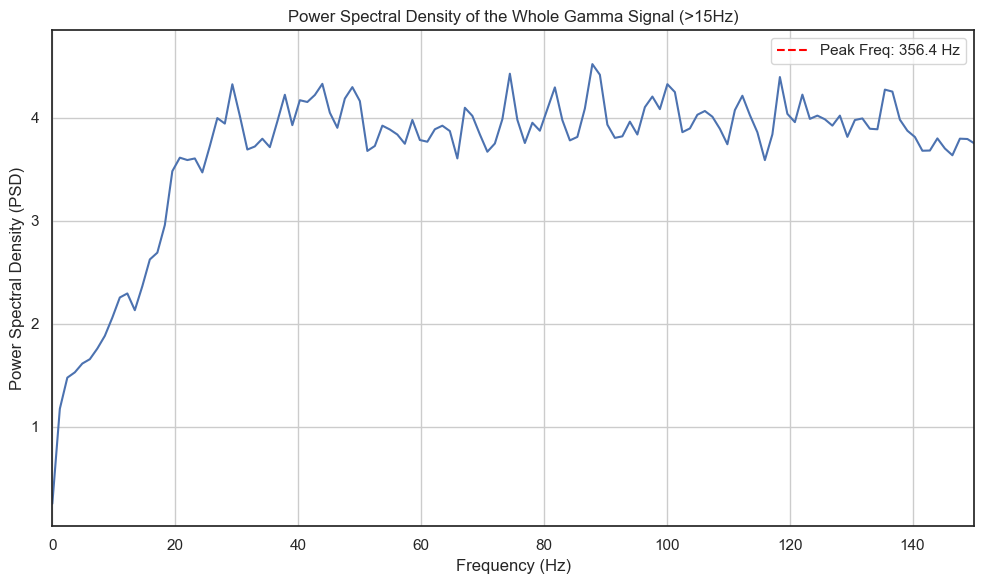

In [69]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA
# ==============================================================================
# Note: You should replace this with your actual data loading
# This placeholder data mimics your variables for a runnable example.

print("SETTING UP PLACEHOLDER DATA FOR DEMONSTRATION")
print("="*60)

fs = 1250.0  # Sample frequency
duration_sec = 300  # Total duration of the LFP signal
lfpPFC = np.random.randn(int(duration_sec * fs)) * 50  # Mock LFP signal

# Create mock tonic and phasic intervals (in seconds)
tonic_intervals = nap.IntervalSet(
    start=np.array([10, 50, 110, 190, 250]),
    end=np.array([25, 75, 130, 220, 265])
)
phasic_intervals = nap.IntervalSet(
    start=np.array([30, 80, 140, 230, 270]),
    end=np.array([45, 95, 165, 245, 290])
)

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. SORT IMFs BY MEAN FREQUENCY (FOR VISUALIZATION)
# ==============================================================================
print("\nSORTING IMFs BY MEAN FREQUENCY")
print("="*60)

# Calculate mean frequency for each IMF
mean_freqs = np.array([np.mean(IF_whole[:, i][IF_whole[:, i] < 200]) for i in range(IF_whole.shape[1])])

# Get the indices that would sort the mean frequencies in descending order
sorted_indices = np.argsort(mean_freqs)[::-1]

# Sort both the IMFs and their instantaneous frequencies for consistent plotting
sorted_imfs = imfs_whole_signal[:, sorted_indices]
sorted_if = IF_whole[:, sorted_indices]

print("✓ IMFs have been sorted for easier visualization and analysis.")


# ==============================================================================
# 4. PLOT EMD DECOMPOSITION
# ==============================================================================
print("\nPLOTTING IMF DECOMPOSITION (First 30 seconds)")
print("="*60)

plt.figure(figsize=(14, 10))
# Plot the first 30 seconds (or the full signal if it's shorter)
samples_to_plot = min(int(30 * fs), sorted_imfs.shape[0])
emd.plotting.plot_imfs(sorted_imfs[:samples_to_plot], cmap=True)
plt.suptitle('EMD Decomposition - Whole Combined PFC Signal (First 30s)')
plt.tight_layout()
plt.show()


# ==============================================================================
# 5. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

# Iterate through the sorted IMFs and their frequencies
for comp_idx in range(sorted_imfs.shape[1]):
    comp_freq = sorted_if[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    # CORRECTED: Use 15 Hz as the threshold for gamma with NO upper limit
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif mean_freq >= 15:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 6. VISUALIZING THE IMFs TO BE SUMMED
# ==============================================================================
print("\nVISUALIZING COMPONENTS TO BE SUMMED")
print("="*60)

if len(gamma_components_indices) > 0:
    plt.figure(figsize=(15, 10))
    plt.suptitle('Individual IMFs to be Summed (>15 Hz)', fontsize=16)

    # Plot each gamma component in a separate subplot
    for i, comp_idx in enumerate(gamma_components_indices):
        plt.subplot(len(gamma_components_indices), 1, i + 1)
        plt.plot(sorted_imfs[:, comp_idx], 'b')
        mean_freq = np.mean(sorted_if[:, comp_idx])
        plt.title(f'IMF-{comp_idx+1} (Mean Freq: {mean_freq:.1f} Hz)', fontsize=10)
        plt.ylabel('Amplitude')
        plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
        plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ==============================================================================
# 7. EXTRACT AND SUM GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(sorted_imfs[:, 0])

# Sum all components identified as gamma
for comp_idx in gamma_components_indices:
    gamma_signal_whole += sorted_imfs[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 8. VISUALIZE THE FINAL SUMMED GAMMA SIGNAL
# ==============================================================================
print("\nVISUALIZING SUMMED GAMMA COMPONENTS (First 5 seconds)")
print("="*60)

# Plot the first 5 seconds
samples_5sec = min(int(5 * fs), len(combined_signal))
time_axis = np.arange(samples_5sec) / fs

plt.figure(figsize=(15, 8))

# Plot 1: Original signal
plt.subplot(2, 1, 1)
plt.plot(time_axis, combined_signal[:samples_5sec])
plt.title('Combined Original PFC Signal')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal
plt.subplot(2, 1, 2)
plt.plot(time_axis, gamma_signal_whole[:samples_5sec])
plt.title('Summed Gamma Components (>15 Hz)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 9. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # Use a gamma mask starting at 15 Hz with no upper limit
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 15)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma (>15Hz)/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 150])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    # Update plot title to reflect the >15 Hz threshold
    plt.title('Power Spectral Density of the Whole Gamma Signal (>15Hz)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")


SETTING UP RANDOMIZED PLACEHOLDER DATA
Target total REM duration: 181.93 seconds
Total REM intervals: 11
Actual total REM duration: 181.93 seconds

First few combined intervals:
  index     start       end
      0    0        24.5981
      1   32.1445   43.3234
      2   51.398    65.0933
      3   73.1479   89.2687
      4   95.9345  111.538
      5  117.34    132.52
      6  138.308   155.442
      7  164.134   191.828
      8  200.187   221.102
      9  225.429   234.816
     10  244.028   254.455
shape: (11, 2), time unit: sec.

COMBINING ALL REM SIGNAL SEGMENTS
Segment from 0.00s to 24.60s added.
Segment from 32.14s to 43.32s added.
Segment from 51.40s to 65.09s added.
Segment from 73.15s to 89.27s added.
Segment from 95.93s to 111.54s added.
Segment from 117.34s to 132.52s added.
Segment from 138.31s to 155.44s added.
Segment from 164.13s to 191.83s added.
Segment from 200.19s to 221.10s added.
Segment from 225.43s to 234.82s added.
Segment from 244.03s to 254.46s added.

Total l

<Figure size 1400x1000 with 0 Axes>

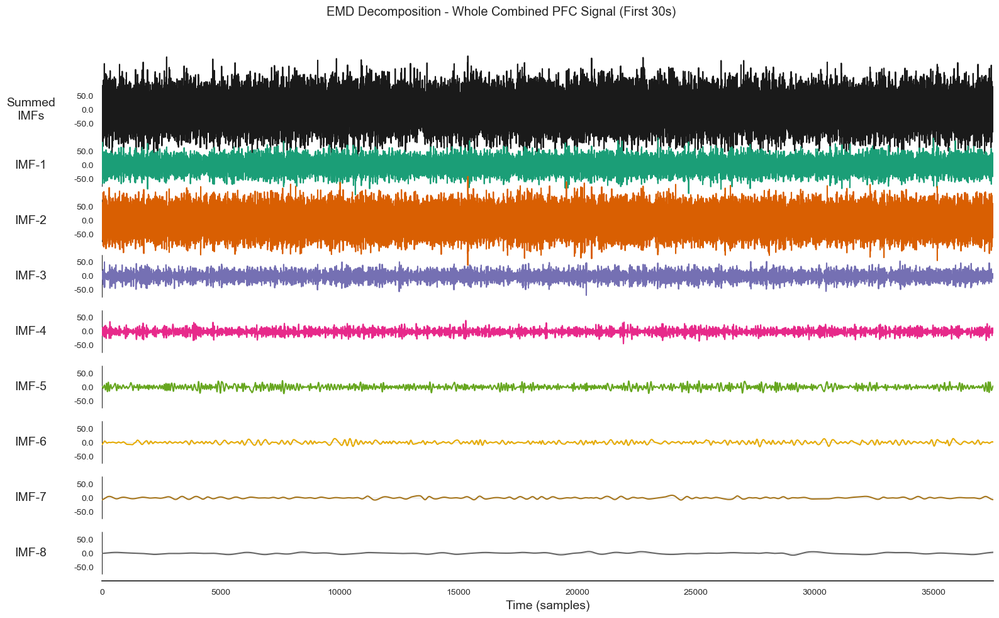


FREQUENCY ANALYSIS - ALL COMPONENTS
IMF-1: 132.6 ± 43.6 Hz → GAMMA
IMF-2: 101.1 ± 85.6 Hz → GAMMA
IMF-3:  68.1 ± 29.6 Hz → GAMMA
IMF-4:  28.6 ± 14.2 Hz → GAMMA
IMF-5:  12.0 ±  6.7 Hz → Alpha/Beta
IMF-6:   5.0 ±  3.1 Hz → Theta
IMF-7:   2.1 ±  1.3 Hz → Delta
IMF-8:   0.5 ±  0.7 Hz → Delta

Gamma components found: ['IMF-1', 'IMF-2', 'IMF-3', 'IMF-4']

VISUALIZING COMPONENTS TO BE SUMMED


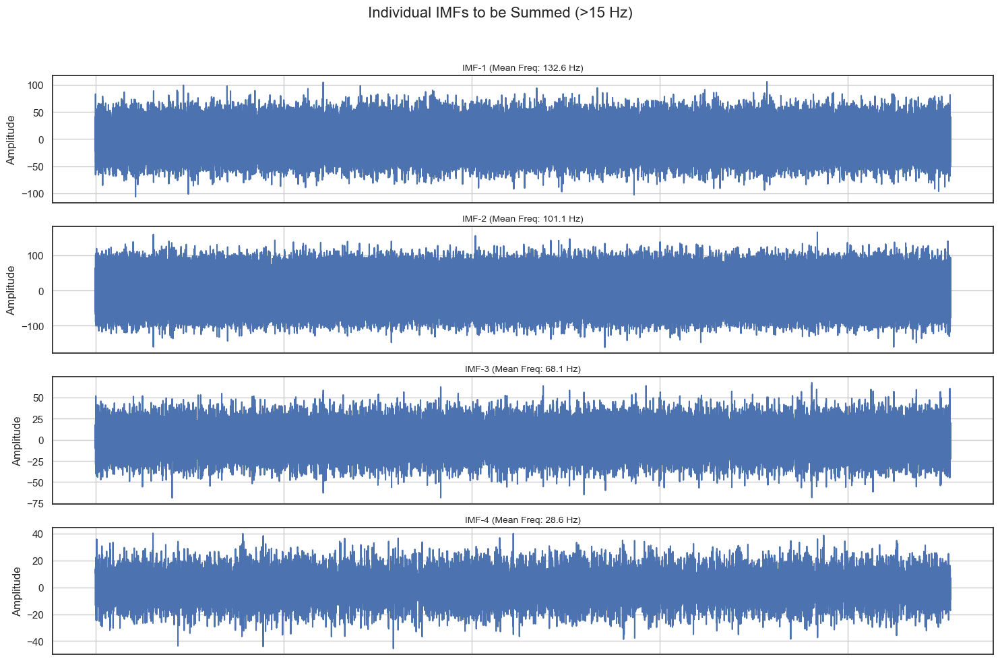


EXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL
Successfully created a combined gamma signal from 4 IMFs.

VISUALIZING SUMMED GAMMA COMPONENTS (1s and 40s)


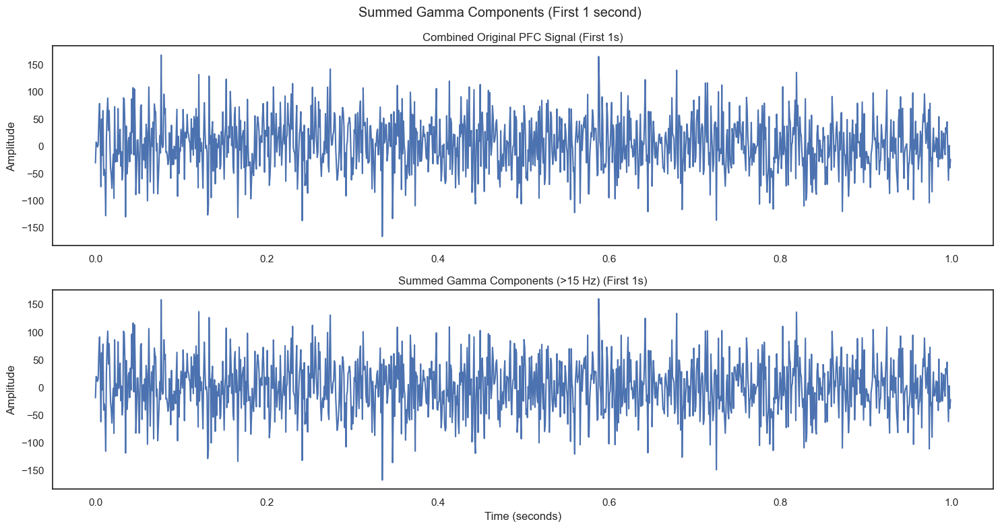

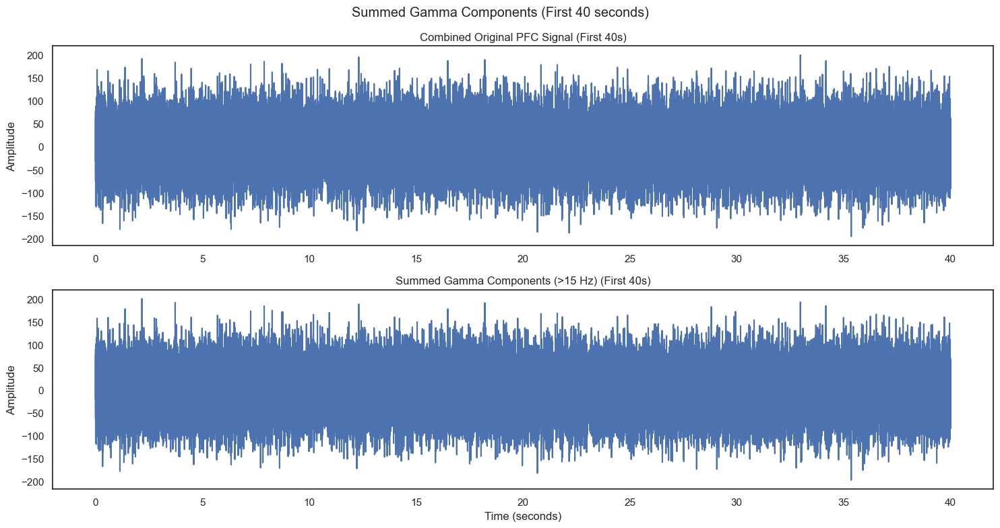


SPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL

SUMMARY FOR WHOLE SIGNAL:
Peak frequency: 236.8 Hz
Gamma (>15Hz)/Total Power Ratio: 0.989


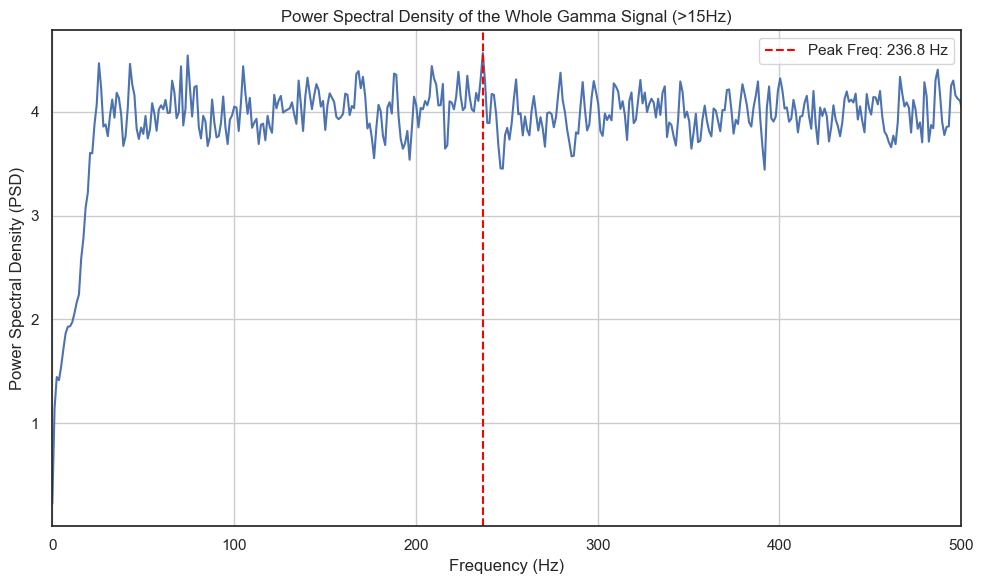

In [77]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import emd
import scipy.signal
import pynapple as nap

# ==============================================================================
# 0. SETUP AND PLACEHOLDER DATA (WITH RANDOMIZED PARAMETERS)
# ==============================================================================
print("SETTING UP RANDOMIZED PLACEHOLDER DATA")
print("="*60)

fs = 1250.0  # Sample frequency
total_experiment_duration = 300  # Total duration of the simulated LFP recording
lfpPFC = np.random.randn(int(total_experiment_duration * fs)) * 50  # Mock LFP signal

# Generate a random total duration for the combined signal (between 180 and 220s)
target_rem_duration = np.random.uniform(180, 220)
print(f"Target total REM duration: {target_rem_duration:.2f} seconds")

# Generate random segments until the target duration is met
current_duration = 0
tonic_starts, tonic_ends = [], []
phasic_starts, phasic_ends = [], []

# Generate a list of non-overlapping intervals that sum to the target duration
current_start = 0
while current_duration < target_rem_duration:
    # Randomly choose a segment length (e.g., between 5 and 30 seconds)
    segment_duration = np.random.uniform(5, 30)
    
    # Ensure the last segment doesn't overshoot the target
    if current_duration + segment_duration > target_rem_duration:
        segment_duration = target_rem_duration - current_duration
        if segment_duration <= 0:
            break
            
    # Randomly assign segment to tonic or phasic
    is_tonic = np.random.choice([True, False])
    
    if is_tonic:
        tonic_starts.append(current_start)
        tonic_ends.append(current_start + segment_duration)
    else:
        phasic_starts.append(current_start)
        phasic_ends.append(current_start + segment_duration)
        
    current_duration += segment_duration
    
    # Add a random gap between intervals (e.g., 2 to 10 seconds)
    gap = np.random.uniform(2, 10)
    current_start += segment_duration + gap
    
    # Stop if we are running out of space in the total experiment duration
    if current_start > total_experiment_duration:
        break

# Create pynapple IntervalSets from the generated segments
tonic_intervals = nap.IntervalSet(start=np.array(tonic_starts), end=np.array(tonic_ends))
phasic_intervals = nap.IntervalSet(start=np.array(phasic_starts), end=np.array(phasic_ends))

# Use pynapple's union method to combine intervals correctly
all_rem_intervals = tonic_intervals.union(phasic_intervals)

print(f"Total REM intervals: {len(all_rem_intervals)}")
print(f"Actual total REM duration: {np.sum(all_rem_intervals['end'] - all_rem_intervals['start']):.2f} seconds")
print("\nFirst few combined intervals:")
print(all_rem_intervals)


# ==============================================================================
# 1. COMBINE ALL REM SEGMENTS INTO A SINGLE SIGNAL
# ==============================================================================
print("\nCOMBINING ALL REM SIGNAL SEGMENTS")
print("="*60)

combined_signal = []

# FIX: Use .as_dataframe() to correctly iterate over the pynapple IntervalSet
for interval_idx, interval in all_rem_intervals.as_dataframe().iterrows():
    start_idx = int(interval['start'] * fs)
    end_idx = int(interval['end'] * fs)
    sig_segment = lfpPFC[start_idx:end_idx]
    combined_signal.extend(sig_segment)
    print(f"Segment from {interval['start']:.2f}s to {interval['end']:.2f}s added.")

combined_signal = np.array(combined_signal)

print(f"\nTotal length of combined signal: {len(combined_signal) / fs:.2f} seconds")


# ==============================================================================
# 2. PERFORM EMD ON THE WHOLE CONCATENATED SIGNAL
# ==============================================================================
print("\nPERFORMING EMD ON THE WHOLE COMBINED SIGNAL")
print("="*60)

try:
    # Perform EMD with default settings on the entire concatenated signal
    imfs_whole_signal = emd.sift.sift(combined_signal, imf_opts={'sd_thresh': 0.1})
    
    # Calculate instantaneous frequency/amplitude
    IP_whole, IF_whole, IA_whole = emd.spectra.frequency_transform(
        imfs_whole_signal, sample_rate=fs, method='hilbert')
        
    print(f"✓ Successfully extracted {imfs_whole_signal.shape[1]} IMFs from the whole signal.")
    
except Exception as e:
    print(f"✗ Error during EMD: {e}")


# ==============================================================================
# 3. SORT IMFs BY MEAN FREQUENCY (FOR VISUALIZATION)
# ==============================================================================
print("\nSORTING IMFs BY MEAN FREQUENCY")
print("="*60)

# Calculate mean frequency for each IMF, filtering out outliers above 200 Hz
mean_freqs = np.array([np.mean(IF_whole[:, i][IF_whole[:, i] < 200]) for i in range(IF_whole.shape[1])])

# Get the indices that would sort the mean frequencies in descending order
sorted_indices = np.argsort(mean_freqs)[::-1]

# Sort both the IMFs and their instantaneous frequencies for consistent plotting
sorted_imfs = imfs_whole_signal[:, sorted_indices]
sorted_if = IF_whole[:, sorted_indices]

print("✓ IMFs have been sorted for easier visualization and analysis.")


# ==============================================================================
# 4. PLOT EMD DECOMPOSITION
# ==============================================================================
print("\nPLOTTING IMF DECOMPOSITION (First 30 seconds)")
print("="*60)

plt.figure(figsize=(14, 10))
# Plot the first 30 seconds (or the full signal if it's shorter)
samples_to_plot = min(int(30 * fs), sorted_imfs.shape[0])
emd.plotting.plot_imfs(sorted_imfs[:samples_to_plot], cmap=True)
plt.suptitle('EMD Decomposition - Whole Combined PFC Signal (First 30s)')
plt.tight_layout()
plt.show()


# ==============================================================================
# 5. ANALYZE FREQUENCY CHARACTERISTICS
# ==============================================================================
print("\nFREQUENCY ANALYSIS - ALL COMPONENTS")
print("="*60)

gamma_components_indices = []

# Iterate through the sorted IMFs and their frequencies
for comp_idx in range(sorted_imfs.shape[1]):
    comp_freq = sorted_if[:, comp_idx]
    # Remove outliers
    valid_mask = comp_freq < 200
    if np.sum(valid_mask) > 0:
        mean_freq = np.mean(comp_freq[valid_mask])
        std_freq = np.std(comp_freq[valid_mask])
    else:
        mean_freq = 0
        std_freq = 0
        
    # Classify component
    classification = ""
    # Use 15 Hz as the threshold for gamma with NO upper limit
    if mean_freq < 4:
        classification = "Delta"
    elif 4 <= mean_freq < 8:
        classification = "Theta"
    elif 8 <= mean_freq < 15:
        classification = "Alpha/Beta"
    elif mean_freq >= 15:
        classification = "GAMMA"
        gamma_components_indices.append(comp_idx)
    
    print(f"IMF-{comp_idx+1}: {mean_freq:5.1f} ± {std_freq:4.1f} Hz → {classification}")
    
print(f"\nGamma components found: {[f'IMF-{i+1}' for i in gamma_components_indices]}")


# ==============================================================================
# 6. VISUALIZING THE IMFs TO BE SUMMED
# ==============================================================================
print("\nVISUALIZING COMPONENTS TO BE SUMMED")
print("="*60)

if len(gamma_components_indices) > 0:
    plt.figure(figsize=(15, 10))
    plt.suptitle('Individual IMFs to be Summed (>15 Hz)', fontsize=16)

    # Plot each gamma component in a separate subplot
    for i, comp_idx in enumerate(gamma_components_indices):
        plt.subplot(len(gamma_components_indices), 1, i + 1)
        plt.plot(sorted_imfs[:, comp_idx], 'b')
        # Use the pre-calculated, filtered mean frequency for the title
        mean_freq_from_list = mean_freqs[sorted_indices[comp_idx]]
        plt.title(f'IMF-{comp_idx+1} (Mean Freq: {mean_freq_from_list:.1f} Hz)', fontsize=10)
        plt.ylabel('Amplitude')
        plt.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
        plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# ==============================================================================
# 7. EXTRACT AND SUM GAMMA COMPONENTS
# ==============================================================================
print("\nEXTRACTING AND SUMMING GAMMA COMPONENTS FROM WHOLE SIGNAL")
print("="*60)

gamma_signal_whole = np.zeros_like(sorted_imfs[:, 0])

# Sum all components identified as gamma
for comp_idx in gamma_components_indices:
    gamma_signal_whole += sorted_imfs[:, comp_idx]

print(f"Successfully created a combined gamma signal from {len(gamma_components_indices)} IMFs.")


# ==============================================================================
# 8. VISUALIZE THE FINAL SUMMED GAMMA SIGNAL
# ==============================================================================
print("\nVISUALIZING SUMMED GAMMA COMPONENTS (1s and 40s)")
print("="*60)

# Plot the first 1 second
samples_1sec = min(int(1 * fs), len(combined_signal))
time_axis_1sec = np.arange(samples_1sec) / fs

plt.figure(figsize=(15, 8))
plt.suptitle('Summed Gamma Components (First 1 second)')

# Plot 1: Original signal (1s)
plt.subplot(2, 1, 1)
plt.plot(time_axis_1sec, combined_signal[:samples_1sec])
plt.title('Combined Original PFC Signal (First 1s)')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal (1s)
plt.subplot(2, 1, 2)
plt.plot(time_axis_1sec, gamma_signal_whole[:samples_1sec])
plt.title('Summed Gamma Components (>15 Hz) (First 1s)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()

# Plot the first 40 seconds
samples_40sec = min(int(40 * fs), len(combined_signal))
time_axis_40sec = np.arange(samples_40sec) / fs

plt.figure(figsize=(15, 8))
plt.suptitle('Summed Gamma Components (First 40 seconds)')

# Plot 1: Original signal (40s)
plt.subplot(2, 1, 1)
plt.plot(time_axis_40sec, combined_signal[:samples_40sec])
plt.title('Combined Original PFC Signal (First 40s)')
plt.ylabel('Amplitude')

# Plot 2: Summed gamma signal (40s)
plt.subplot(2, 1, 2)
plt.plot(time_axis_40sec, gamma_signal_whole[:samples_40sec])
plt.title('Summed Gamma Components (>15 Hz) (First 40s)')
plt.ylabel('Amplitude')
plt.xlabel('Time (seconds)')

plt.tight_layout()
plt.show()


# ==============================================================================
# 9. SPECTRAL ANALYSIS OF THE WHOLE GAMMA SIGNAL
# ==============================================================================
print("\nSPECTRAL ANALYSIS OF WHOLE GAMMA SIGNAL")
print("="*60)

if len(gamma_signal_whole) > 100:
    # Compute PSD
    freqs, psd = scipy.signal.welch(gamma_signal_whole, fs=fs, nperseg=min(1024, len(gamma_signal_whole)//4))
    
    # Use a gamma mask starting at 15 Hz with no upper limit
    total_power = np.sum(psd)
    gamma_mask = (freqs >= 15)
    gamma_power = np.sum(psd[gamma_mask]) if np.any(gamma_mask) else 0
    gamma_ratio = gamma_power / total_power if total_power > 0 else 0
    
    # Find peak frequency
    peak_freq = freqs[np.argmax(psd)] if len(psd) > 0 else 0
    
    print(f"\nSUMMARY FOR WHOLE SIGNAL:")
    print(f"Peak frequency: {peak_freq:.1f} Hz")
    print(f"Gamma (>15Hz)/Total Power Ratio: {gamma_ratio:.3f}")

    # Plot the PSD
    plt.figure(figsize=(10, 6))
    plt.plot(freqs, psd)
    plt.xlim([0, 500])
    plt.axvline(peak_freq, color='red', linestyle='--', label=f'Peak Freq: {peak_freq:.1f} Hz')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power Spectral Density (PSD)')
    # Update plot title to reflect the >15 Hz threshold
    plt.title('Power Spectral Density of the Whole Gamma Signal (>15Hz)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
else:
    print("Combined gamma signal is too short for spectral analysis.")
